# Semi-Supervised Medical Image Segmentation Framework
- Developed an innovative semi-supervised learning framework merging Convolutional Neural Networks (CNN) and Transformers to enhance medical image segmentation accuracy via feature representation learning.
- Successfully combined the strengths of both architectures, capturing local and long-range information for improved segmentation performance.
- Demonstrated substantial improvement in segmentation accuracy, achieving a Dice score of 0.889 and an IOU score of 0.825 during validation.


## A. Imports, Setup and Installations



In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import sys
sys.path.append('/content/drive/MyDrive/colab_stuff')

In [ ]:
## Install Required Libraries
!pip install -q "monai-weekly[nibabel, tqdm]"
!pip install -q torchio scipy
!pip install -q segmentation-models-pytorch tensorboardX yacs einops batchgenerators medpy

In [ ]:
## Import Necessary Libraries
import os
import numpy as np
import nibabel
import matplotlib.pyplot as plt
from ipywidgets import interact
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import torch
from torch import nn
from torch import optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import torchvision.utils as vutils
import torchio as tio

import argparse
import logging
import os
import random
import shutil
import sys
import time
import math

import numpy as np
import torch
import torch.backends.cudnn as cudnn
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.nn.modules.loss import CrossEntropyLoss
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader, SubsetRandomSampler
from torchvision import transforms
from torch.optim.lr_scheduler import ReduceLROnPlateau, ExponentialLR, StepLR, CosineAnnealingLR
from tqdm import tqdm

from scipy.ndimage import zoom, rotate, gaussian_filter
from scipy.ndimage.interpolation import map_coordinates

#from monai.data import CacheDataset, DataLoader, Dataset, decollate_batch
from monai.data import DataLoader, decollate_batch, list_data_collate
from monai.handlers.utils import from_engine
from monai.losses import DiceLoss, DiceCELoss
from monai.inferers import sliding_window_inference
from monai.metrics import DiceMetric, MeanIoU
from monai.utils import first, set_determinism

from dataloaders import utils
from dataloaders.dataset import (BaseDataSets, RandomGenerator,
                                  TwoStreamBatchSampler)

<ipython-input-4-335d7e7574ed>:40: DeprecationWarning: Please use `map_coordinates` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  from scipy.ndimage.interpolation import map_coordinates


=> merge config from /content/drive/MyDrive/colab_stuff/configs/swin_tiny_patch4_window7_224_lite.yaml


### Setting Seed to Replicate Results

In [ ]:
set_determinism(seed=0)

## B. Exploratory Data Analysis

In [ ]:
def find_intensity_range(image_paths, max_image_count):
    """
    Finds the minimum and maximum pixel intensity values across all provided images.

    Parameters:
        image_paths (list): List of paths to the images.

    Returns:
        min_intensity (float): Minimum pixel intensity across all images.
        max_intensity (float): Maximum pixel intensity across all images.
    """
    min_intensity = float('inf')
    max_intensity = float('-inf')

    for count, image_path in enumerate(image_paths):
        if count < max_image_count:
          img = nibabel.load(image_path)
          img_data = img.get_fdata()

          min_val = img_data.min()
          max_val = img_data.max()

          #print("Min - ", min_val, ", Max - ", max_val)

          if min_val < min_intensity:
              min_intensity = min_val

          if max_val > max_intensity:
              max_intensity = max_val

    return min_intensity, max_intensity

def get_image_shapes(image_paths, max_image_count=None):
    """
    Get the shapes of the provided images.

    Parameters:
        image_paths (list): List of paths to the images.
        max_image_count (int, optional): Maximum number of images to consider. If None, consider all.

    Returns:
        shapes (list): List of shapes of the images.
    """
    shapes = []

    for count, image_path in enumerate(image_paths):
        if max_image_count and count >= max_image_count:
            break

        img = nibabel.load(image_path)
        img_data = img.get_fdata()
        shapes.append(img_data.shape)

    return shapes

def construct_full_paths(data_path, name_list):
    """
    Construct the full paths for the images and their corresponding labels based on the name list.

    Parameters:
        data_path (str): Base directory containing the image data.
        name_list (list): List of image names.

    Returns:
        Tuple of lists: first list contains full paths to the images, second list contains full paths to the labels.
    """
    image_paths = []
    label_paths = []

    for name in name_list:
        patient_folder = name.split('_')[0]  # Assuming the naming convention from previous code

        image_path = os.path.join(data_path, patient_folder, name + ".nii.gz")
        label_path = os.path.join(data_path, patient_folder, name + "_gt.nii.gz")

        # Check if both image and label exist before appending
        if os.path.exists(image_path) and os.path.exists(label_path):
            image_paths.append(image_path)
            label_paths.append(label_path)

    return image_paths, label_paths

## Training and validation data are in the same training directory
train_data_path = '/content/drive/MyDrive/colab_stuff/training'
train_list_file = '/content/drive/MyDrive/colab_stuff/train.list'
val_list_file = '/content/drive/MyDrive/colab_stuff/val.list'

with open(train_list_file, 'r') as file:
    train_lst = [line.strip() for line in file]
with open(val_list_file, 'r') as file:
    val_lst = [line.strip() for line in file]

train_image_paths, train_label_paths = construct_full_paths(train_data_path, train_lst)
val_image_paths, val_label_paths = construct_full_paths(train_data_path, val_lst)

In [ ]:
print(f"Number of train patients -{len(train_image_paths)}\nNumber of validation patients - {len(val_image_paths)}")

# Calculate the range for training images
train_min, train_max = find_intensity_range(train_image_paths, 40)
print(f"Training pixel intensity range: {train_min} - {train_max}")

# Calculate the range for validation images
val_min, val_max = find_intensity_range(val_image_paths, 10)
print(f"Validation pixel intensity range: {val_min} - {val_max}")

# If you want the overall range for both training and validation:
overall_min = min(train_min, val_min)
overall_max = max(train_max, val_max)
print(f"Overall intensity range: {overall_min} - {overall_max}")

Number of train patients -62
Number of validation patients - 10
Training pixel intensity range: 0.0 - 4025.0
Validation pixel intensity range: 0.0 - 646.0
Overall intensity range: 0.0 - 4025.0


In [ ]:
train_shapes = get_image_shapes(train_image_paths, max_image_count=40)
min_shape = [min([shape[i] for shape in train_shapes]) for i in range(3)]
print(train_shapes)
print("Min shape", min_shape)

[(154, 224, 16), (276, 384, 8), (248, 256, 10), (216, 304, 8), (216, 256, 9), (240, 256, 10), (256, 216, 7), (208, 256, 8), (216, 256, 8), (208, 256, 10), (216, 256, 9), (264, 288, 6), (232, 256, 10), (216, 256, 9), (216, 256, 7), (174, 208, 18), (216, 256, 10), (216, 256, 8), (208, 174, 10), (256, 208, 9), (256, 216, 9), (216, 256, 8), (256, 256, 8), (174, 224, 12), (154, 224, 6), (256, 176, 8), (216, 256, 7), (180, 224, 14), (216, 256, 8), (216, 256, 10), (224, 154, 16), (240, 256, 10), (216, 256, 7), (232, 256, 11), (192, 256, 10), (208, 256, 7), (216, 256, 9), (216, 256, 9), (256, 256, 9), (208, 256, 10)]
Min shape [154, 154, 6]


### Plot Pixel Intensity Distribution

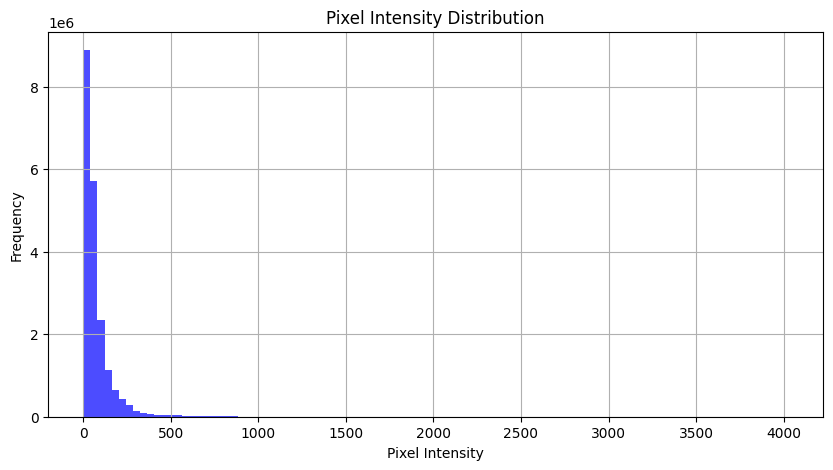

In [ ]:
def plot_histogram(image_paths, max_image_count):
    """Plot a histogram of pixel intensities for the given image paths."""

    intensities = []

    for count, image_path in enumerate(image_paths):
        if count < max_image_count:
            img = nibabel.load(image_path)
            img_data = img.get_fdata().ravel()  # ravel() flattens the data
            intensities.extend(img_data)

    # Plot histogram
    plt.figure(figsize=(10, 5))
    plt.hist(intensities, bins=100, color='blue', alpha=0.7)
    plt.title('Pixel Intensity Distribution')
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

# Plot histogram for training images
plot_histogram(train_image_paths, 40)

### Plot Class Distribution

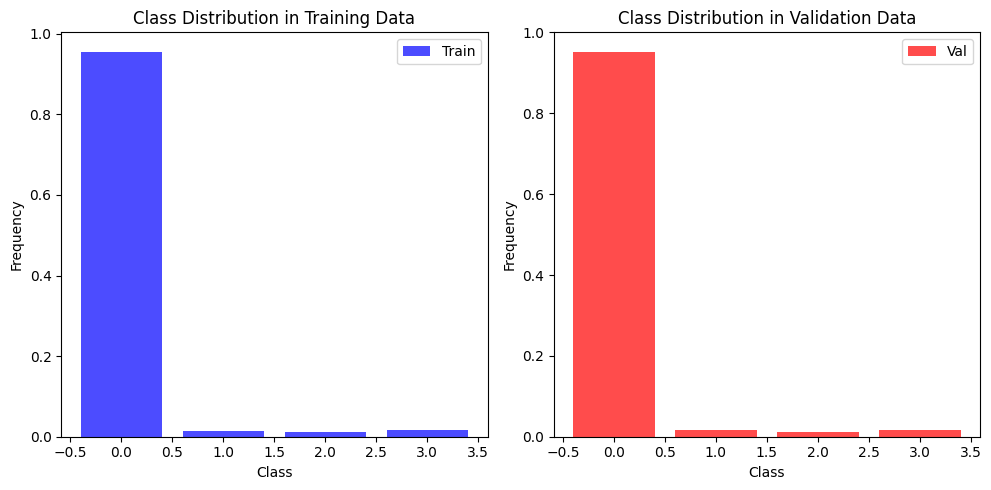

In [ ]:
def get_class_distribution(dataset):
    """Extract the class distribution from a dataset."""
    all_labels = []

    for image in dataset:
        # Load the label volume using nibabel
        label_vol = nibabel.load(image).get_fdata()

        # Convert the volume to a torch tensor and flatten it
        all_labels.append(torch.tensor(label_vol, dtype=torch.int64).flatten())  # Change dtype to int64

    # Concatenate all the flattened labels to a single tensor
    all_labels = torch.cat(all_labels)

    # Use bincount to get the class distribution
    class_counts = torch.bincount(all_labels).float()
    class_frequencies = class_counts / class_counts.sum()

    return class_frequencies

# Calculate class distributions
train_class_dist = get_class_distribution(train_label_paths)
val_class_dist = get_class_distribution(val_label_paths)

def plot_class_distribution(train_dist, val_dist):
    """Plot the class distributions of the training and validation data."""
    classes = list(range(len(train_dist)))

    plt.figure(figsize=(10, 5)) # Set the overall figure size

    # Plot for training data
    plt.subplot(1, 2, 1)
    plt.bar(classes, train_dist, alpha=0.7, color='b', label='Train')
    plt.xlabel('Class')
    plt.ylabel('Frequency')
    plt.title('Class Distribution in Training Data')
    plt.legend()

    # Plot for validation data
    plt.subplot(1, 2, 2)
    plt.bar(classes, val_dist, alpha=0.7, color='r', label='Val')
    plt.xlabel('Class')
    plt.ylabel('Frequency')
    plt.title('Class Distribution in Validation Data')
    plt.legend()

    plt.tight_layout()
    plt.show()

# Plot
plot_class_distribution(train_class_dist, val_class_dist)

## C. Dataset, Dataloader and Transformations

In [ ]:
class CardiacMRI_Dataset(Dataset):
    def __init__(self, data_path, file_lst, transform=None):
        self.data_path = data_path
        self.file_lst = file_lst
        self.transform = transform

        self.imgs_train = []
        self.masks_train = []

        for root, dirs, files in os.walk(self.data_path):
            for name in files:
                if name.split('.')[0] in self.file_lst:
                    training_mask = nibabel.load(os.path.join(root, name.split('.')[0]+'_gt.nii.gz'))
                    training_image = nibabel.load(os.path.join(root, name))

                    for k in range(training_mask.shape[2]):
                        mask_2d = np.array(training_mask.get_fdata()[::, ::, k])
                        image_2d = np.array(training_image.get_fdata()[::, ::, k])

                        if len(np.unique(mask_2d)) != 1:
                            self.masks_train.append(mask_2d)
                            self.imgs_train.append(image_2d)

    def __getitem__(self, index):
        img = self.imgs_train[index].astype(np.float32)
        mask = self.masks_train[index].astype(np.float32)

        if self.transform is not None:
            img, mask = self.transform((img, mask))

        return img, mask

    def __len__(self):
        return len(self.imgs_train)

class RandomRotation:
    def __init__(self, angle=10):
        self.angle = angle

    def __call__(self, sample):
        image, label = sample
        if np.random.rand() > 0.5:
            angle = np.random.uniform(-self.angle, self.angle)
            image = rotate(image, angle, reshape=False, order=1)
            label = rotate(label, angle, reshape=False, order=1)
        return image, label

class TupleToPILImage:
    def __call__(self, sample):
        img, mask = sample
        return transforms.ToPILImage()(img), transforms.ToPILImage()(mask)

class TupleRandomCrop:
    def __init__(self, size):
        self.size = size

    def __call__(self, sample):
        i, j, h, w = transforms.RandomCrop.get_params(sample[0], self.size)
        img = transforms.functional.crop(sample[0], i, j, h, w)
        mask = transforms.functional.crop(sample[1], i, j, h, w)
        return img, mask

class TupleCenterCrop:
    def __init__(self, size):
        self.size = size

    def __call__(self, sample):
        img = transforms.functional.center_crop(sample[0], self.size)
        mask = transforms.functional.center_crop(sample[1], self.size)
        return img, mask

# Define your train transformations
train_transform = transforms.Compose([
    TupleToPILImage(),
    TupleRandomCrop((128, 128)),
    RandomRotation(),
    lambda x: (transforms.ToTensor()(x[0]), transforms.ToTensor()(x[1]))
])

# Define your validation transformations
validation_transform = transforms.Compose([
    TupleToPILImage(),
    TupleCenterCrop((128, 128)),
    lambda x: (transforms.ToTensor()(x[0]), transforms.ToTensor()(x[1]))
])

train_dataset = CardiacMRI_Dataset(train_data_path, train_lst, train_transform)
val_dataset = CardiacMRI_Dataset(train_data_path, val_lst, validation_transform)

### Loader and Transform Sanity Check

In [ ]:
def check_sizes(dataset):
    for idx in range(len(dataset)):
        img, mask = dataset[idx]
        print(f"Image {idx + 1} shape: {img.shape}")
        print(f"Label {idx + 1} shape: {mask.shape}")
        print('-' * 30)

print("Sizes in train_dataset:")
check_sizes(train_dataset)

print("\nSizes in val_dataset:")
check_sizes(val_dataset)

In [ ]:
def plot_images(images, masks, title, axarr):
    for i in range(len(images)):
        axarr[i, 0].imshow(images[i], cmap='gray')
        axarr[i, 0].set_title(f"{title} Image {i}")
        axarr[i, 1].imshow(masks[i], cmap='gray')
        axarr[i, 1].set_title(f"{title} Mask {i}")
        axarr[i, 0].axis('off')
        axarr[i, 1].axis('off')

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=8, shuffle=True)
# Fetch some data from training and validation dataloaders
train_images, train_masks = next(iter(train_loader))
val_images, val_masks = next(iter(val_loader))

# Squeeze the channel dimension and select a few samples for visualization
num_samples = 3
train_images = [train_images[i].numpy().squeeze() for i in range(num_samples)]
train_masks = [train_masks[i].numpy().squeeze() for i in range(num_samples)]
val_images = [val_images[i].numpy().squeeze() for i in range(num_samples)]
val_masks = [val_masks[i].numpy().squeeze() for i in range(num_samples)]

# Set up the figure
fig, axarr = plt.subplots(num_samples, 4, figsize=(12, 8))  # 4 columns: train_img, train_mask, val_img, val_mask

# Plot images and masks
plot_images(train_images, train_masks, "Train", axarr[:, :2])  # First two columns
plot_images(val_images, val_masks, "Validation", axarr[:, 2:])  # Last two columns

plt.tight_layout()
plt.show()

### Dual Batch Sampler and Dataloader

In [ ]:
class TwoStreamBatchSampler:
    def __init__(self, labeled_idxs, unlabeled_idxs, batch_size, unlabeled_batch_size):
        self.labeled_idxs = labeled_idxs
        self.unlabeled_idxs = unlabeled_idxs
        self.batch_size = batch_size
        self.unlabeled_batch_size = unlabeled_batch_size
        self.labeled_batch_size = self.batch_size - self.unlabeled_batch_size

    def __iter__(self):
        labeled_iter = iter(self.labeled_idxs)
        unlabeled_iter = iter(self.unlabeled_idxs)

        while True:
            batch = []
            for _ in range(self.labeled_batch_size):
                try:
                    batch.append(next(labeled_iter))
                except StopIteration:
                    break

            for _ in range(self.unlabeled_batch_size):
                try:
                    batch.append(next(unlabeled_iter))
                except StopIteration:
                    break

            if not batch:
                break

            yield batch

    def __len__(self):
        return (len(self.labeled_idxs) + len(self.unlabeled_idxs)) // self.batch_size

batch_size = 32
labelled_batch_size = 16

total_slices = len(train_dataset)
labelled_slices = (len(train_dataset) * 2) // 3 #Experiment
labeled_idxs = list(range(0, labelled_slices))
unlabeled_idxs = list(range(labelled_slices, total_slices))
batch_sampler = TwoStreamBatchSampler(labeled_idxs, unlabeled_idxs, batch_size=batch_size, unlabeled_batch_size=batch_size - labelled_batch_size)

# Create the dataloader
train_dataloader = DataLoader(train_dataset, sampler=SubsetRandomSampler(labeled_idxs), batch_size=16, num_workers=2)
train_semsup_dataloader = DataLoader(train_dataset, batch_sampler=batch_sampler, num_workers=2)
val_dataloader = DataLoader(val_dataset, batch_size=4, num_workers=2)

In [ ]:
print("Length of train dataset", len(train_dataset))
print("Length of val dataset", len(val_dataset))
output = next(iter(train_semsup_dataloader))

print("Length of train semi supervised dataloader", len(train_semsup_dataloader))
print("Length of val dataloader", len(val_dataloader))
print("Train image size", output[0].size(), "Masks size",output[1].size())

Length of train dataset 585
Length of val dataset 103
Length of train semi supervised dataloader 18
Length of val dataloader 26
Train image size torch.Size([32, 1, 128, 128]) Masks size torch.Size([32, 1, 128, 128])


### Class Imbalance Weights

In [ ]:
## To deal with class imbalance

print(train_class_dist, val_class_dist)
# 1. Inverse of Class Frequencies
weights_inverse = 1.0 / train_class_dist

# 2. Inverse Square Root of Class Frequencies
weights_sqrt_inverse = 1.0 / torch.sqrt(train_class_dist)

# 3. Normalized Weights (using Inverse Square Root for this example)
weights_normalized = weights_sqrt_inverse / weights_sqrt_inverse.sum()
print(weights_normalized)

tensor([0.9559, 0.0153, 0.0126, 0.0162]) tensor([0.9526, 0.0178, 0.0127, 0.0168])
tensor([0.0395, 0.3121, 0.3442, 0.3042])


### Post-processing One-hot Encoding

In [ ]:
post_pred = Compose([AsDiscrete(argmax=True, to_onehot=4)])
post_label = Compose([AsDiscrete(to_onehot=4)])

## D. Standalone UNet Training and Evaluation

In [ ]:
from custom_networks.unet import UNet

model1 = UNet(in_chns=1, class_num=4)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print("Using device", device)

celoss = nn.CrossEntropyLoss(weight=weights_normalized).to(device)
diceloss = DiceLoss(to_onehot_y=True).to(device)

# Define the combined loss function
def combined_cediceloss_fn(outputs, masks):
    ce = celoss(outputs, masks.squeeze(1))
    dice = diceloss(outputs, masks)
    return 1 * ce #+ 0.5 * dice

dice_metric = DiceMetric(include_background=True, reduction="mean")
iou_metric = MeanIoU(include_background = True, reduction ="mean")

optimizer = optim.AdamW(model1.parameters(), lr=0.001)

model1 = model1.to(device)

Using device cuda:0


In [ ]:
# To store losses for plotting
train_losses = []
val_losses = []
val_dice_scores = []
val_iou_scores = []

model_save_dir = '/content/drive/MyDrive/saved_models'
best_val_loss = float('inf')
SAVE_PATH_UNET = os.path.join(model_save_dir,'best_model_unet_cedice.pth')

num_epochs = 20
for epoch in range(num_epochs):
    model1.train()  # Set the model to training mode
    running_loss_train = 0.0
    for images, masks in train_dataloader:

        images = images.to(device)
        # Remove channel of dimension 1 , (4,1,224,224)
        masks = masks.long().to(device)

        # Forward pass
        outputs, featmap = model1(images)
        #print(outputs.shape, masks.shape)

        # Compute loss
        loss = combined_cediceloss_fn(outputs, masks)

        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        # Print statistics
        running_loss_train += loss.item() * images.size(0)
    train_losses.append(running_loss_train / len(train_dataloader.dataset))

    # Validation
    model1.eval()  # Set the model to evaluation mode
    with torch.no_grad():  # Do not calculate gradient to save memory
        running_loss_val = 0.0
        total_dice_score = 0.0
        total_iou_score = 0.0
        for images, masks in val_dataloader:
            images = images.to(device)
            masks = masks.long().to(device)

            # Forward pass
            outputs, _ = model1(images) # Outputs is probabilities

            # Compute loss
            loss = combined_cediceloss_fn(outputs, masks)

            # Compute Dice and IoU Metrics
            preds = torch.argmax(outputs, dim=1)

            val_outputs = [post_pred(i) for i in decollate_batch(outputs)]
            val_masks = [post_label(i) for i in decollate_batch(masks)]

            dice_score = dice_metric(val_outputs, val_masks)
            iou_score = iou_metric(val_outputs, val_masks)

            # Accumulate validation loss
            running_loss_val += loss.item() * images.size(0)

        # Convert lists to numpy arrays for easier computation
        dice_scores = dice_metric.aggregate().item()
        iou_scores = iou_metric.aggregate().item()
        dice_metric.reset()
        iou_metric.reset()

        val_dice_scores.append(dice_scores)
        val_iou_scores.append(iou_scores)

        # Compute the average validation loss for this epoch
        avg_val_loss = running_loss_val / len(val_dataloader.dataset)
        val_losses.append(avg_val_loss)

        # Save best model
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            torch.save(model1.state_dict(), SAVE_PATH_UNET)
            print(f"Saved best models at epoch {epoch+1}")

    print(f"Epoch {epoch+1}, Training Loss: {train_losses[-1]:.3f}, Validation Loss: {val_losses[-1]:.3f}, Validation Dice: {val_dice_scores[-1]:.3f}, Validation IoU: {val_iou_scores[-1]:.3f}")

Saved best models at epoch 1
Epoch 1, Training Loss: 0.688, Validation Loss: 0.944, Validation Dice: 0.430, Validation IoU: 0.322
Epoch 2, Training Loss: 0.506, Validation Loss: 3.118, Validation Dice: 0.215, Validation IoU: 0.137
Saved best models at epoch 3
Epoch 3, Training Loss: 0.381, Validation Loss: 0.494, Validation Dice: 0.652, Validation IoU: 0.543
Saved best models at epoch 4
Epoch 4, Training Loss: 0.284, Validation Loss: 0.413, Validation Dice: 0.688, Validation IoU: 0.576
Epoch 5, Training Loss: 0.242, Validation Loss: 0.431, Validation Dice: 0.751, Validation IoU: 0.678
Saved best models at epoch 6
Epoch 6, Training Loss: 0.224, Validation Loss: 0.241, Validation Dice: 0.780, Validation IoU: 0.682
Epoch 7, Training Loss: 0.187, Validation Loss: 0.253, Validation Dice: 0.781, Validation IoU: 0.681
Saved best models at epoch 8
Epoch 8, Training Loss: 0.163, Validation Loss: 0.188, Validation Dice: 0.821, Validation IoU: 0.734
Saved best models at epoch 9
Epoch 9, Training 

### Plot UNet Results

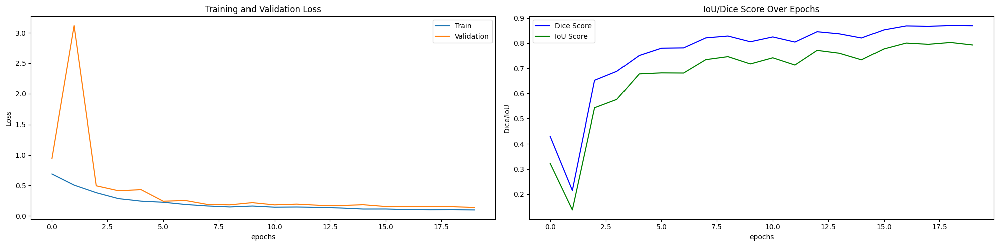

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20,5))

# Plotting Training and Validation Loss
axes[0].set_title("Training and Validation Loss")
axes[0].plot(train_losses,label="Train")
axes[0].plot(val_losses,label="Validation")
axes[0].set_xlabel("epochs")
axes[0].set_ylabel("Loss")
axes[0].legend()

# Plotting Dice Score
axes[1].set_title("IoU/Dice Score Over Epochs")
axes[1].plot(val_dice_scores, label="Dice Score", color="blue")
axes[1].plot(val_iou_scores, label="IoU Score", color="green")
axes[1].set_xlabel("epochs")
axes[1].set_ylabel("Dice/IoU")
axes[1].legend()

plt.tight_layout()  # Adjusts subplots so they don't overlap
plt.show()

### UNet Predictions

Model 2 Prediction:


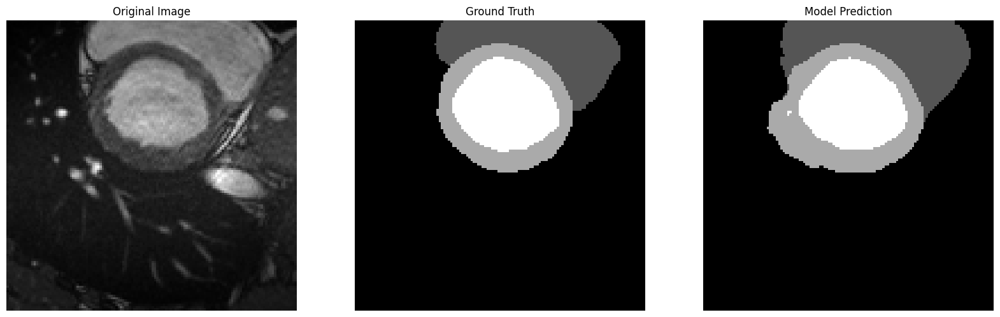

Model 2 Prediction:


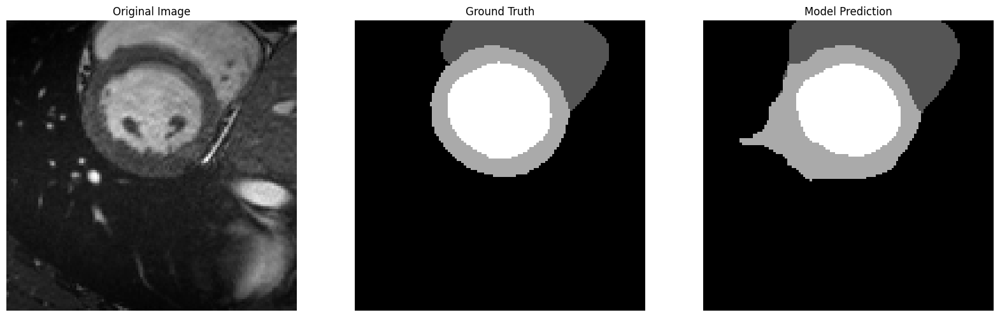

Model 2 Prediction:


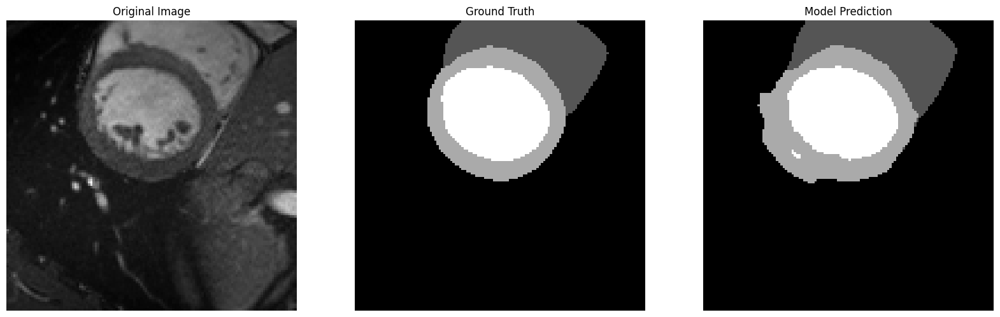

Model 2 Prediction:


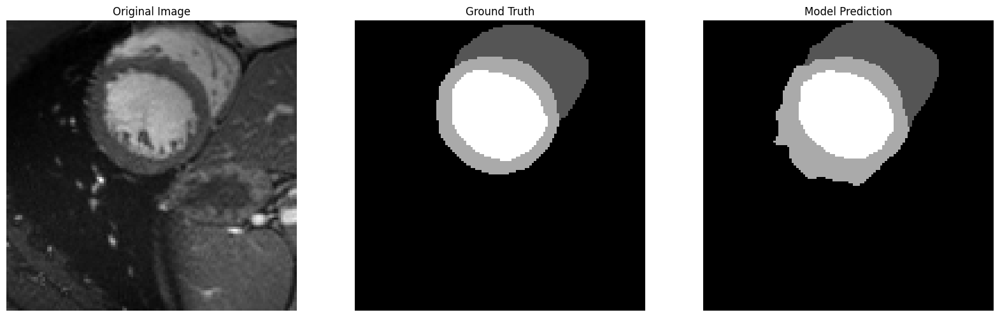

Model 2 Prediction:


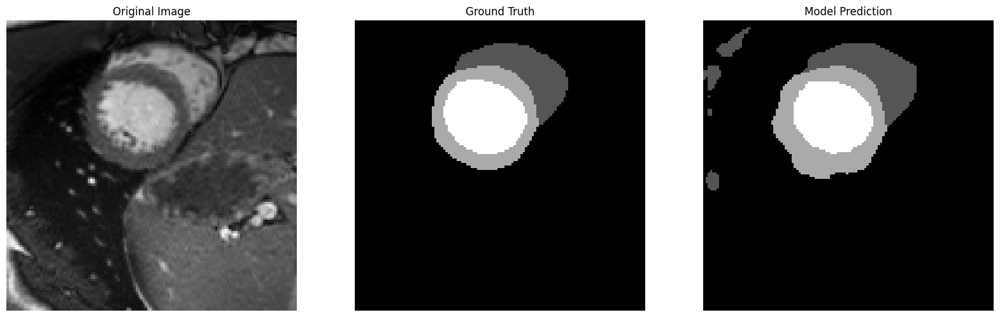

Model 2 Prediction:


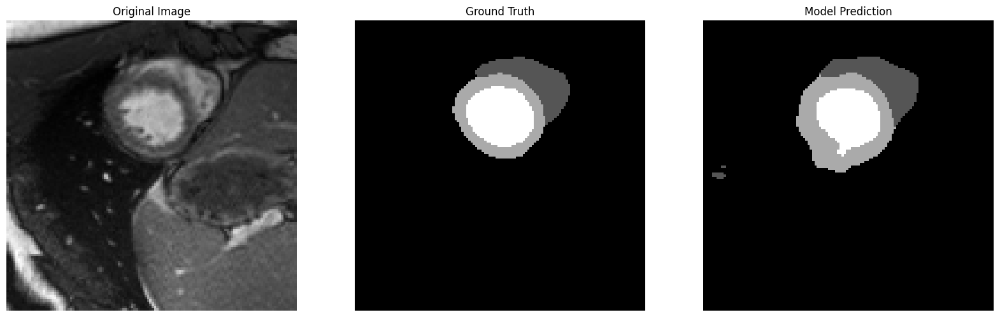

Model 2 Prediction:


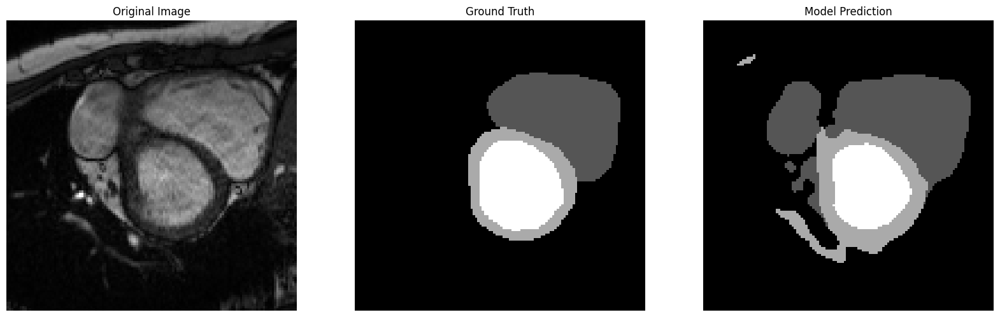

Model 2 Prediction:


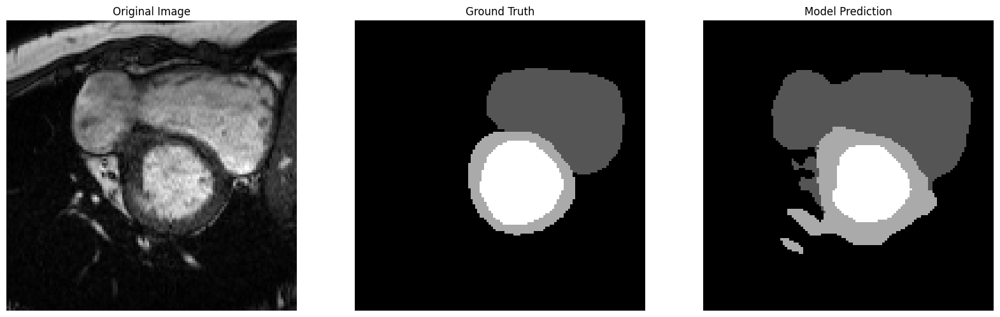

Model 2 Prediction:


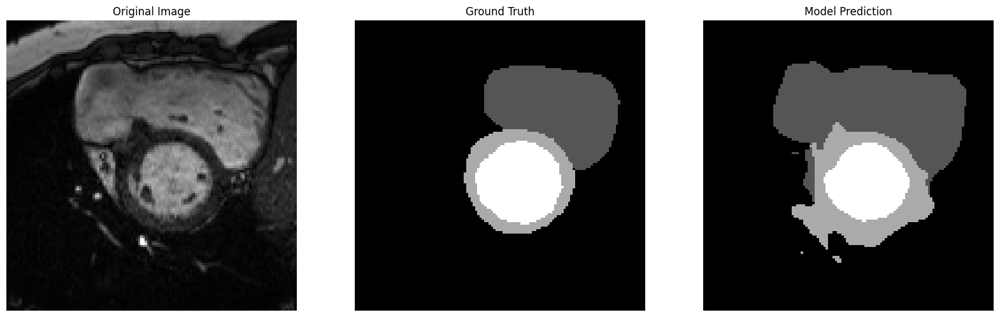

Model 2 Prediction:


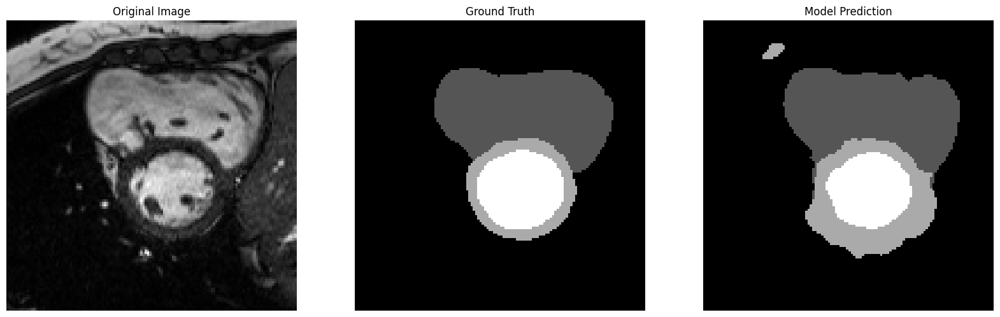

Model 2 Prediction:


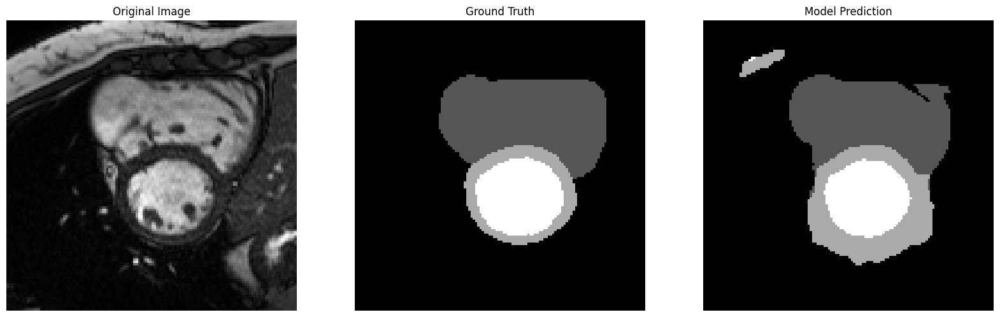

Model 2 Prediction:


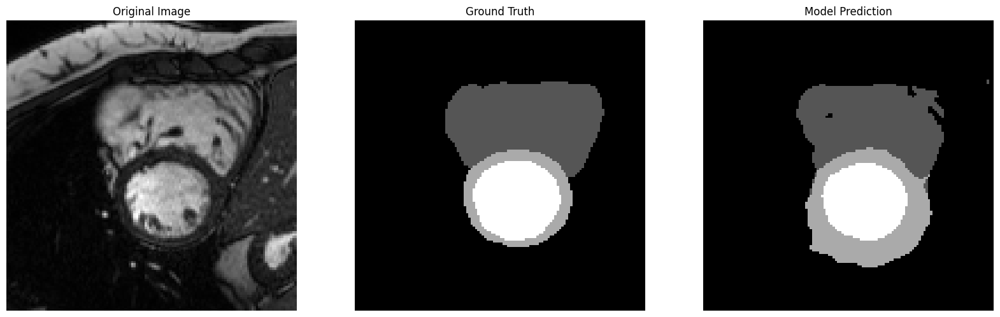

Model 2 Prediction:


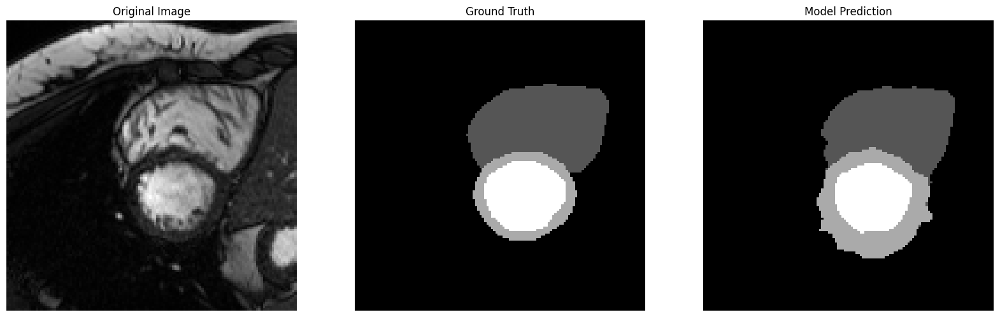

Model 2 Prediction:


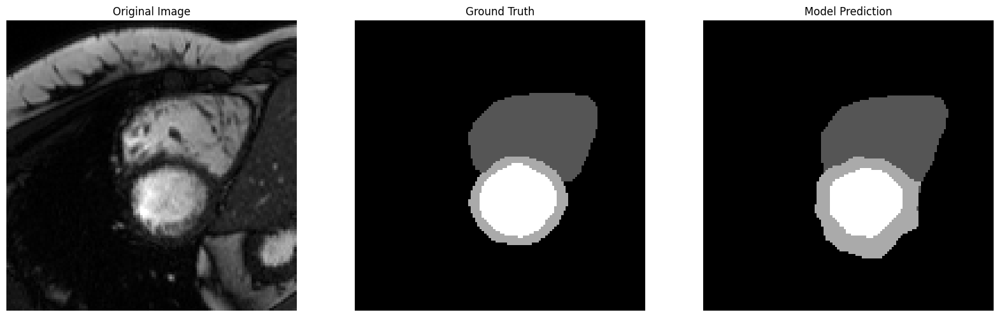

Model 2 Prediction:


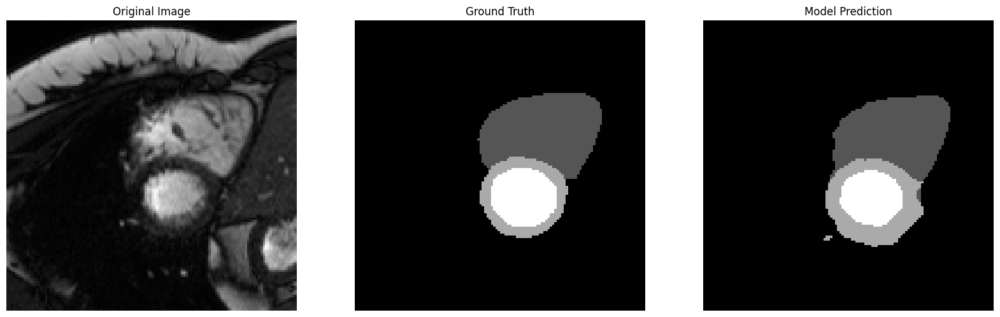

Model 2 Prediction:


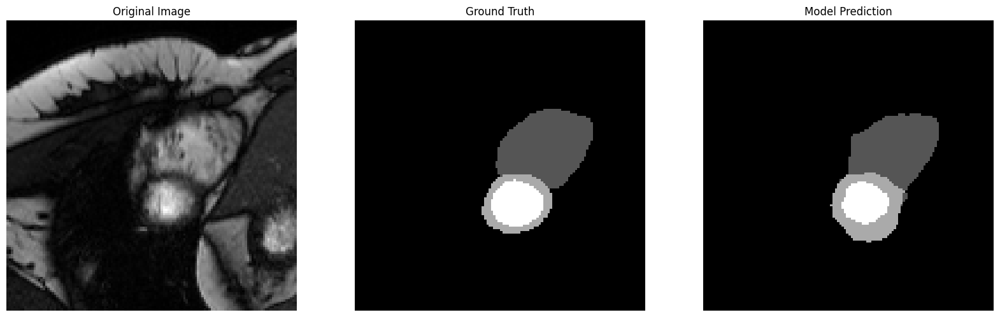

Model 2 Prediction:


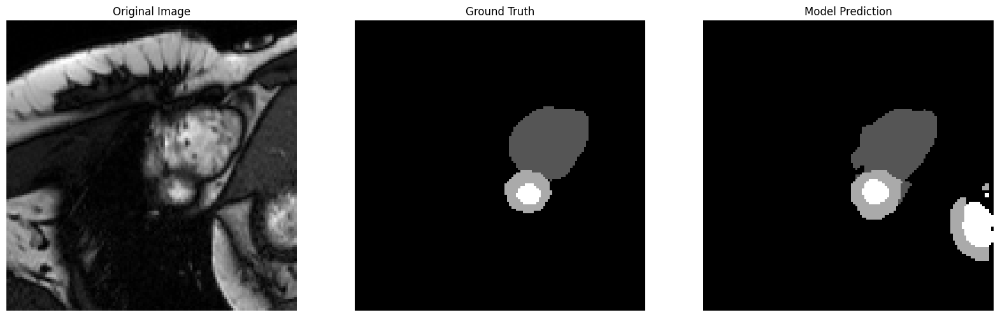

Model 2 Prediction:


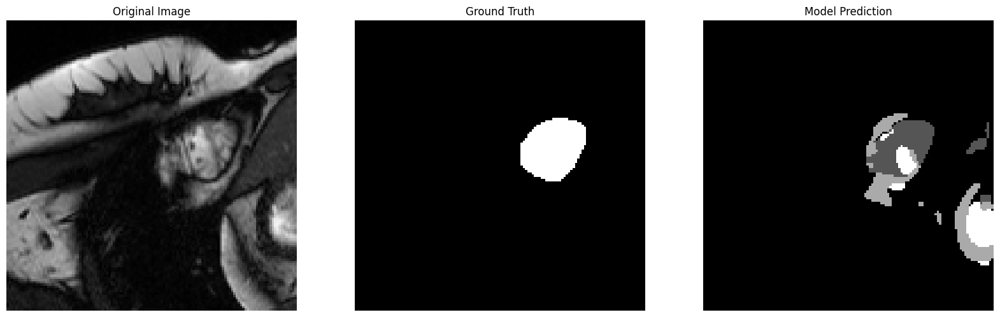

Model 2 Prediction:


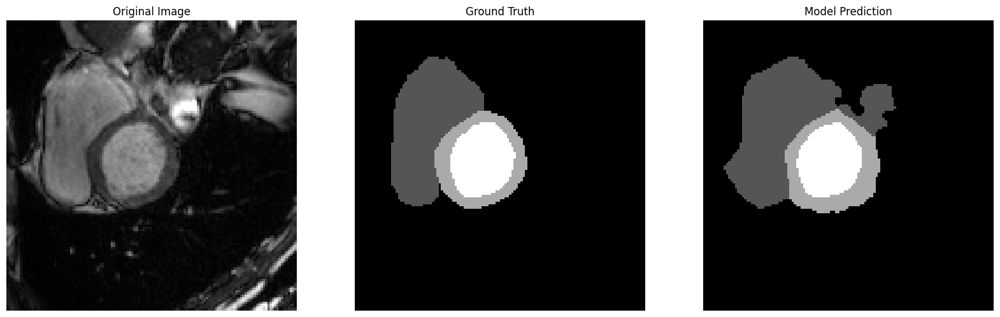

Model 2 Prediction:


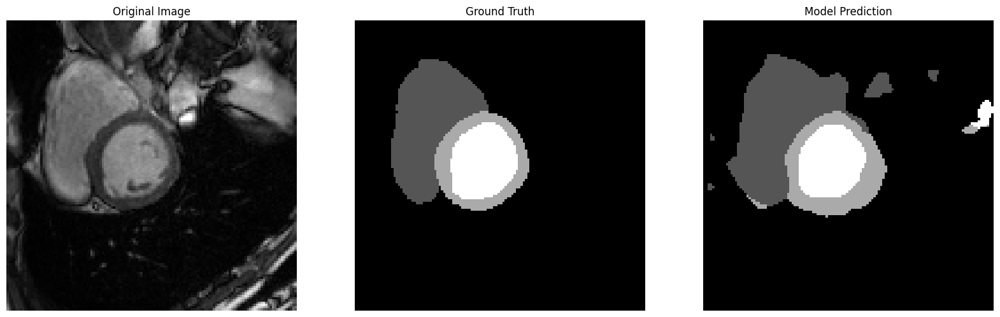

Model 2 Prediction:


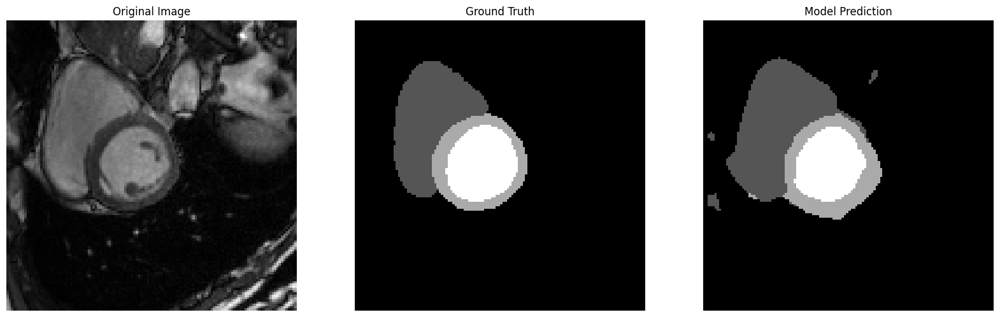

Model 2 Prediction:


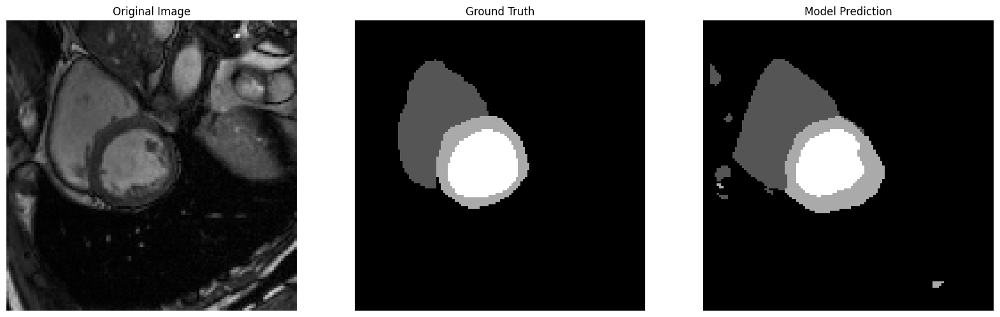

Model 2 Prediction:


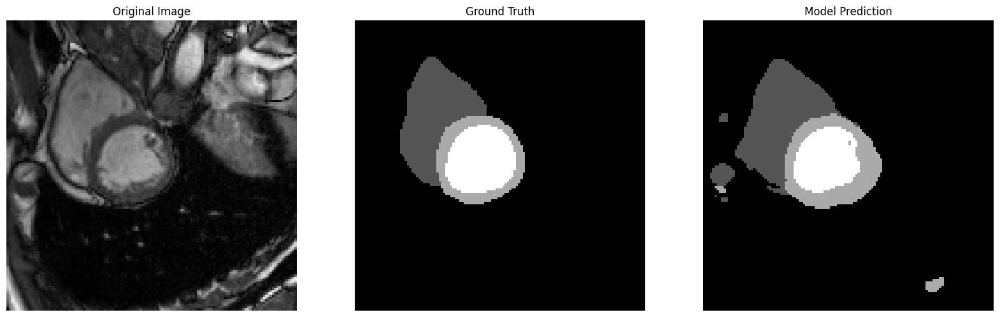

Model 2 Prediction:


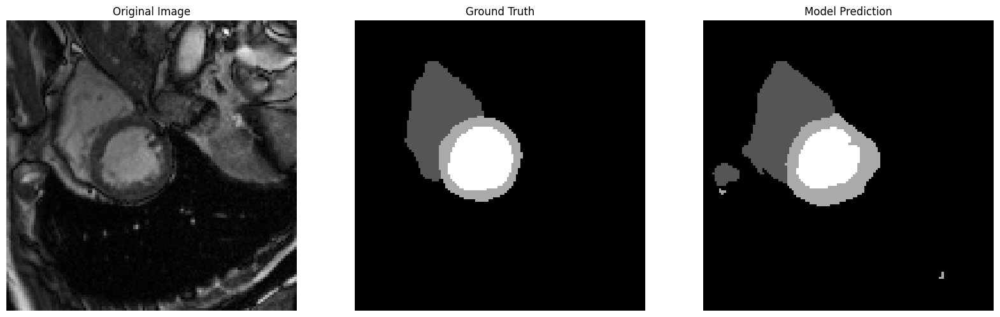

Model 2 Prediction:


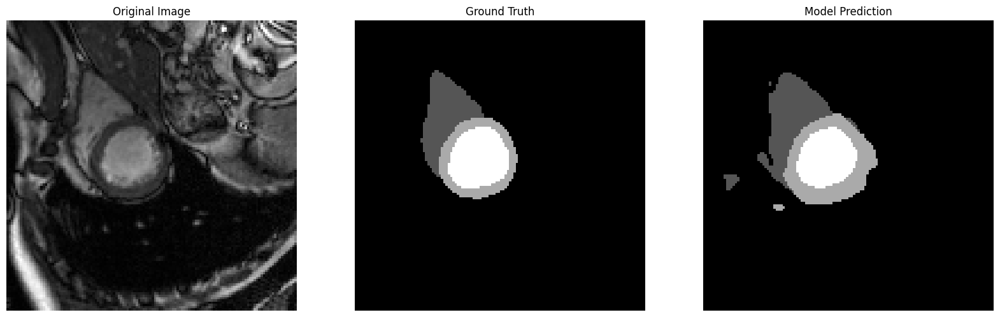

Model 2 Prediction:


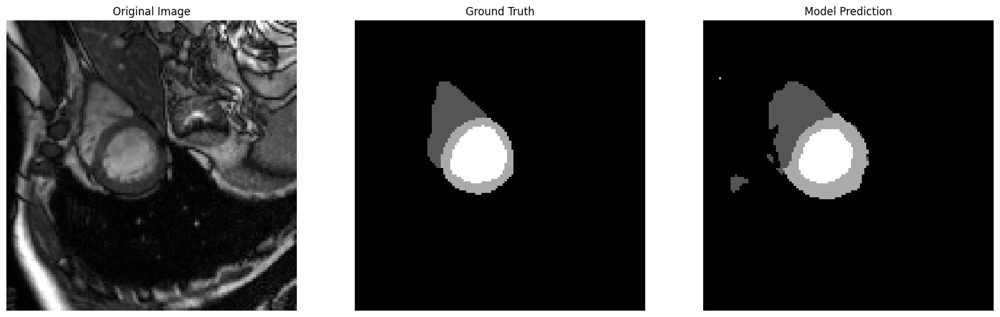

Model 2 Prediction:


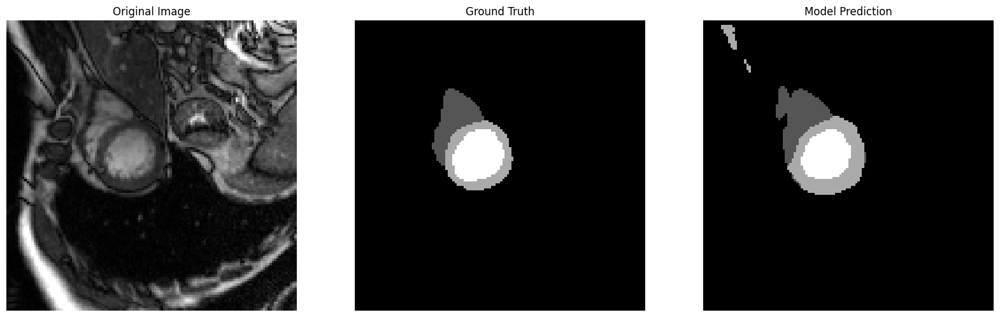

Model 2 Prediction:


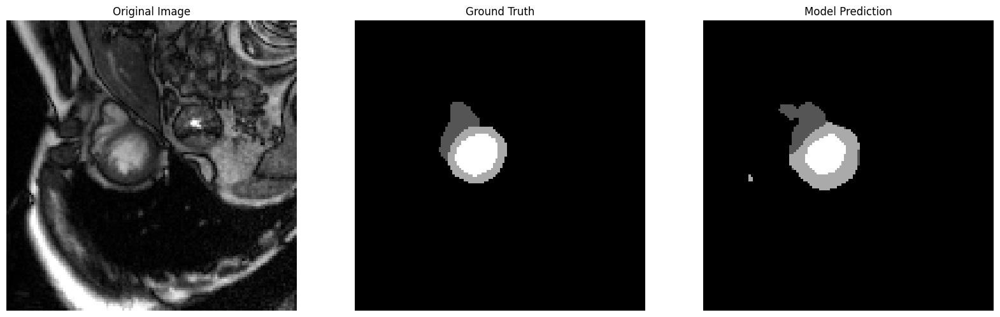

Model 2 Prediction:


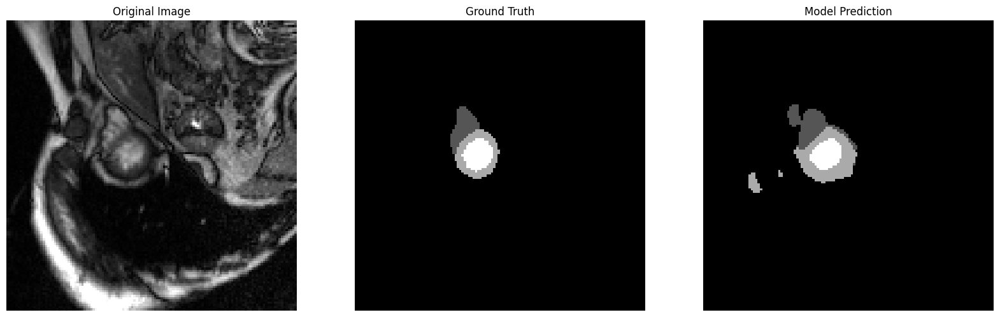

Model 2 Prediction:


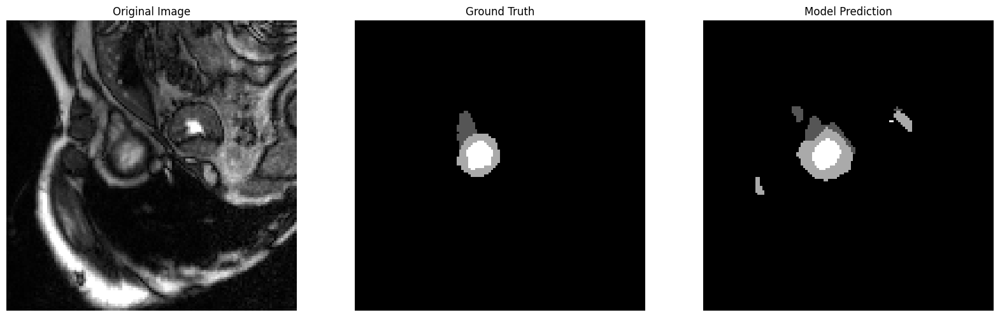

Model 2 Prediction:


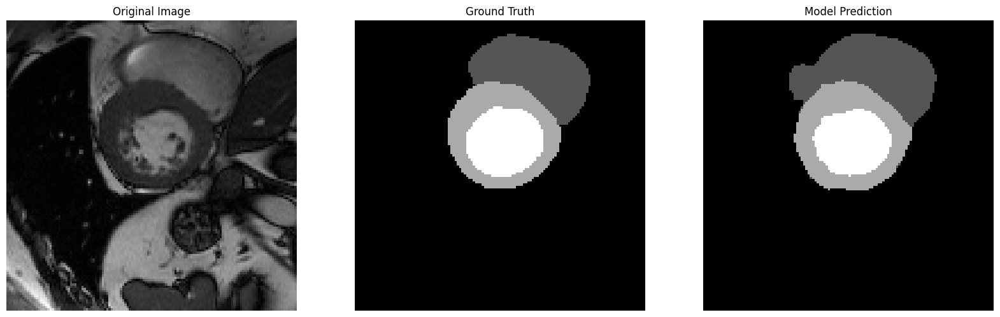

Model 2 Prediction:


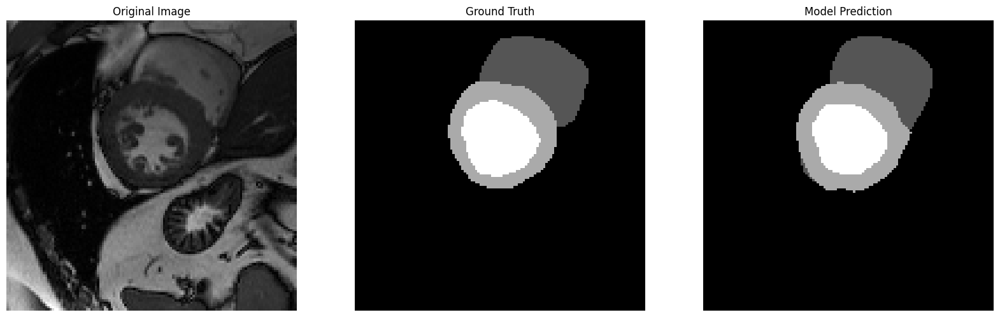

Model 2 Prediction:


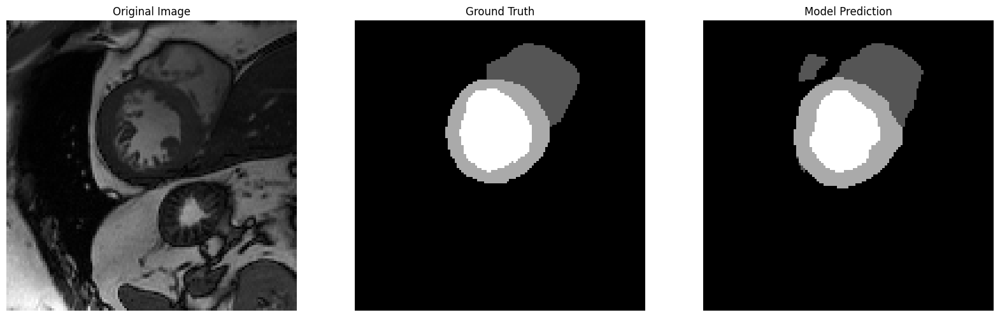

Model 2 Prediction:


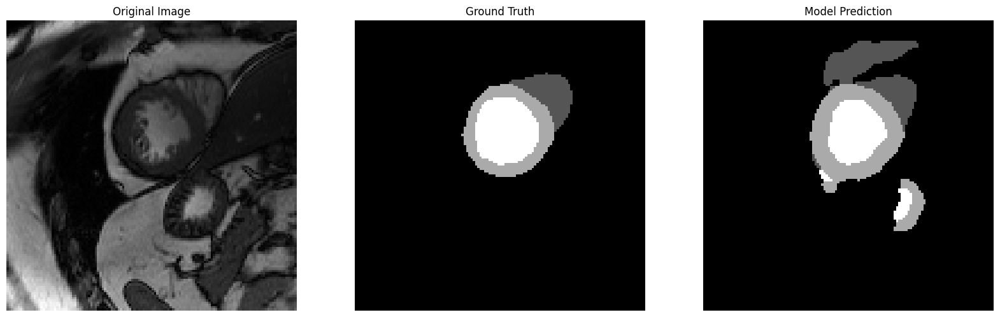

Model 2 Prediction:


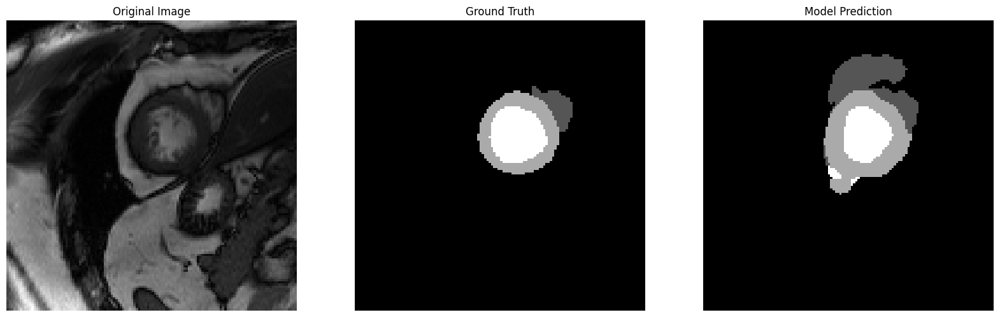

Model 2 Prediction:


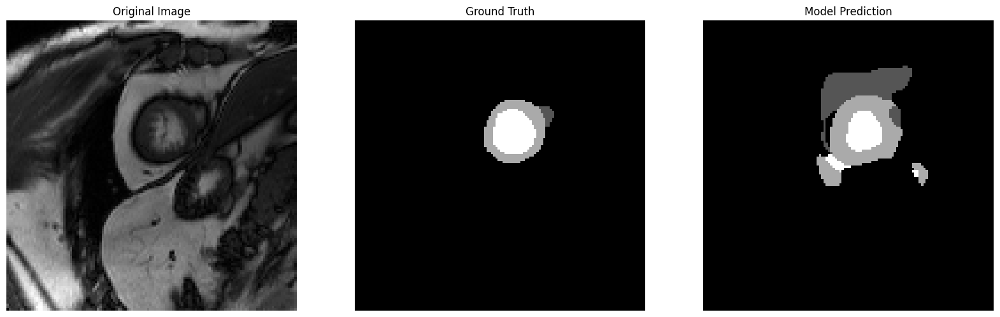

Model 2 Prediction:


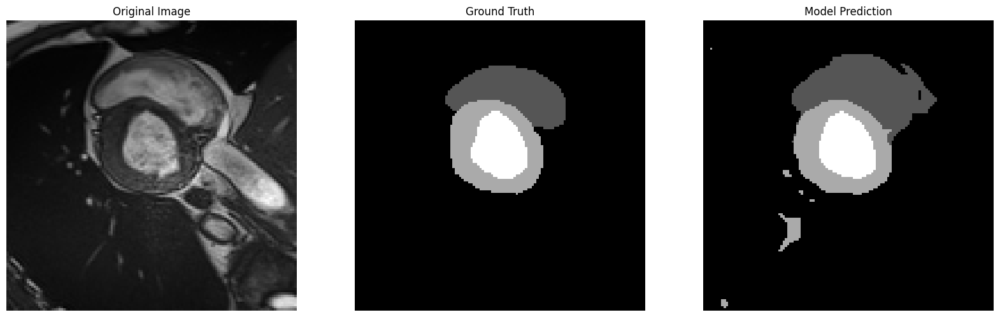

Model 2 Prediction:


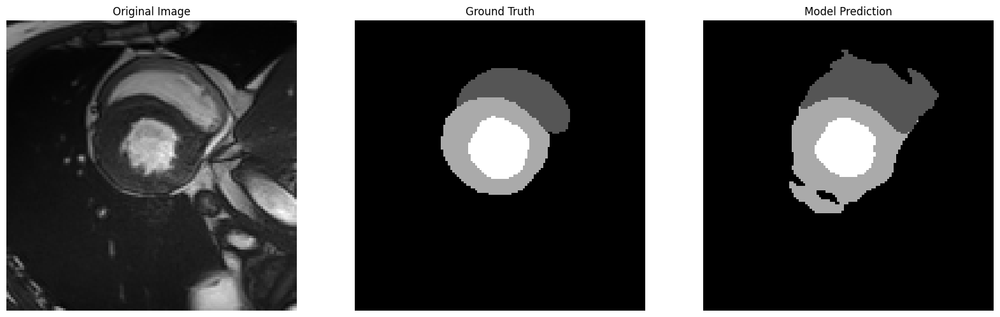

Model 2 Prediction:


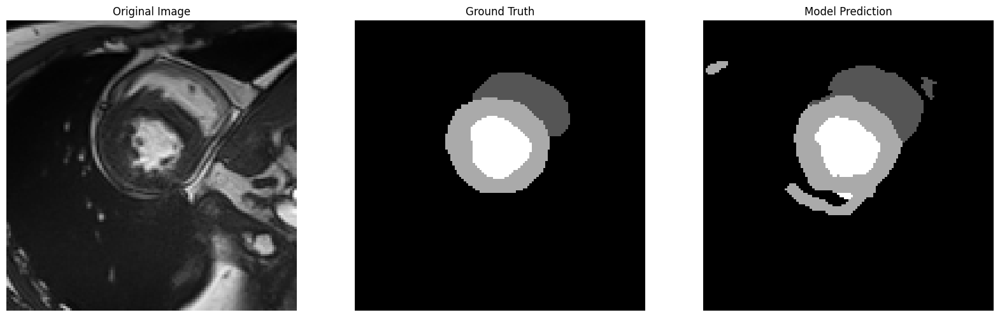

Model 2 Prediction:


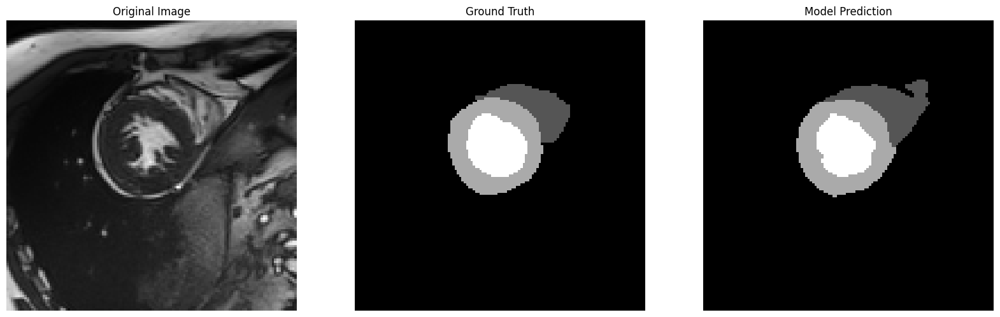

Model 2 Prediction:


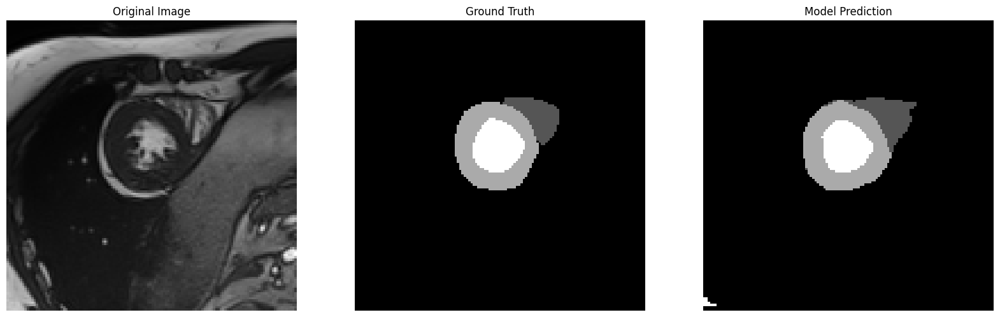

Model 2 Prediction:


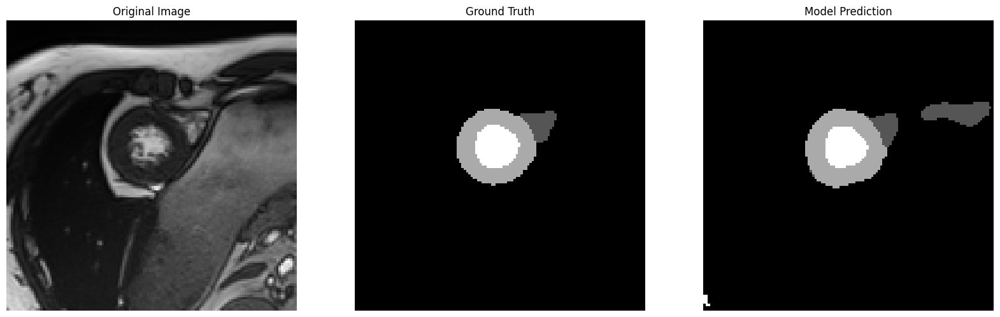

Model 2 Prediction:


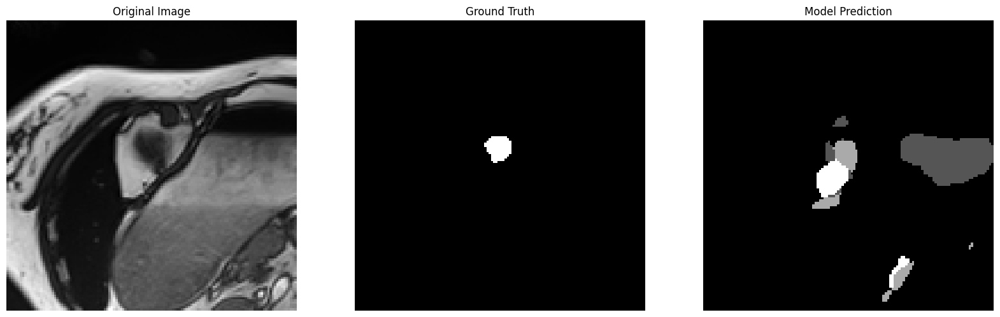

Model 2 Prediction:


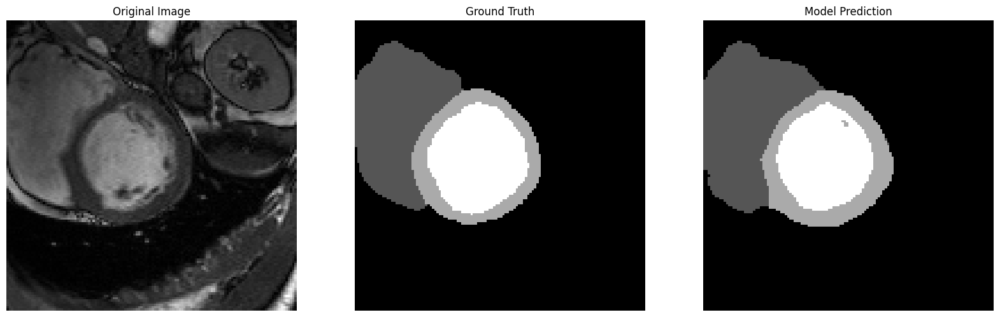

Model 2 Prediction:


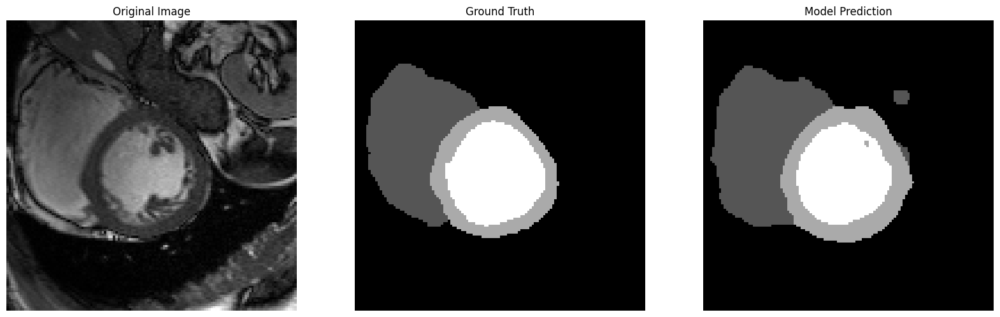

Model 2 Prediction:


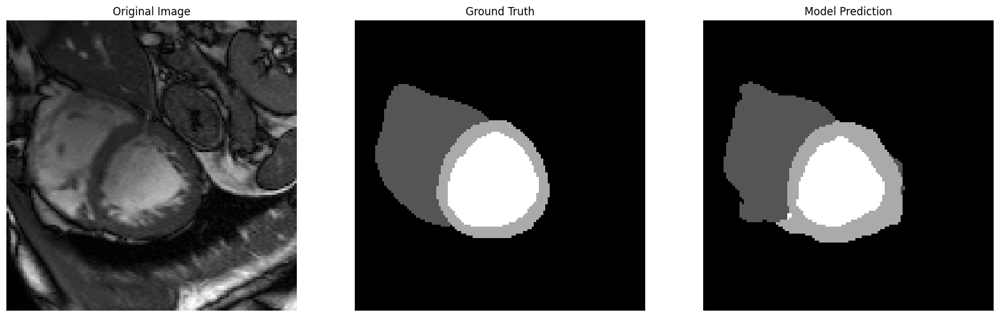

Model 2 Prediction:


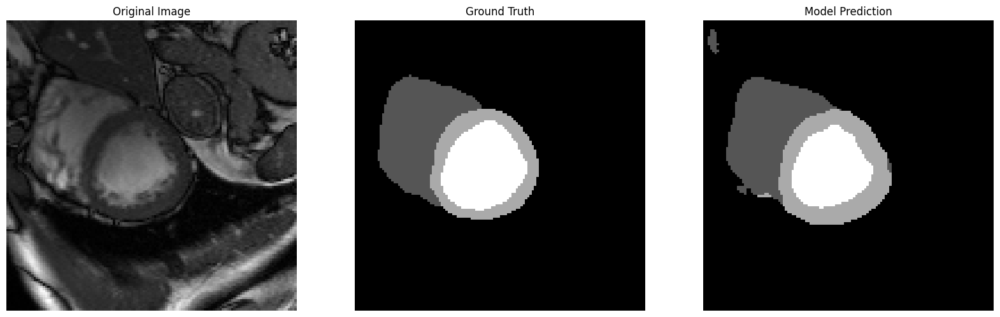

Model 2 Prediction:


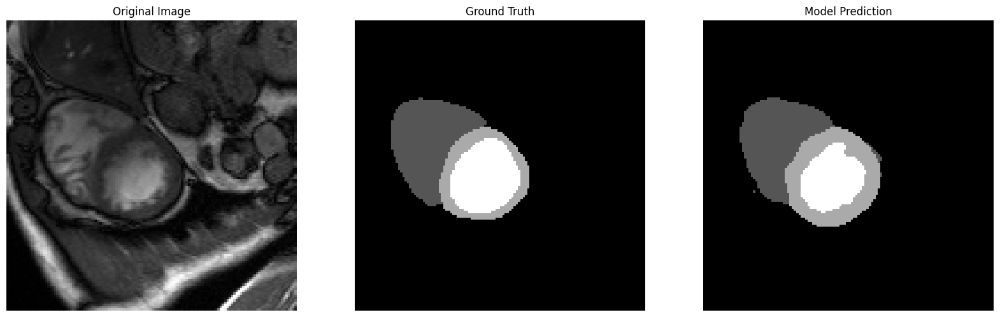

Model 2 Prediction:


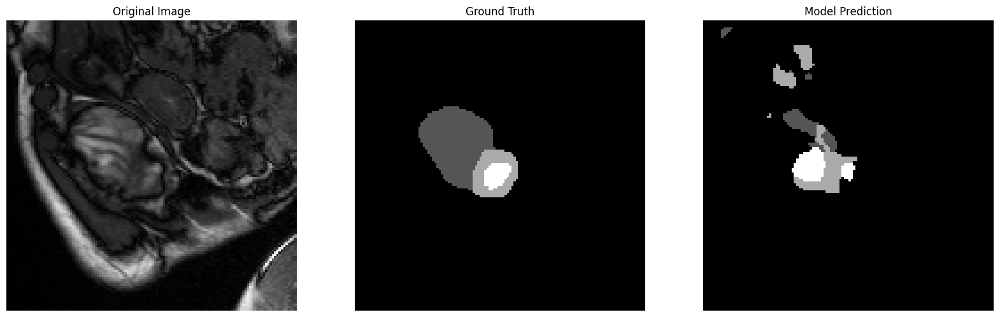

Model 2 Prediction:


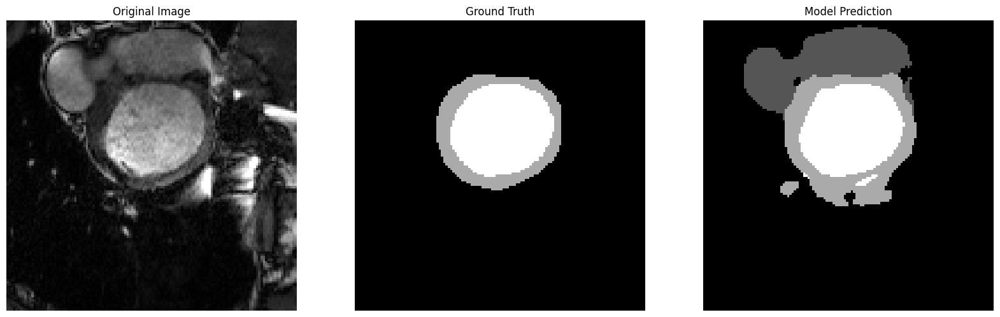

Model 2 Prediction:


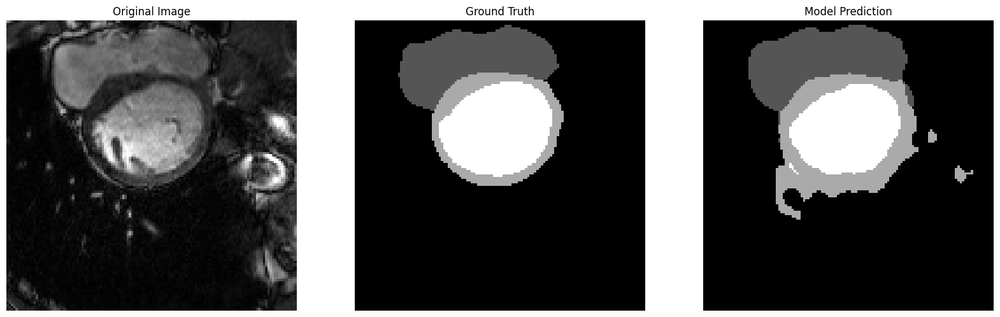

Model 2 Prediction:


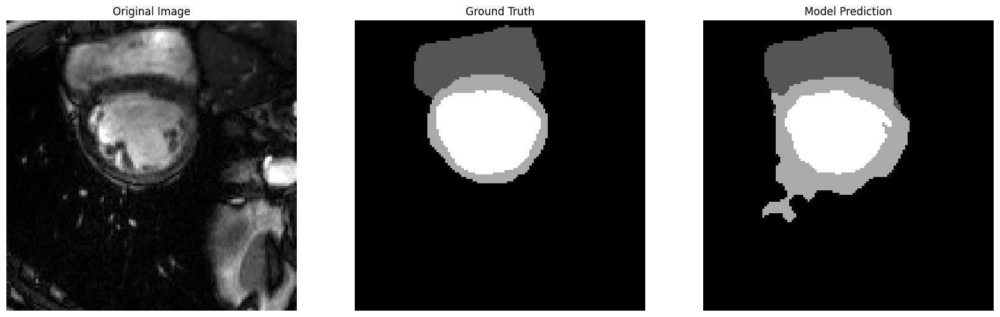

Model 2 Prediction:


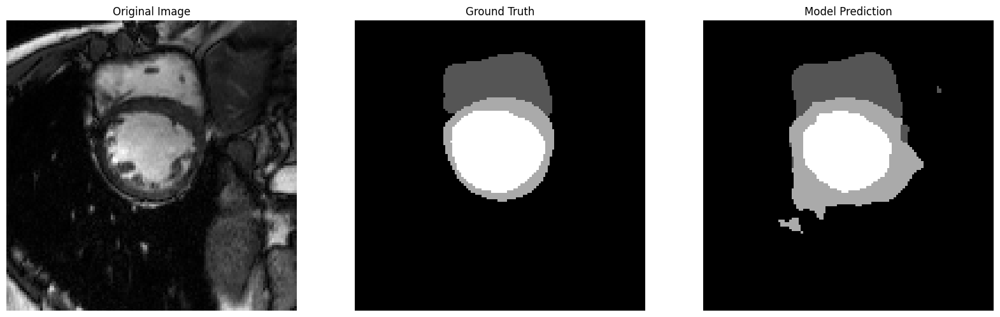

Model 2 Prediction:


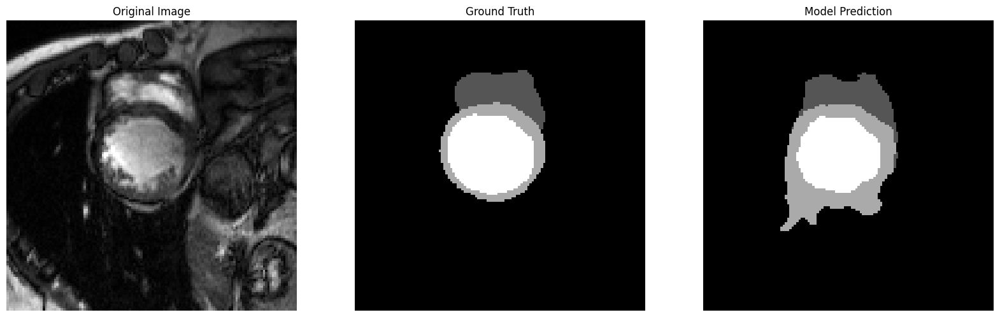

Model 2 Prediction:


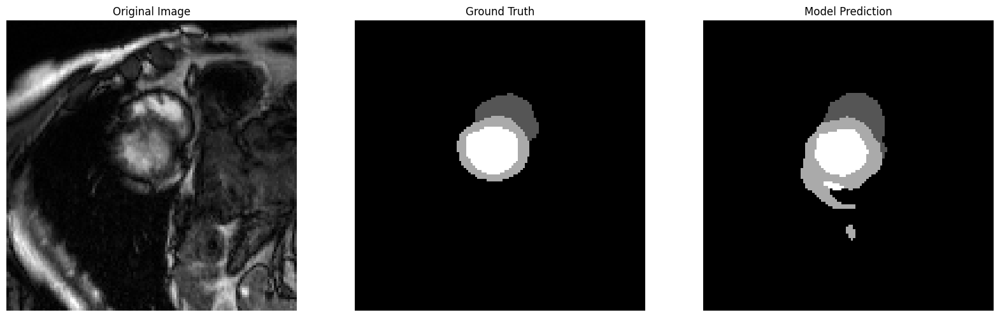

Model 2 Prediction:


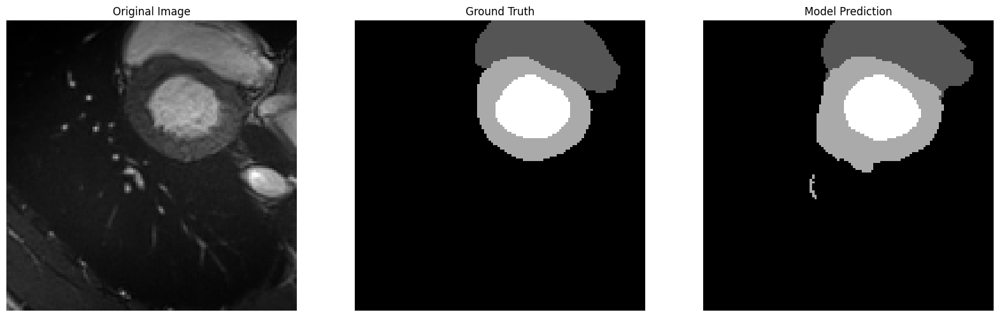

Model 2 Prediction:


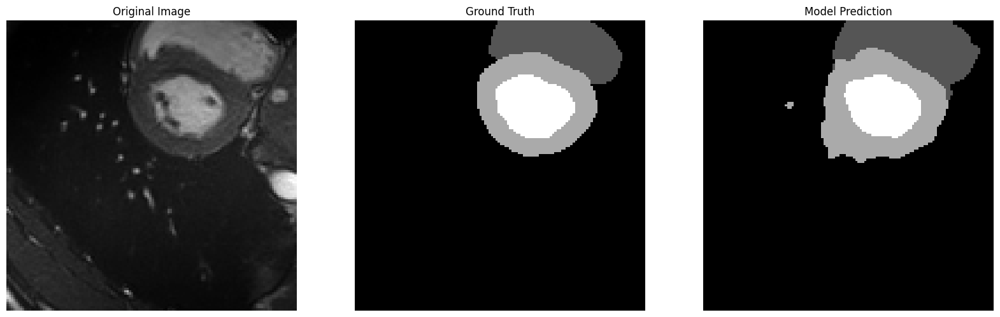

Model 2 Prediction:


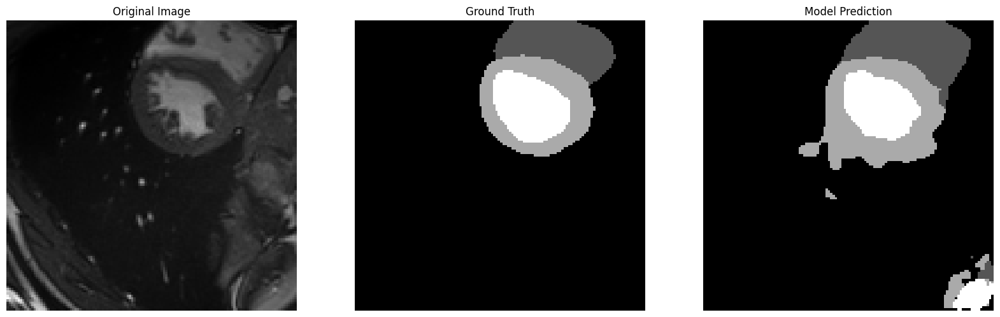

Model 2 Prediction:


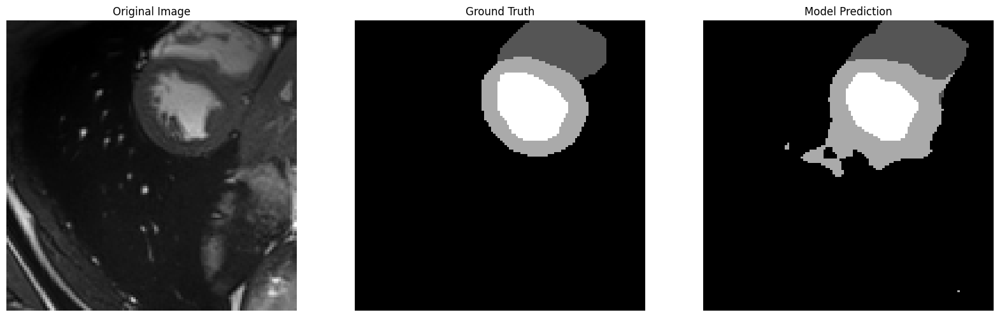

Model 2 Prediction:


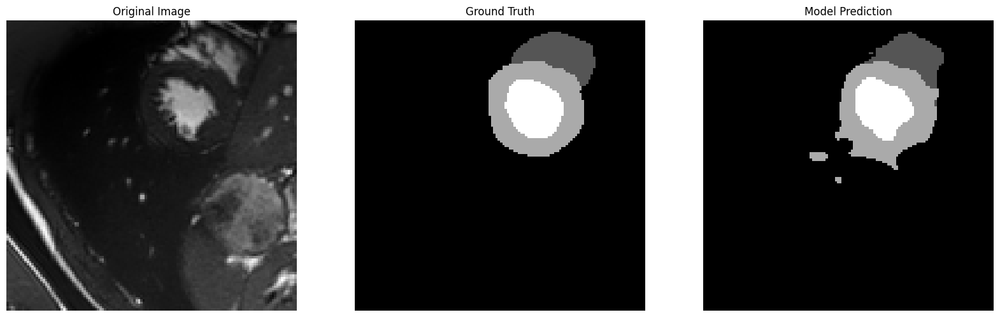

Model 2 Prediction:


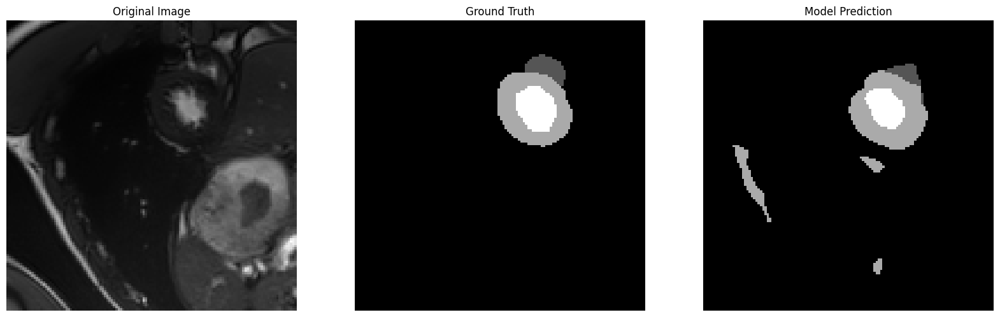

Model 2 Prediction:


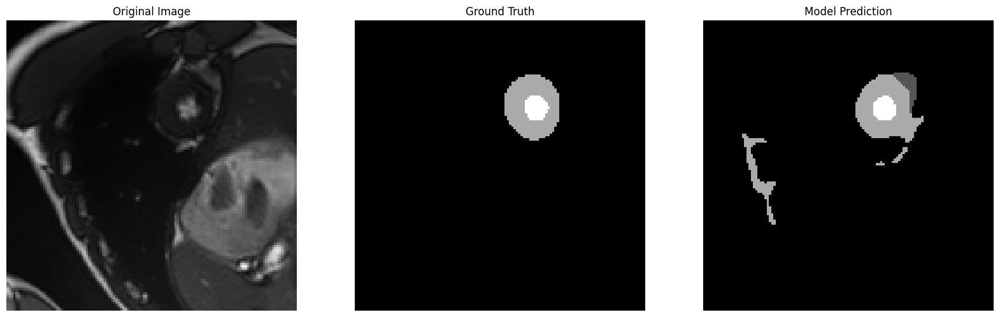

Model 2 Prediction:


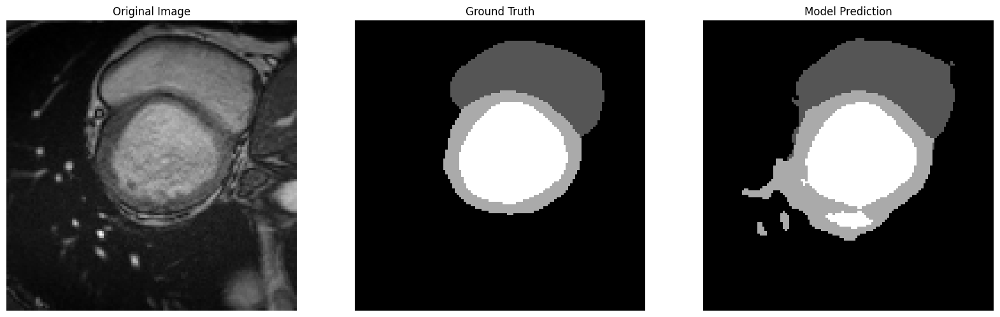

Model 2 Prediction:


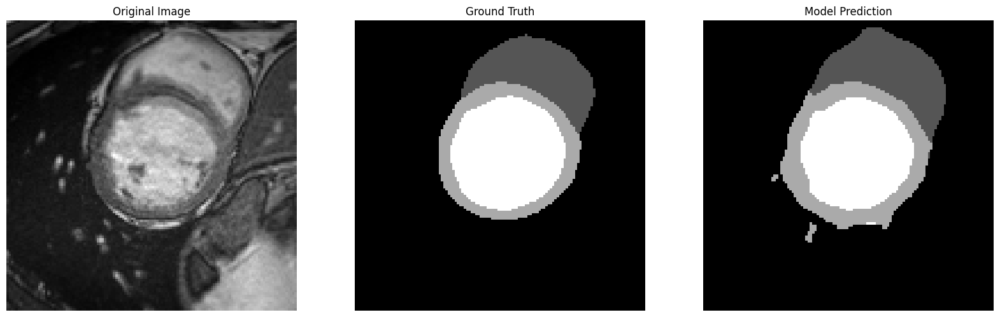

Model 2 Prediction:


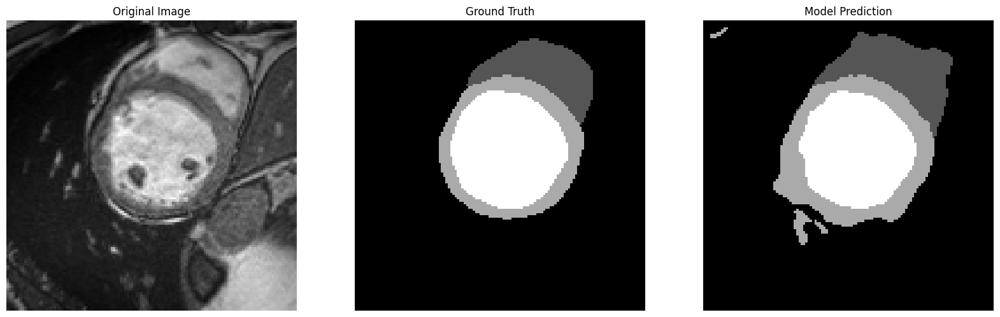

Model 2 Prediction:


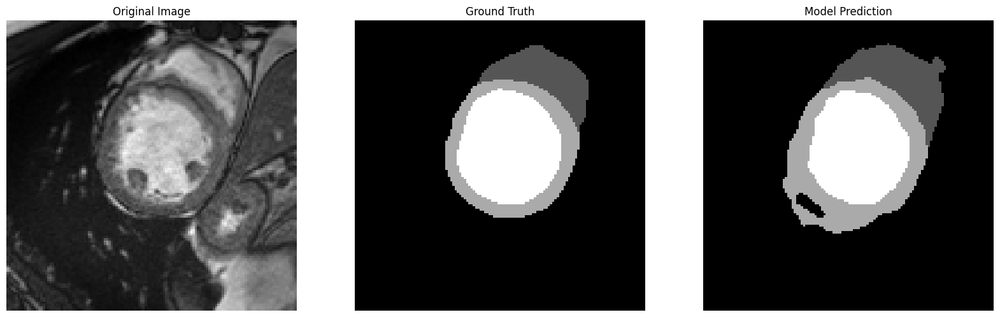

Model 2 Prediction:


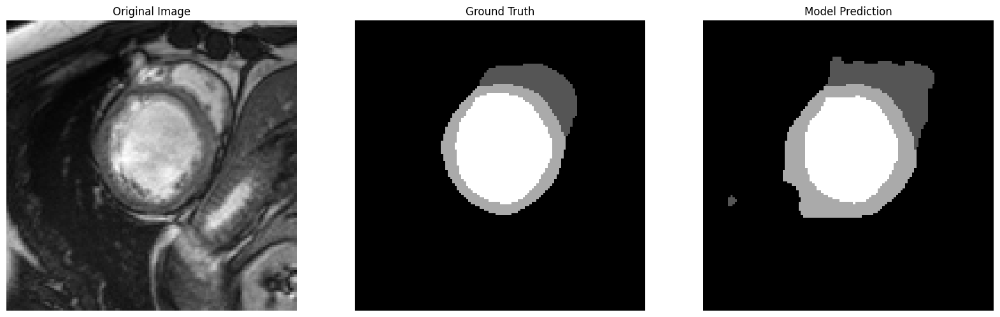

Model 2 Prediction:


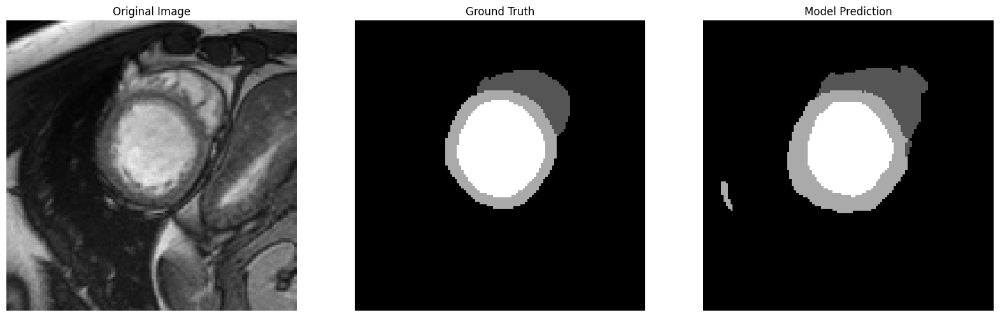

Model 2 Prediction:


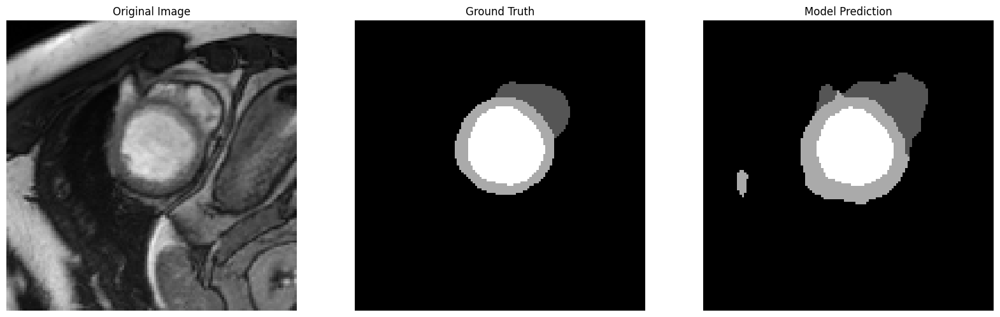

Model 2 Prediction:


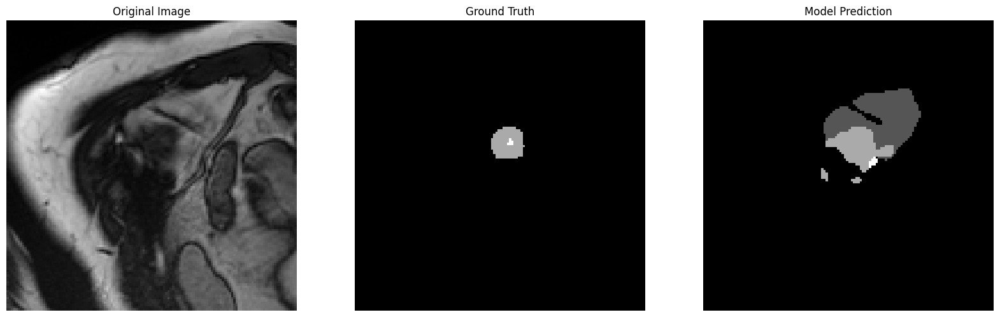

Model 2 Prediction:


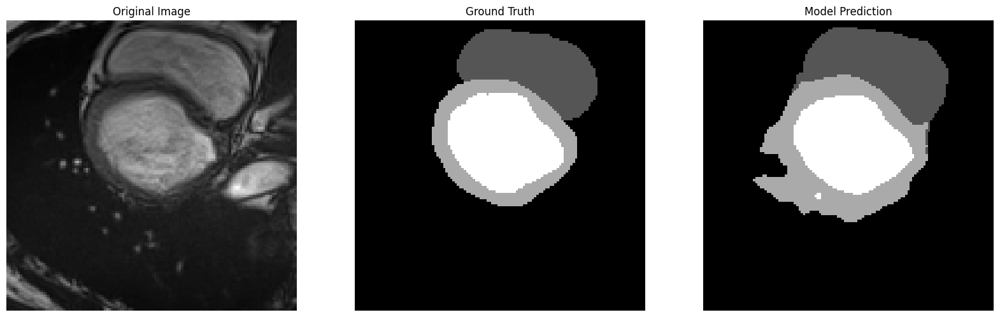

Model 2 Prediction:


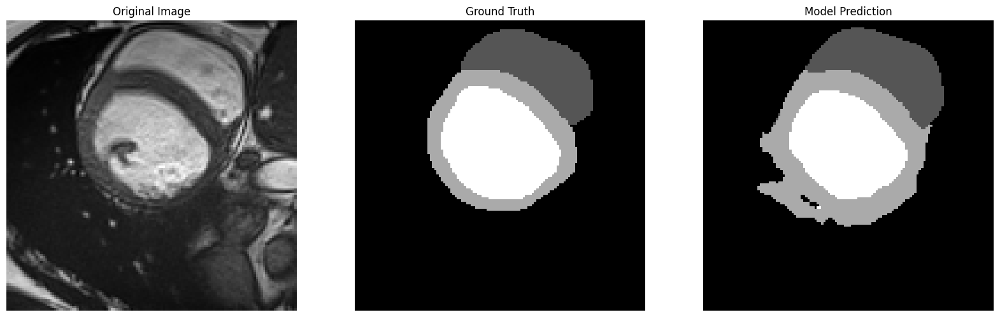

Model 2 Prediction:


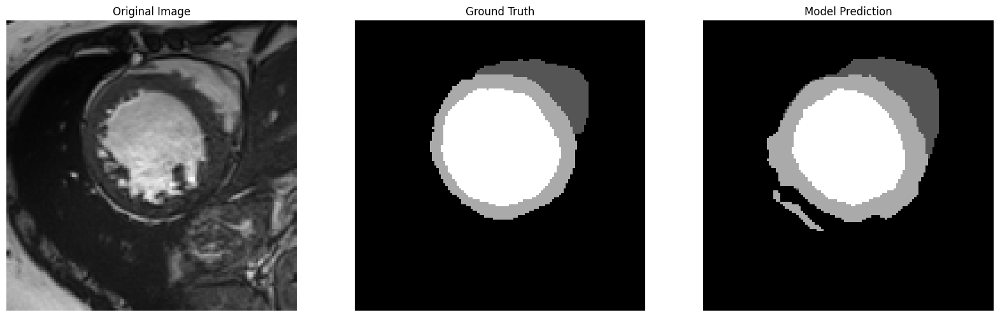

Model 2 Prediction:


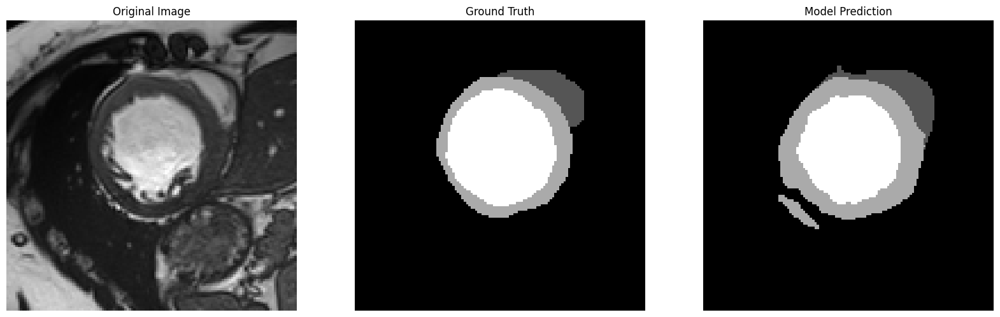

Model 2 Prediction:


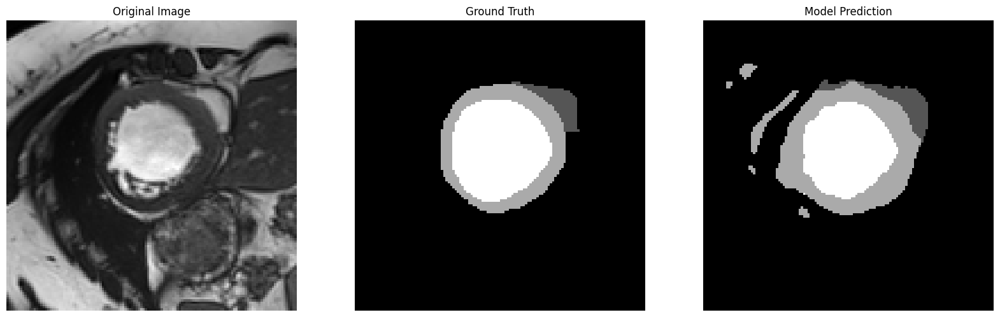

Model 2 Prediction:


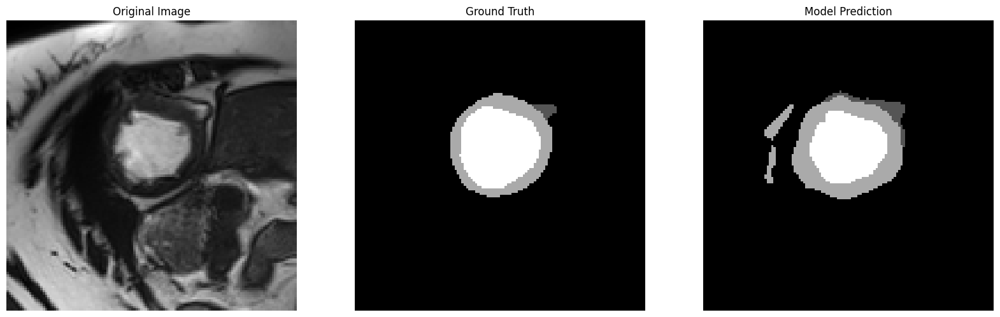

Model 2 Prediction:


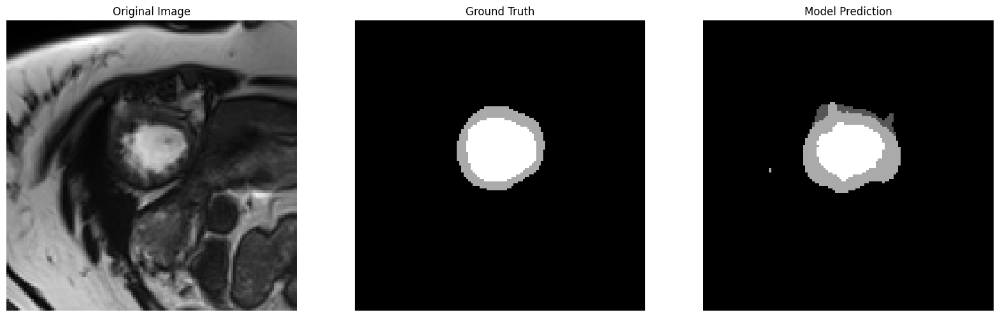

Model 2 Prediction:


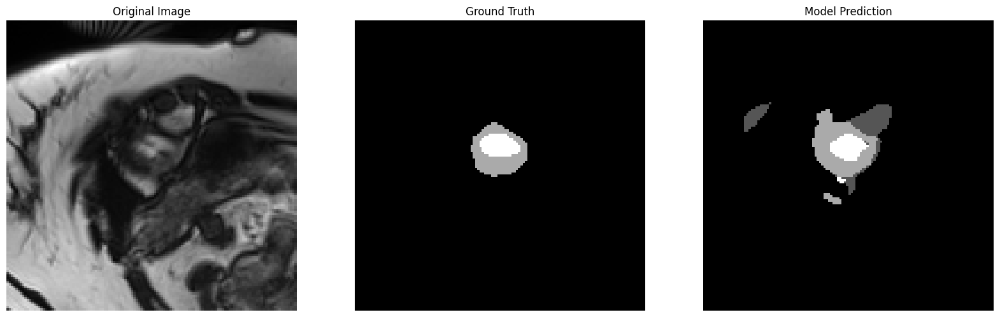

In [ ]:
def visualize_predictions(image, mask, prediction):
    fig, axs = plt.subplots(1, 3, figsize=(20, 20))

    axs[0].imshow(image.cpu().squeeze().numpy(), cmap='gray')
    axs[0].set_title('Original Image')

    axs[1].imshow(mask.cpu().squeeze().numpy(), cmap='gray')
    axs[1].set_title('Ground Truth')

    axs[2].imshow(prediction.cpu().squeeze().numpy(), cmap='gray')
    axs[2].set_title('Model Prediction')

    for ax in axs:
        ax.axis('off')

    plt.show()

model1 = UNet(in_chns=1, class_num=4)
# Load the best model
model1.load_state_dict(torch.load(SAVE_PATH_UNET))
model1.to(device)
model1.eval()

with torch.no_grad():
    for images, masks in val_dataloader:
        images, masks = images.to(device), masks.to(device)

        outputs2, *_ = model1(images)
        #prediction2 = outputs2
        prediction2 = torch.argmax(outputs2, dim=1)

        # Just visualize for the first few samples in the batch
        for i in range(min(3, images.size(0))):

            print("Model 2 Prediction:")
            visualize_predictions(images[i], masks[i], prediction2[i])

## E. Standalone SwinUNet Training and Evaluation

In [ ]:
from custom_networks.vision_transformer import SwinUnet

# Swin Transformer parameters
swin_config = argparse.Namespace(
    PATCH_SIZE = 4, #4
    IN_CHANS = 3,
    EMBED_DIM = 96,
    DEPTHS = [4, 4, 10, 4], #[2, 3, 7, 3],# [2, 2, 6, 2],#[2, 3, 7, 3],
    DECODER_DEPTHS =  [4, 4, 10, 4],#[2, 3, 7, 3],# [2, 2, 6, 2],#[[2, 3, 7, 3],
    NUM_HEADS = [4, 8, 16, 32],#[3, 6, 12, 24],
    WINDOW_SIZE = 8,
    MLP_RATIO = 4,
    QKV_BIAS = True,
    QK_SCALE = None,
    APE = False,
    PATCH_NORM = True,
    FINAL_UPSAMPLE= "expand_first",
    DROP_RATE = 0.0,
    DROP_PATH_RATE = 0.1,
    USE_CHECKPOINT = False
)

pretrained_swinunet_path = "/content/drive/MyDrive/saved_models/best_model_swin_16bs_finetune.pth"

model2 = SwinUnet(swin_config, img_size=128, num_classes=4)
checkpoint = torch.load(pretrained_swinunet_path)#, map_location=torch.device('cpu'))
model2.load_state_dict(checkpoint)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
celoss = nn.CrossEntropyLoss(weight=weights_normalized).to(device)
diceloss = DiceLoss(to_onehot_y=True).to(device)

# Define the combined loss function
def combined_cediceloss_fn(outputs, masks):
    ce = celoss(outputs, masks.squeeze(1))
    dice = diceloss(outputs, masks)
    return  1 * ce# + 0.5 * dice

dice_metric = DiceMetric(include_background=True, reduction="mean")
iou_metric = MeanIoU(include_background = True, reduction ="mean")
optimizer = optim.AdamW(model2.parameters(), lr=0.003)

model2 = model2.to(device)

model_save_dir = '/content/drive/MyDrive/saved_models'
SAVE_PATH_SWIN = os.path.join(model_save_dir,'best_model_swin_16bs_finetune_cedice.pth')

SwinTransformerSys expand initial----depths:[4, 4, 10, 4];depths_decoder:[1, 2, 2, 2];drop_path_rate:0.1;num_classes:4
---final upsample expand_first---


In [ ]:
# To store losses for plotting
train_losses = []
val_losses = []
val_dice_scores = []
val_iou_scores = []

num_epochs = 20
best_val_loss = float('inf')

scheduler = CosineAnnealingLR(optimizer, T_max=len(train_dataloader) * num_epochs)

for epoch in range(num_epochs):
    model2.train()  # Set the model to training mode
    running_loss_train = 0.0
    for images, masks in train_dataloader:
        images = images.to(device)
        masks = masks.long().to(device)

        # Forward pass
        outputs, *_ = model2(images)

        # Compute loss
        loss = combined_cediceloss_fn(outputs, masks)

        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        # Step the scheduler
        scheduler.step()

        # Print statistics
        running_loss_train += loss.item() * images.size(0)
    train_losses.append(running_loss_train / len(train_dataloader.dataset))

    # Validation
    model2.eval()  # Set the model to evaluation mode
    with torch.no_grad():  # Do not calculate gradient to save memory
        running_loss_val = 0.0
        for images, masks in val_dataloader:
            images = images.to(device)
            masks = masks.long().to(device)

            # Forward pass
            outputs, *_ = model2(images)

            # Compute loss
            loss = combined_cediceloss_fn(outputs, masks)

            # Accumulate validation loss
            running_loss_val += loss.item() * images.size(0)

            val_outputs = [post_pred(i) for i in decollate_batch(outputs)]
            val_masks = [post_label(i) for i in decollate_batch(masks)]

            dice_score = dice_metric(val_outputs, val_masks)
            iou_score = iou_metric(val_outputs, val_masks)

        dice_scores = dice_metric.aggregate().item()
        iou_scores = iou_metric.aggregate().item()
        dice_metric.reset()
        iou_metric.reset()

        val_dice_scores.append(dice_scores)
        val_iou_scores.append(iou_scores)

        # Compute the average validation loss for this epoch
        avg_val_loss = running_loss_val / len(val_dataloader.dataset)
        #scheduler.step(avg_val_loss)
        val_losses.append(avg_val_loss)

        # Save best model
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            torch.save(model2.state_dict(), SAVE_PATH_SWIN)
            print(f"Saved best models at epoch {epoch+1}")

    print(f"Epoch {epoch+1}, Training Loss: {train_losses[-1]:.3f}, Validation Loss: {val_losses[-1]:.3f}, Validation Dice: {val_dice_scores[-1]:.3f}, Validation IoU: {val_iou_scores[-1]:.3f}")

Saved best models at epoch 1
Epoch 1, Training Loss: 0.221, Validation Loss: 0.262, Validation Dice: 0.803, Validation IoU: 0.714
Saved best models at epoch 2
Epoch 2, Training Loss: 0.171, Validation Loss: 0.257, Validation Dice: 0.801, Validation IoU: 0.708
Saved best models at epoch 3
Epoch 3, Training Loss: 0.154, Validation Loss: 0.209, Validation Dice: 0.808, Validation IoU: 0.717
Epoch 4, Training Loss: 0.146, Validation Loss: 0.210, Validation Dice: 0.821, Validation IoU: 0.732
Epoch 5, Training Loss: 0.145, Validation Loss: 0.221, Validation Dice: 0.792, Validation IoU: 0.696
Epoch 6, Training Loss: 0.218, Validation Loss: 0.359, Validation Dice: 0.769, Validation IoU: 0.683
Epoch 7, Training Loss: 0.194, Validation Loss: 0.216, Validation Dice: 0.805, Validation IoU: 0.710
Saved best models at epoch 8
Epoch 8, Training Loss: 0.148, Validation Loss: 0.205, Validation Dice: 0.835, Validation IoU: 0.752
Epoch 9, Training Loss: 0.144, Validation Loss: 0.214, Validation Dice: 0.79

### Plot Swin-UNet Results

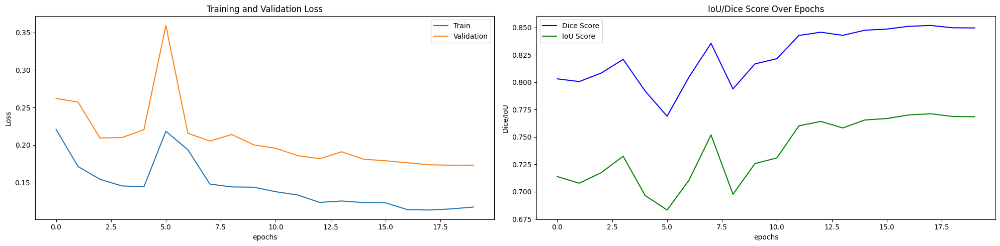

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20,5))

# Plotting Training and Validation Loss
axes[0].set_title("Training and Validation Loss")
axes[0].plot(train_losses,label="Train")
axes[0].plot(val_losses,label="Validation")
axes[0].set_xlabel("epochs")
axes[0].set_ylabel("Loss")
axes[0].legend()

# Plotting Dice Score
axes[1].set_title("IoU/Dice Score Over Epochs")
axes[1].plot(val_dice_scores, label="Dice Score", color="blue")
axes[1].plot(val_iou_scores, label="IoU Score", color="green")
axes[1].set_xlabel("epochs")
axes[1].set_ylabel("Dice/IoU")
axes[1].legend()

plt.tight_layout()  # Adjusts subplots so they don't overlap
plt.show()

### Swin-UNet Predictions

Model 2 Prediction:


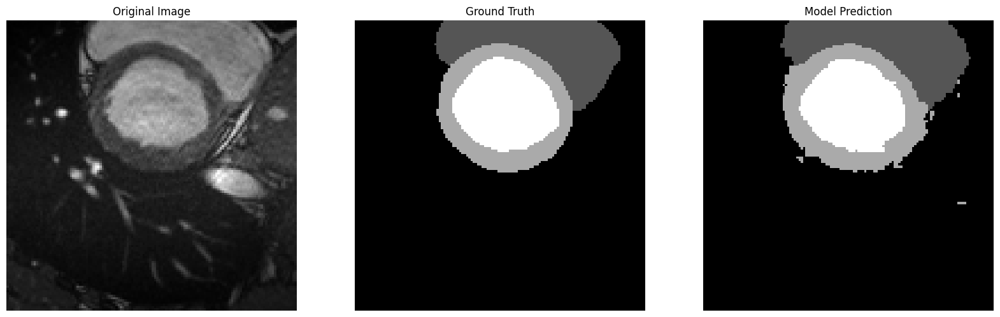

Model 2 Prediction:


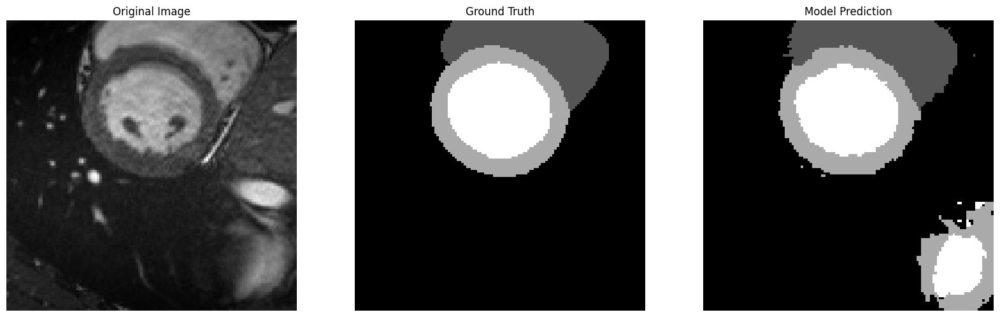

Model 2 Prediction:


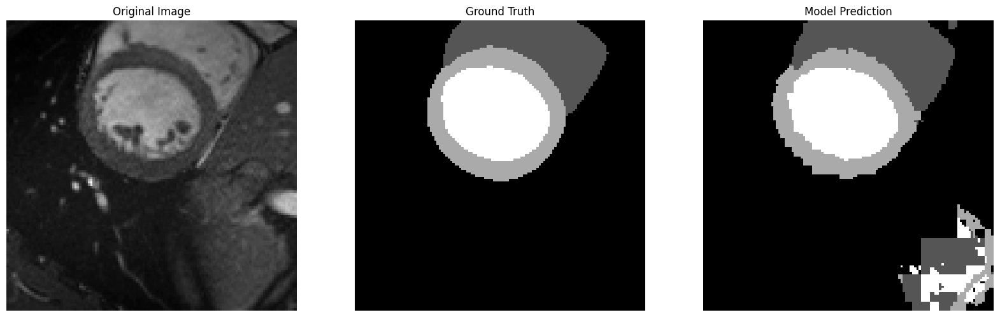

Model 2 Prediction:


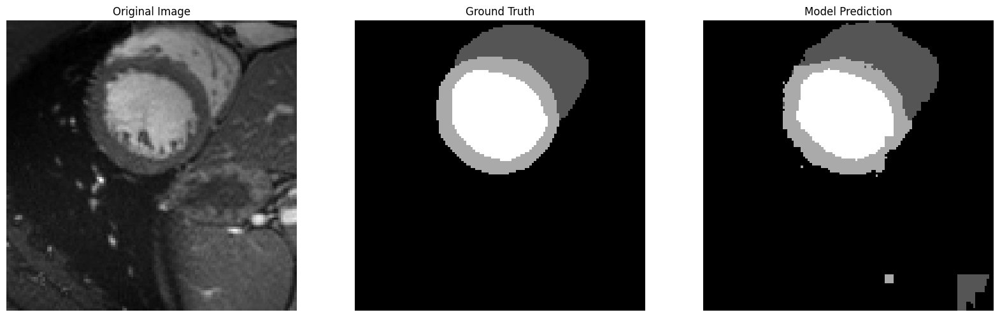

Model 2 Prediction:


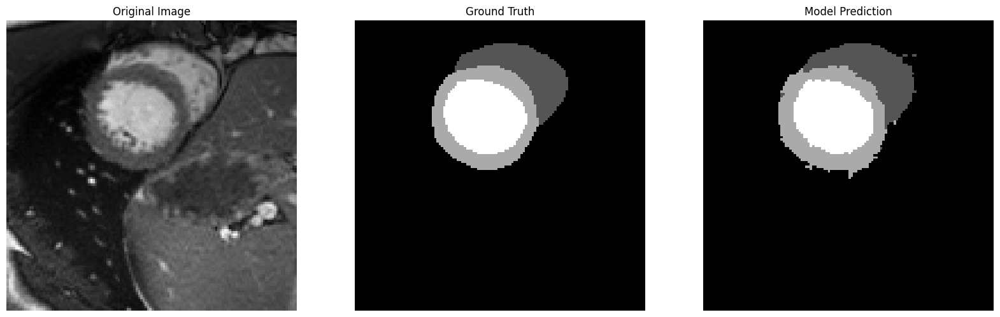

Model 2 Prediction:


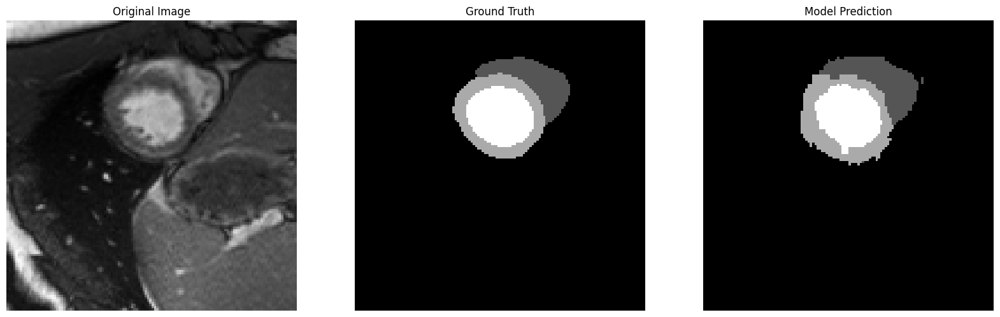

Model 2 Prediction:


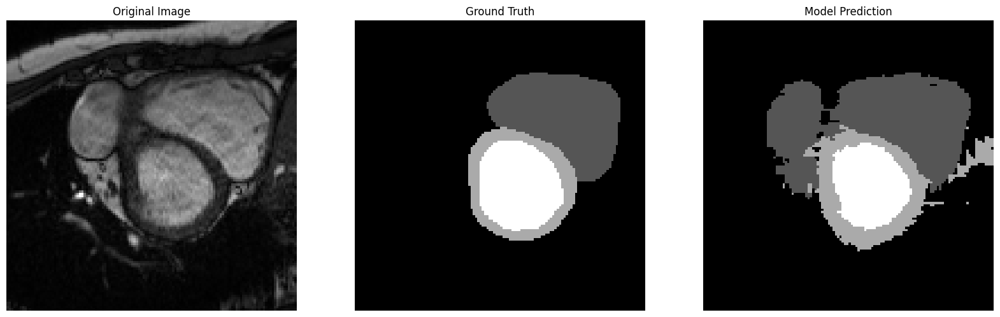

Model 2 Prediction:


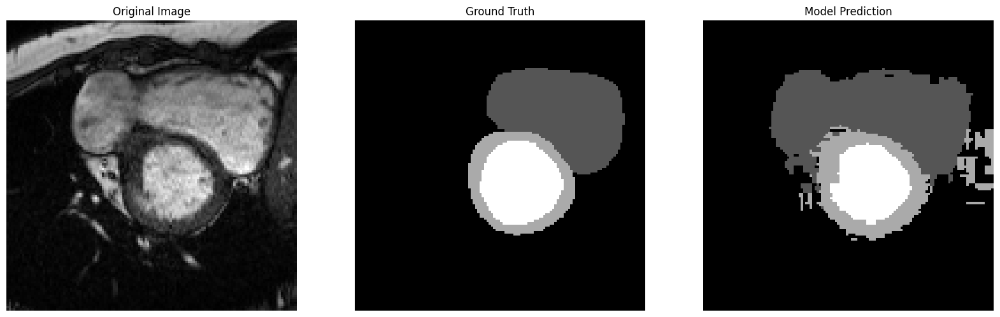

Model 2 Prediction:


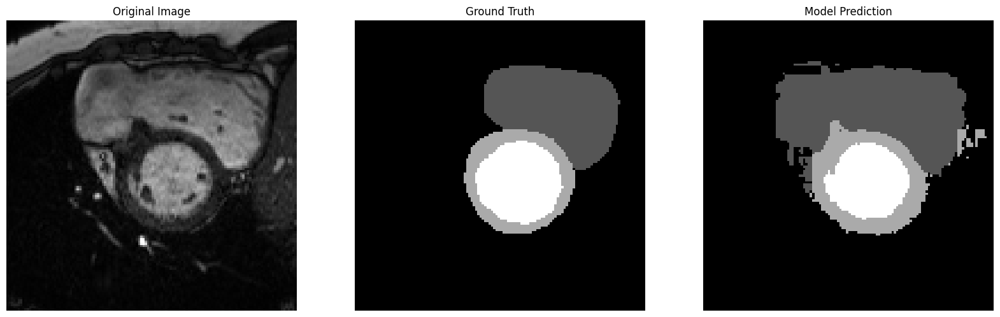

Model 2 Prediction:


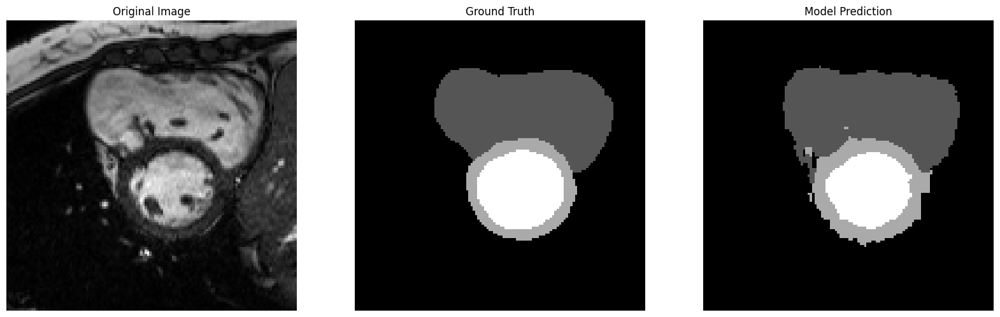

Model 2 Prediction:


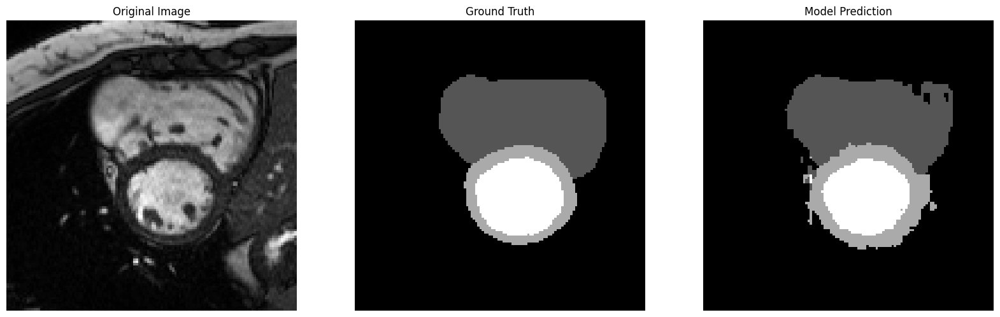

Model 2 Prediction:


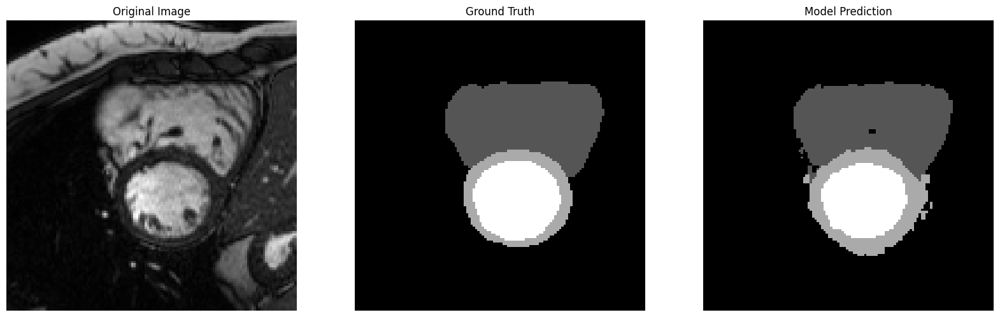

Model 2 Prediction:


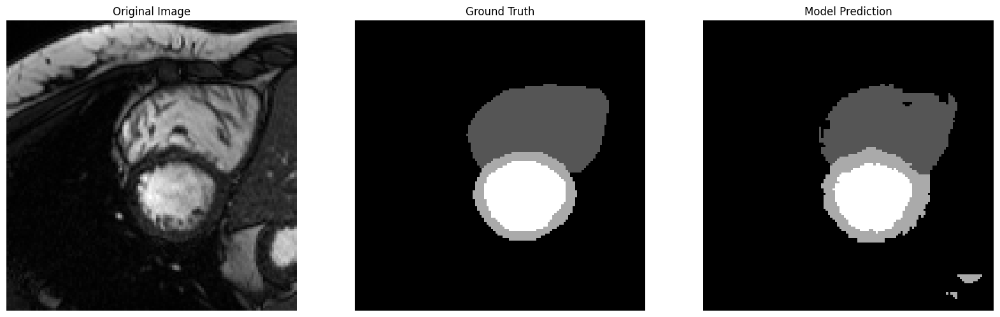

Model 2 Prediction:


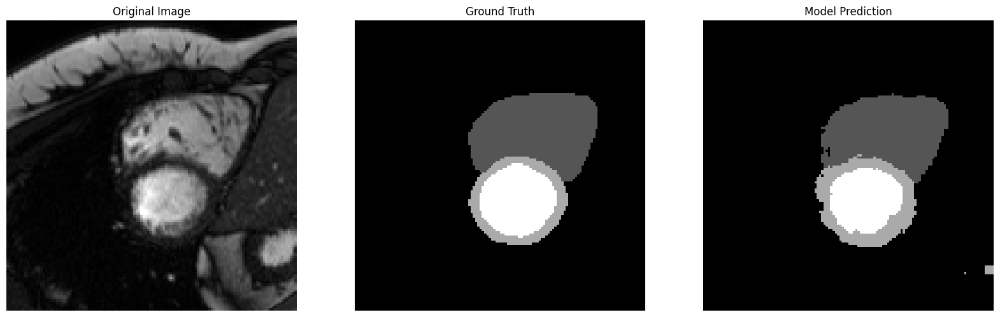

Model 2 Prediction:


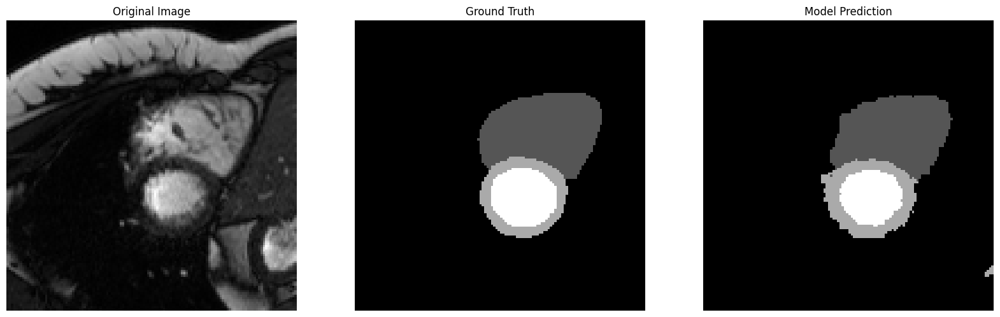

Model 2 Prediction:


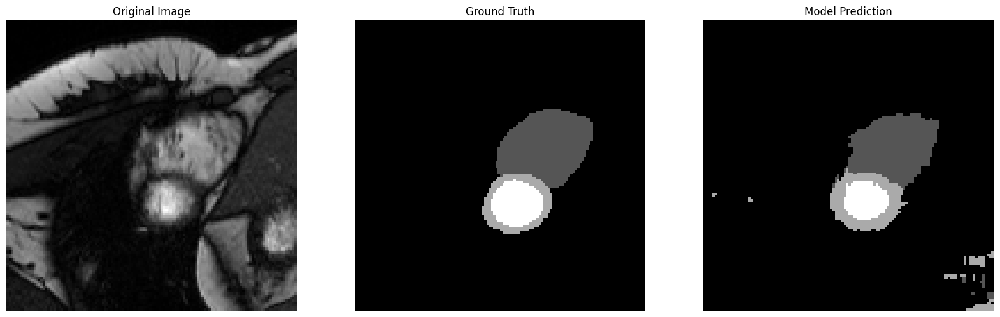

Model 2 Prediction:


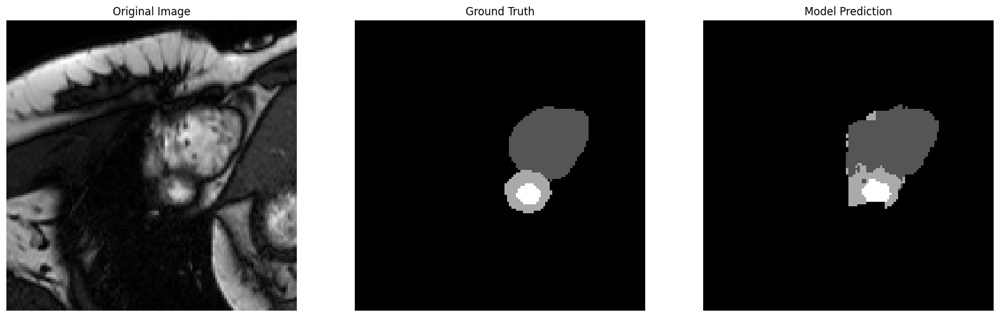

Model 2 Prediction:


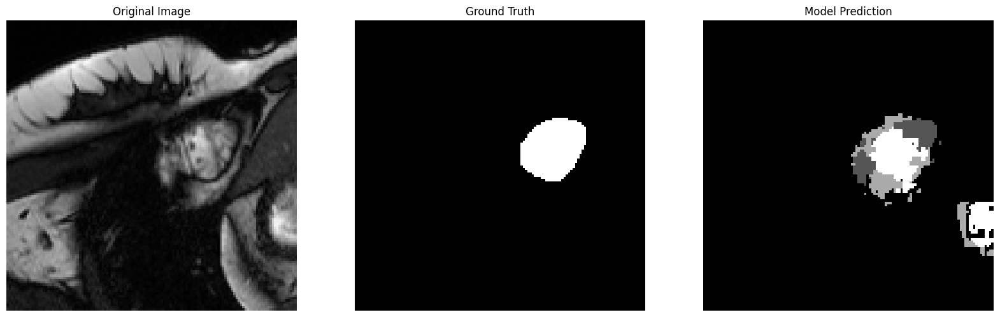

Model 2 Prediction:


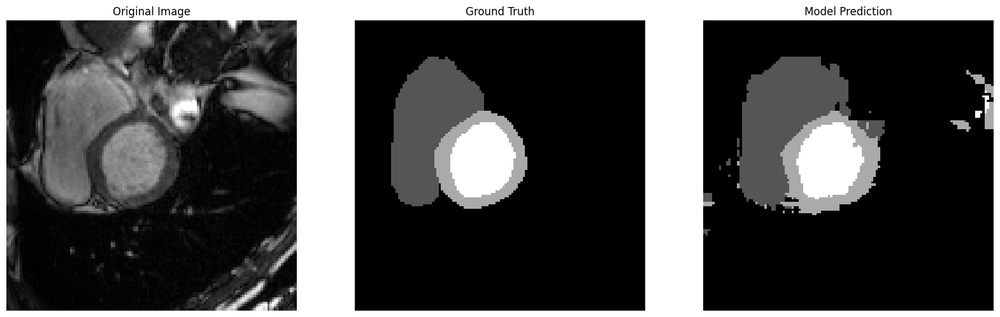

Model 2 Prediction:


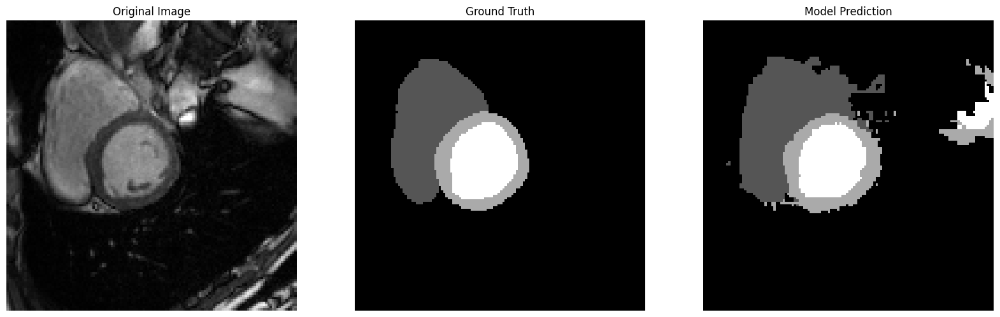

Model 2 Prediction:


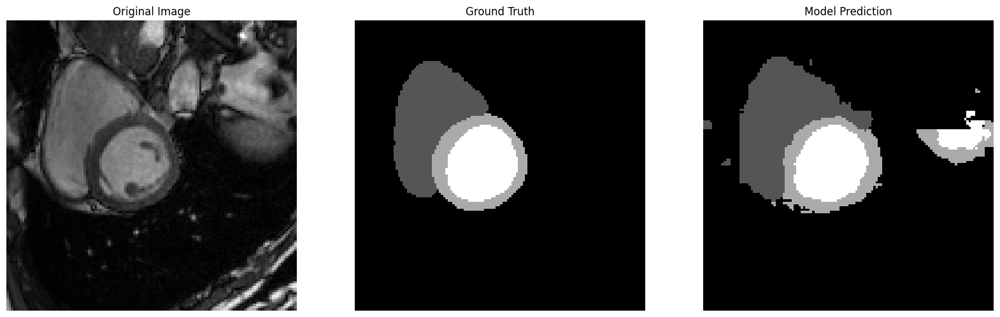

Model 2 Prediction:


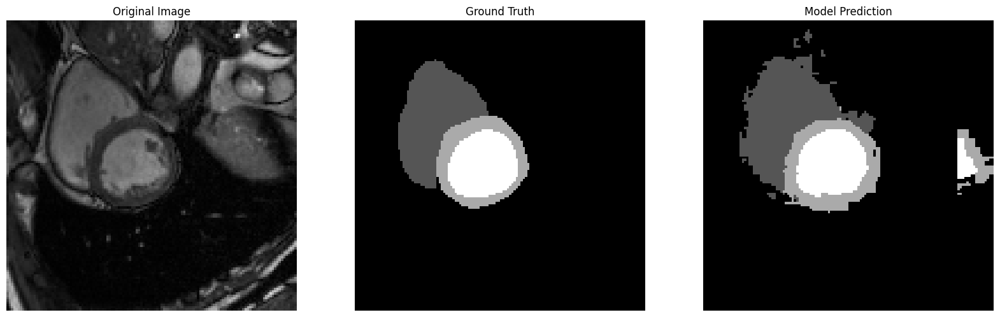

Model 2 Prediction:


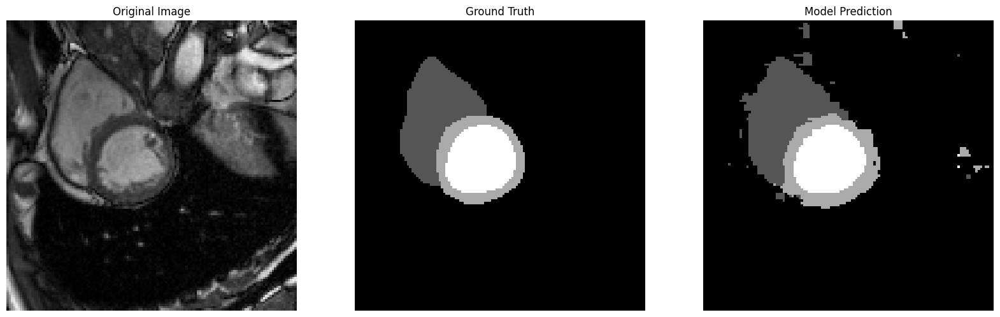

Model 2 Prediction:


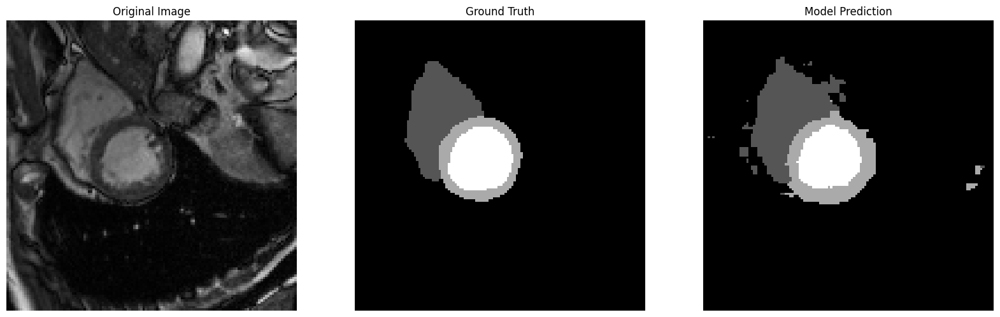

Model 2 Prediction:


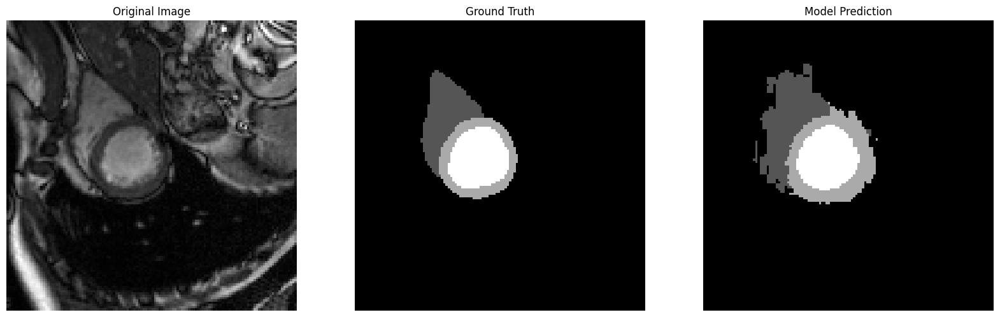

Model 2 Prediction:


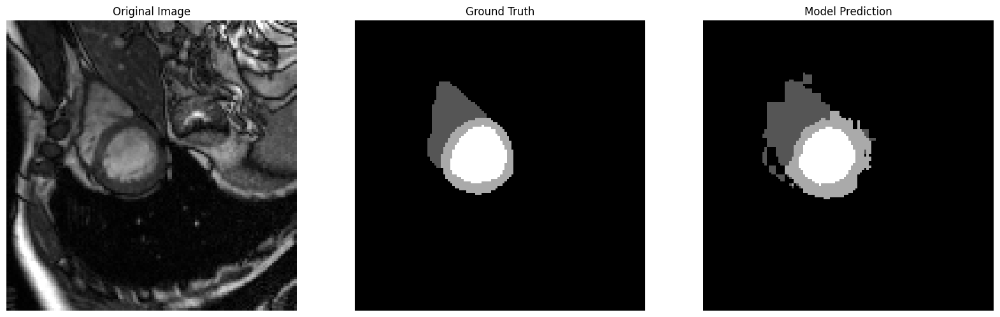

Model 2 Prediction:


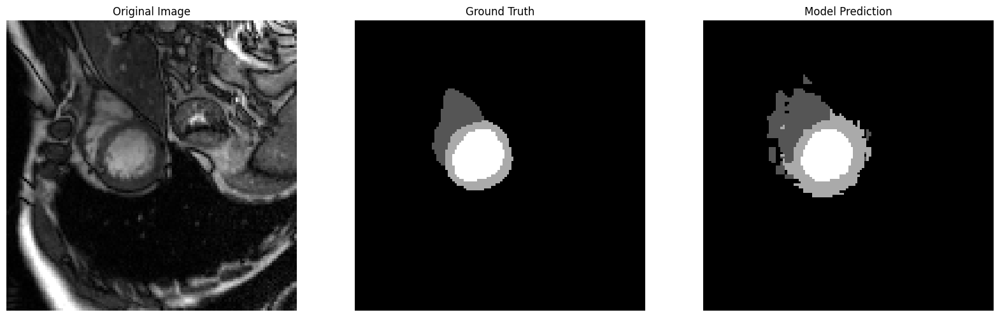

Model 2 Prediction:


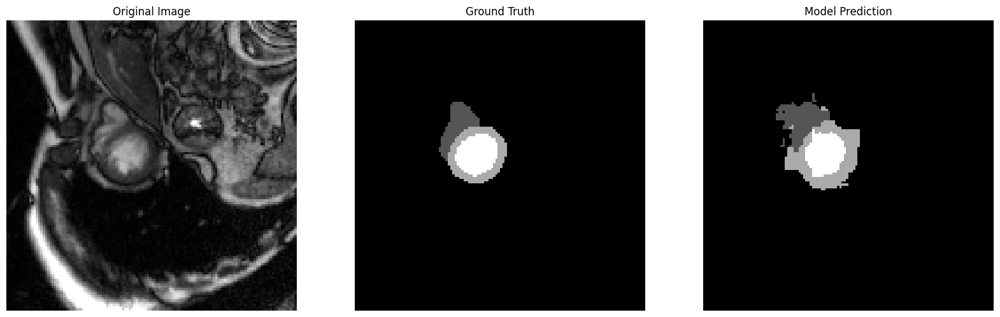

Model 2 Prediction:


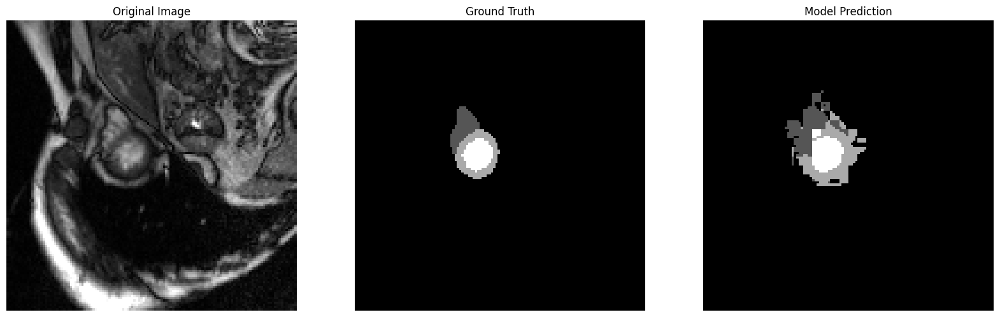

Model 2 Prediction:


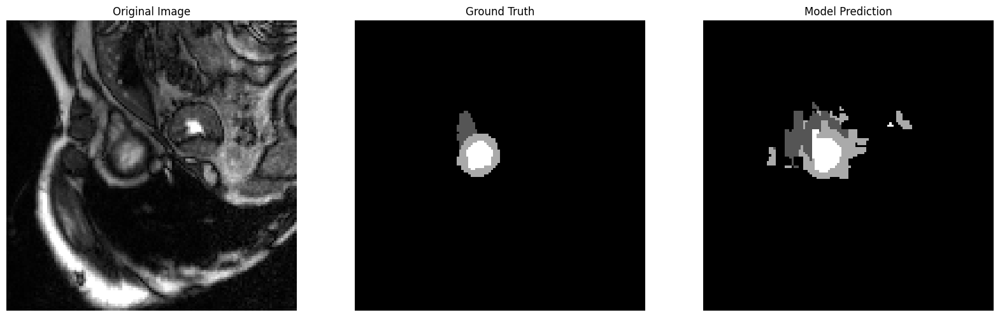

Model 2 Prediction:


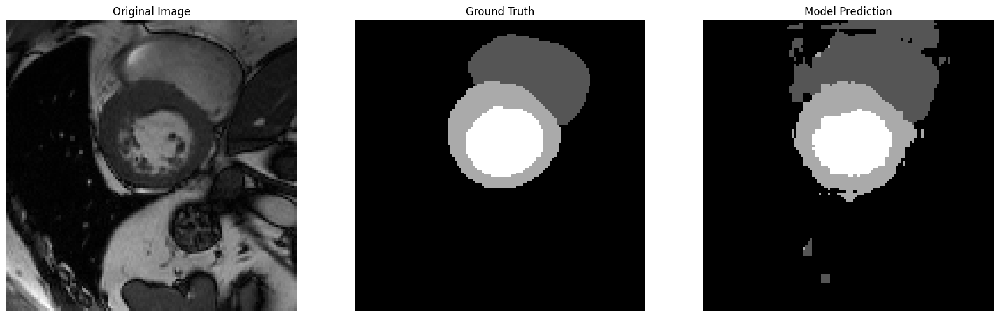

Model 2 Prediction:


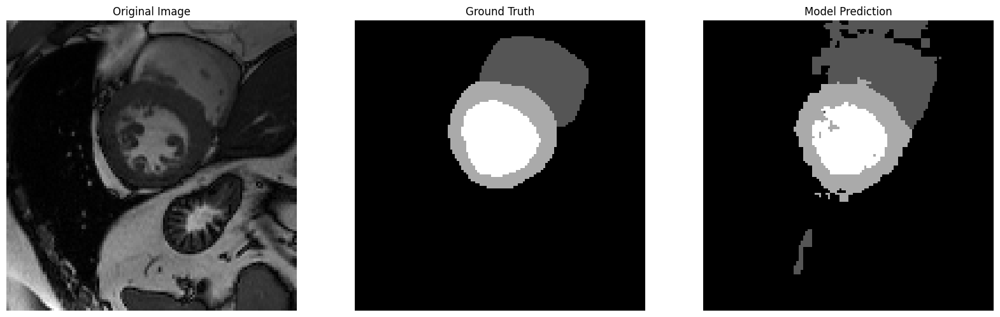

Model 2 Prediction:


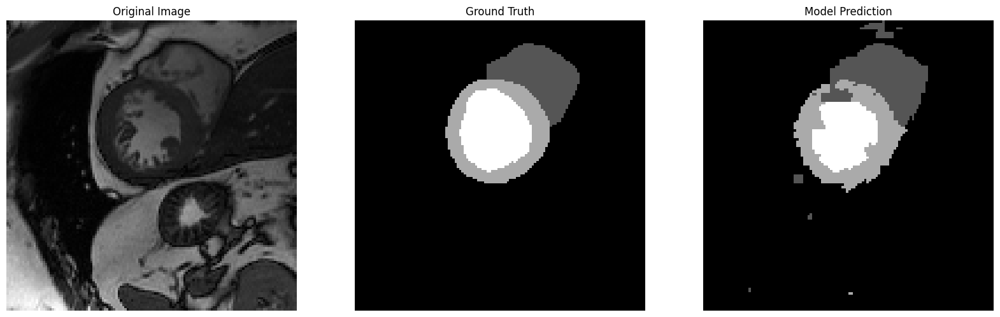

Model 2 Prediction:


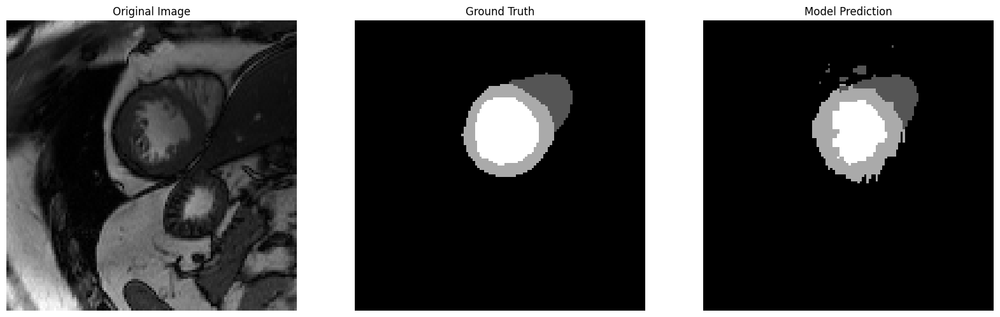

Model 2 Prediction:


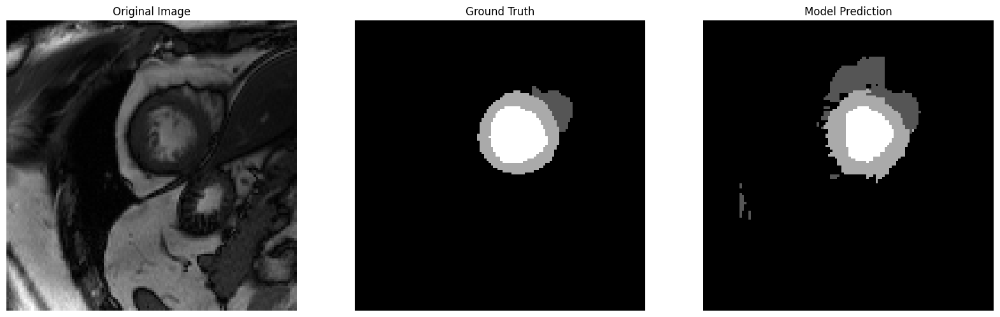

Model 2 Prediction:


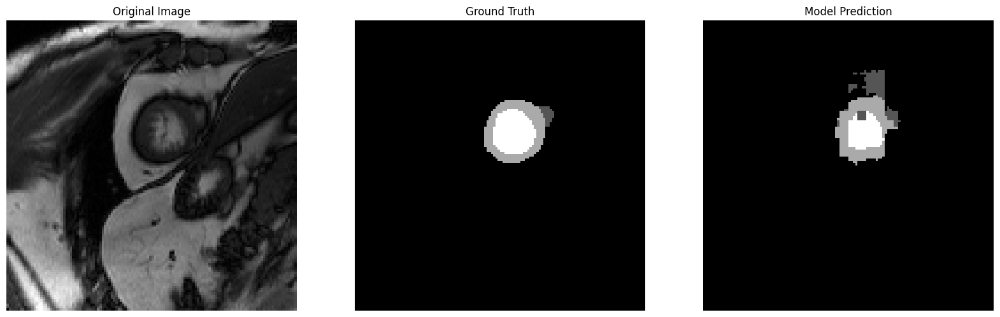

Model 2 Prediction:


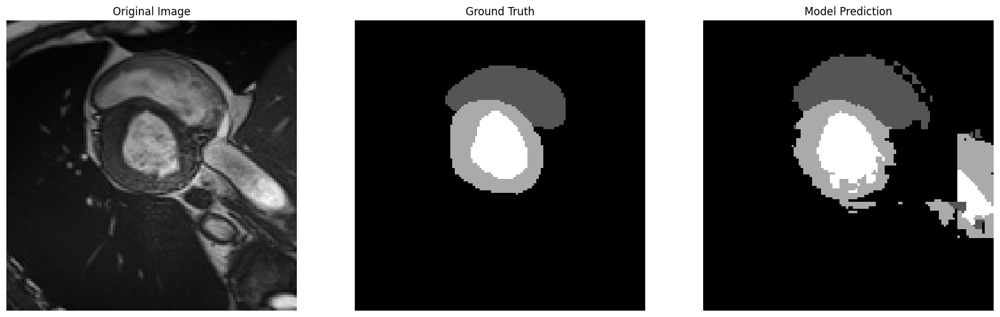

Model 2 Prediction:


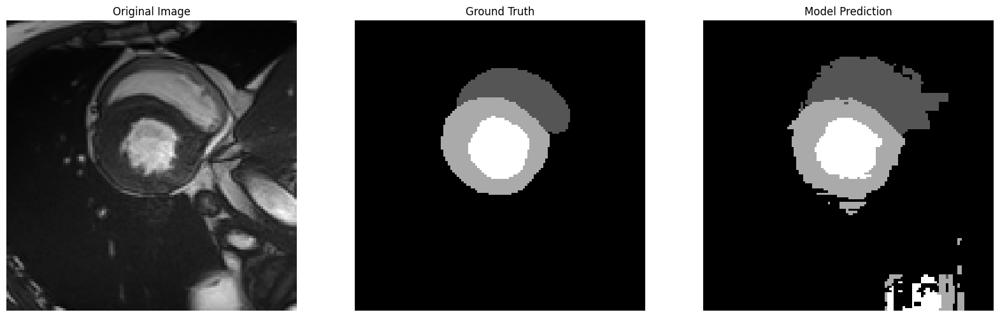

Model 2 Prediction:


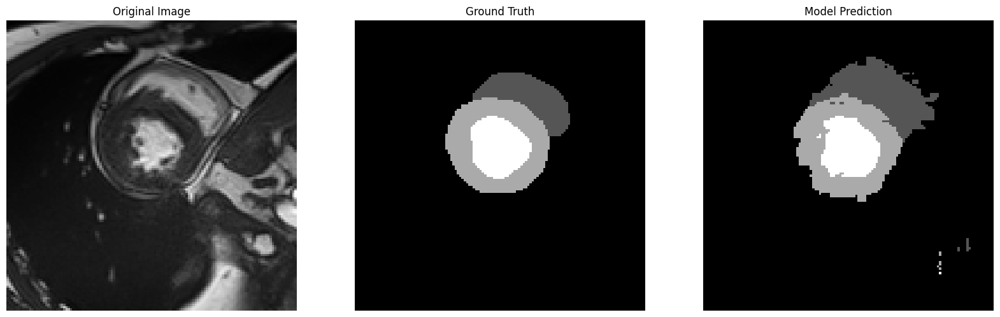

Model 2 Prediction:


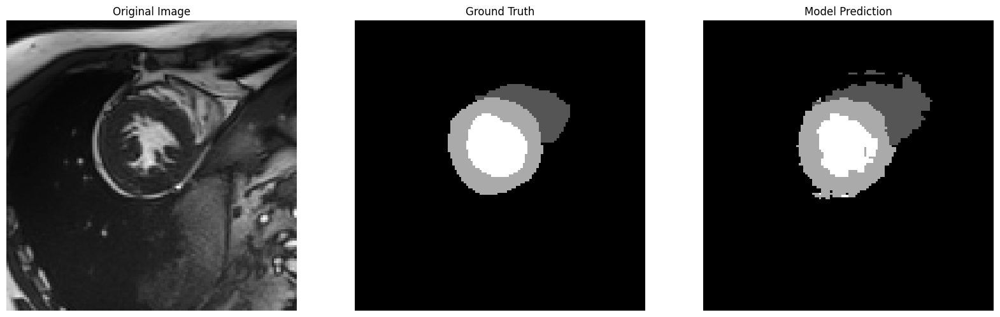

Model 2 Prediction:


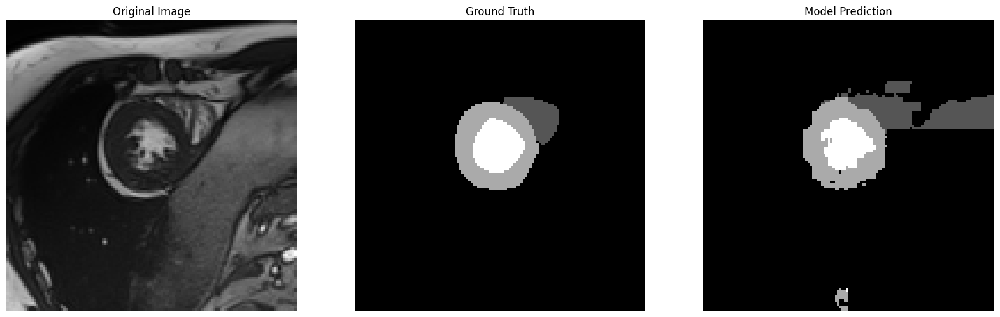

Model 2 Prediction:


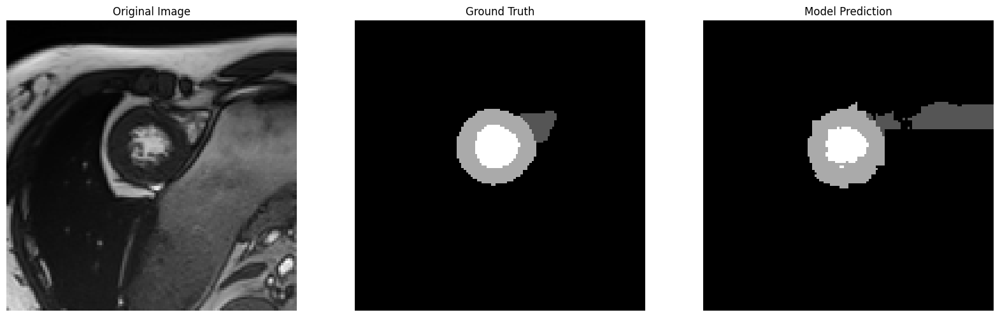

Model 2 Prediction:


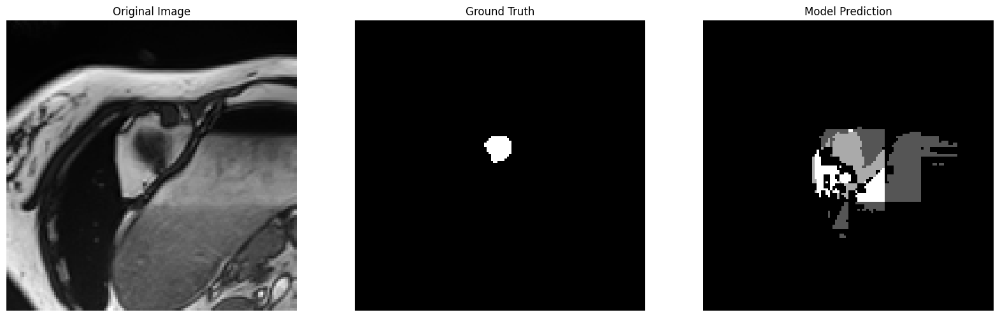

Model 2 Prediction:


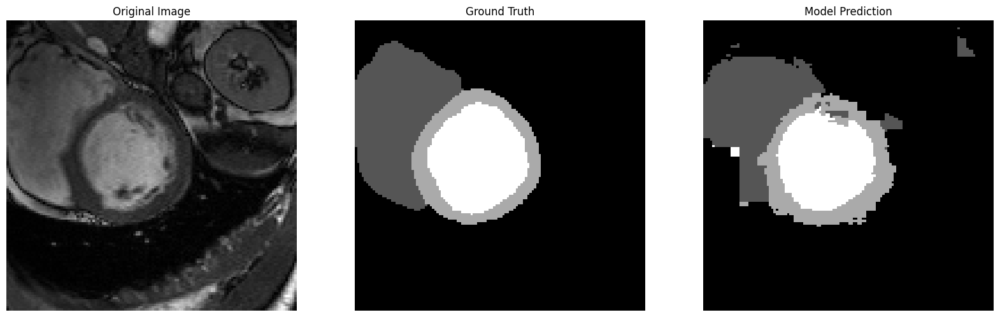

Model 2 Prediction:


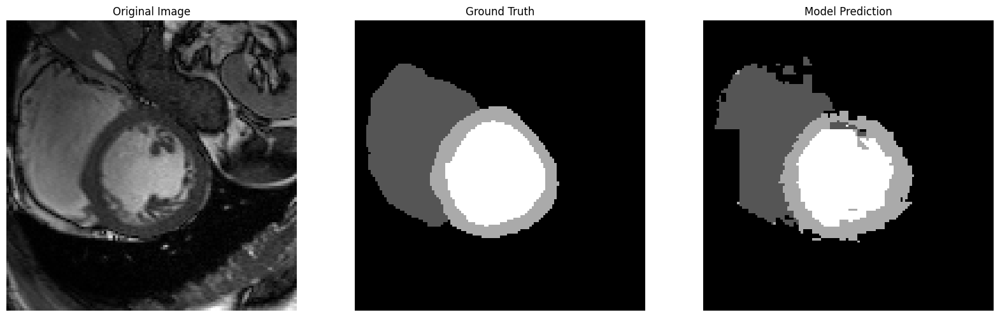

Model 2 Prediction:


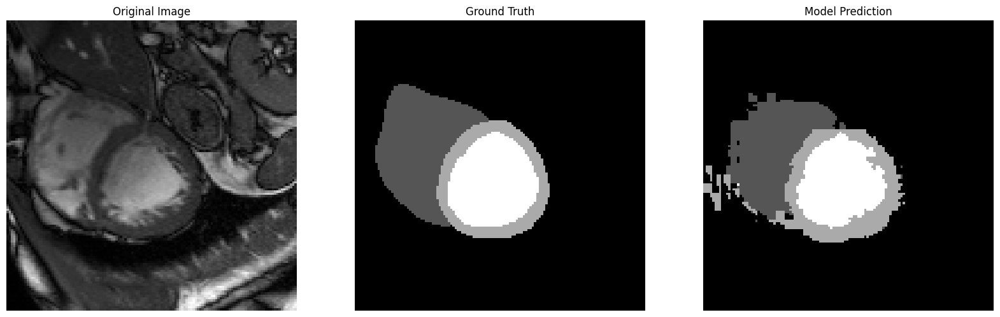

Model 2 Prediction:


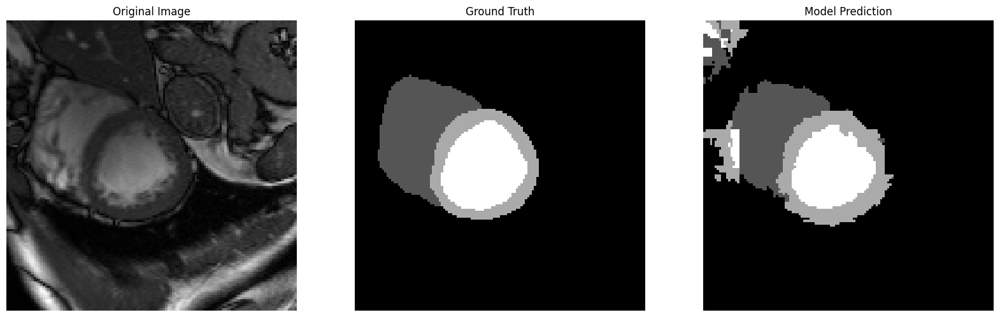

Model 2 Prediction:


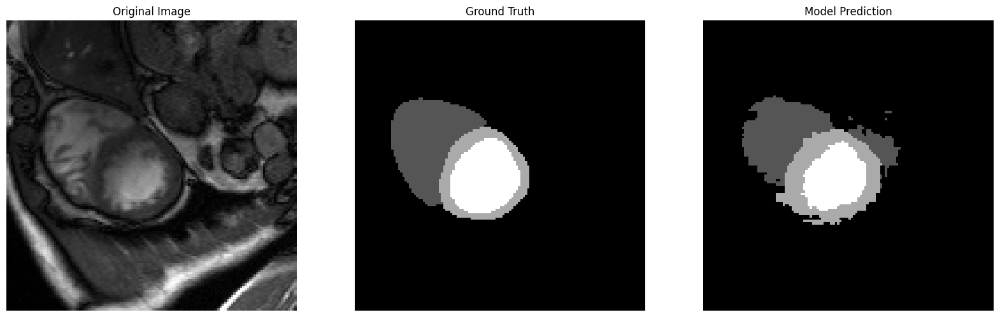

Model 2 Prediction:


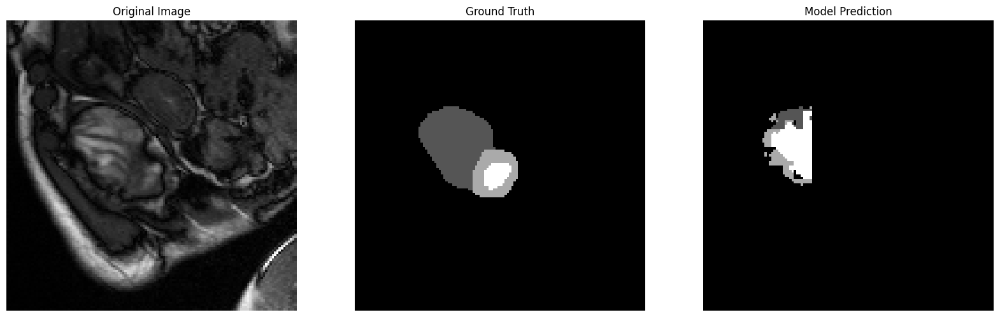

Model 2 Prediction:


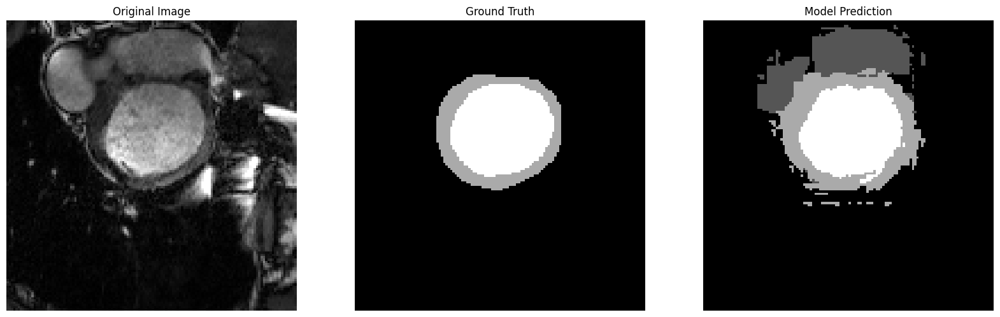

Model 2 Prediction:


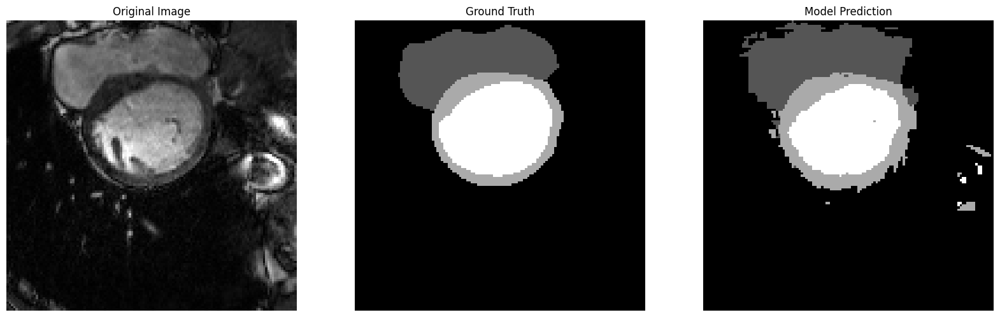

Model 2 Prediction:


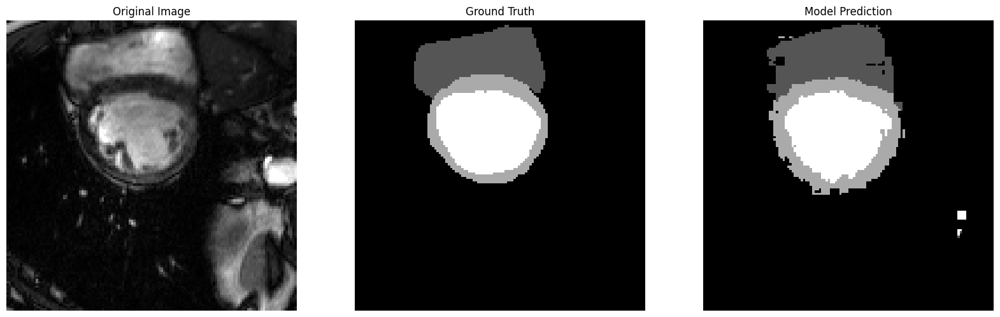

Model 2 Prediction:


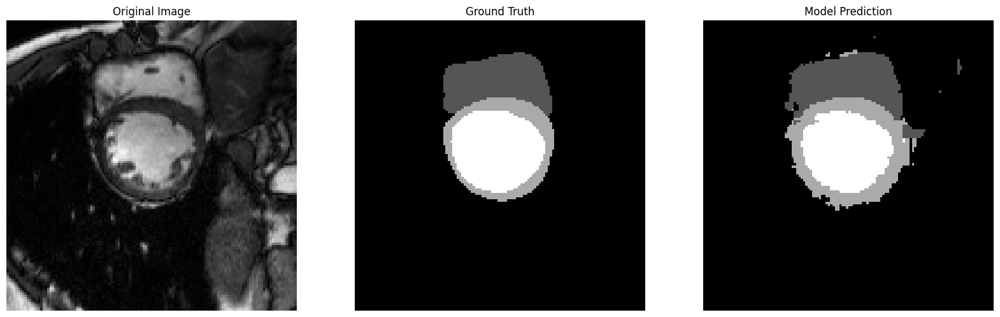

Model 2 Prediction:


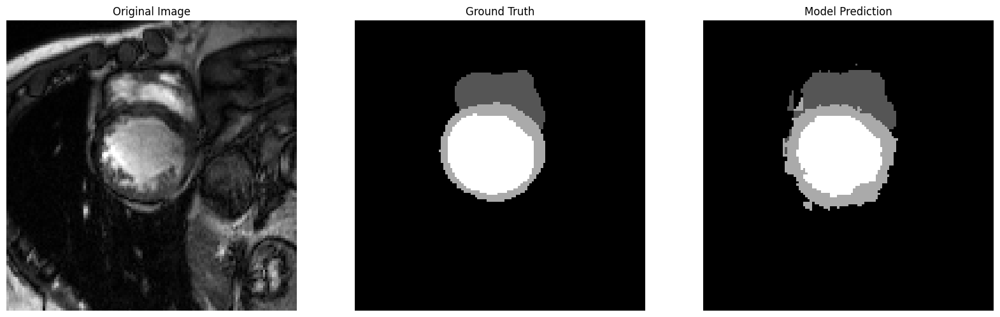

Model 2 Prediction:


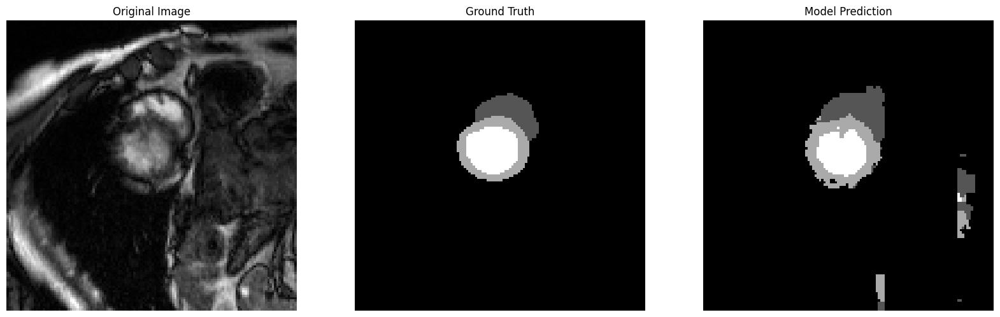

Model 2 Prediction:


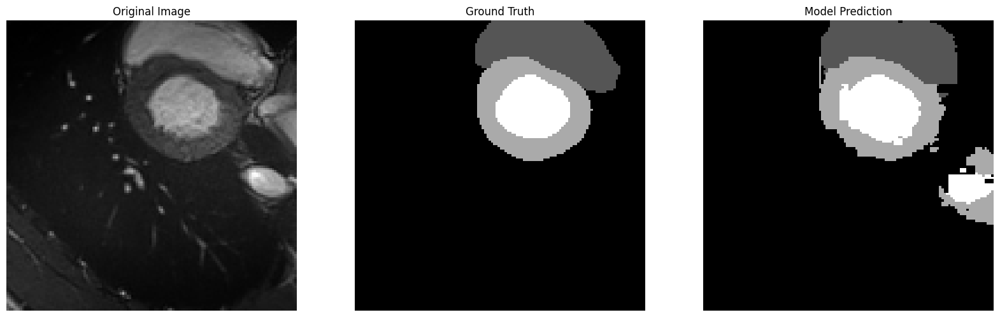

Model 2 Prediction:


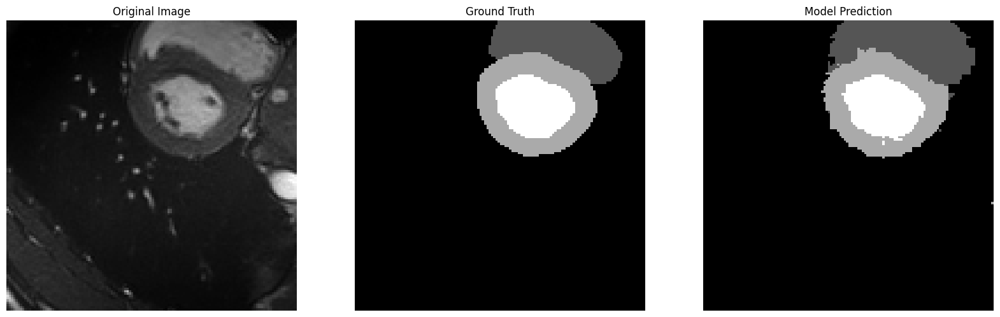

Model 2 Prediction:


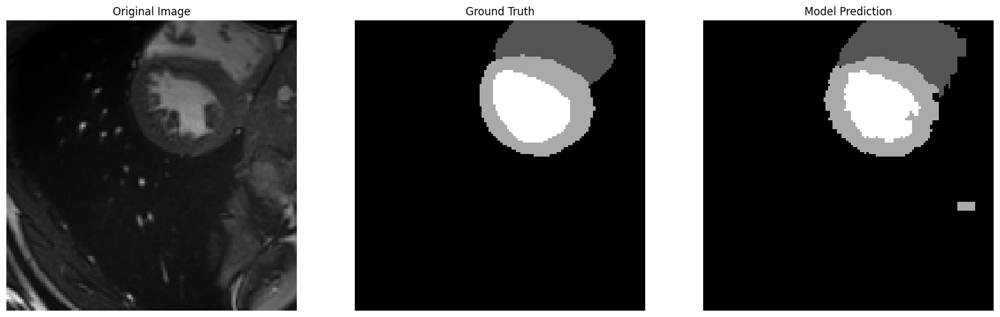

Model 2 Prediction:


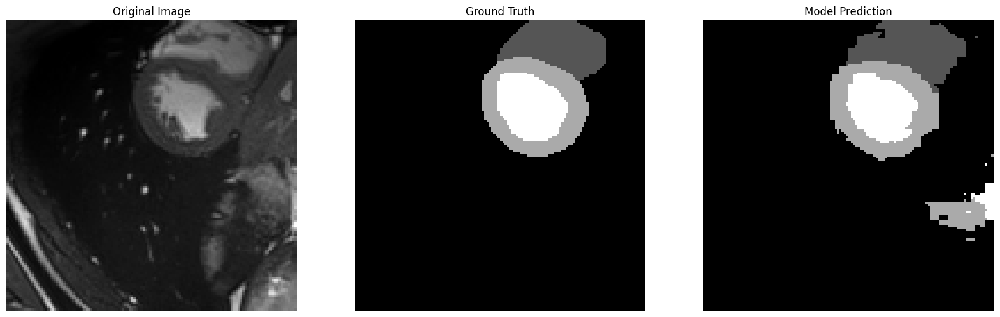

Model 2 Prediction:


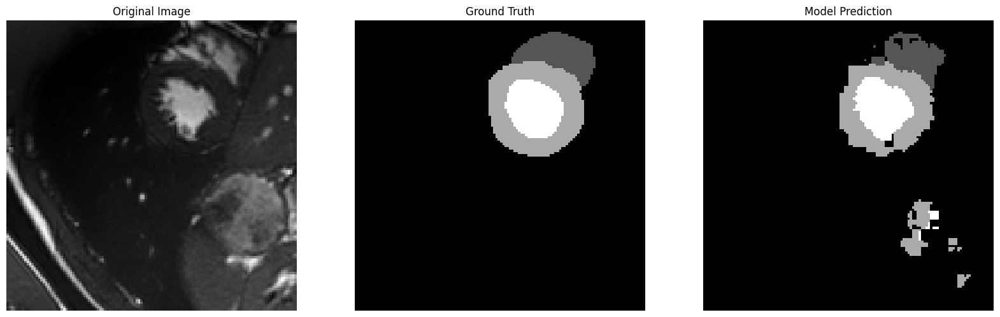

Model 2 Prediction:


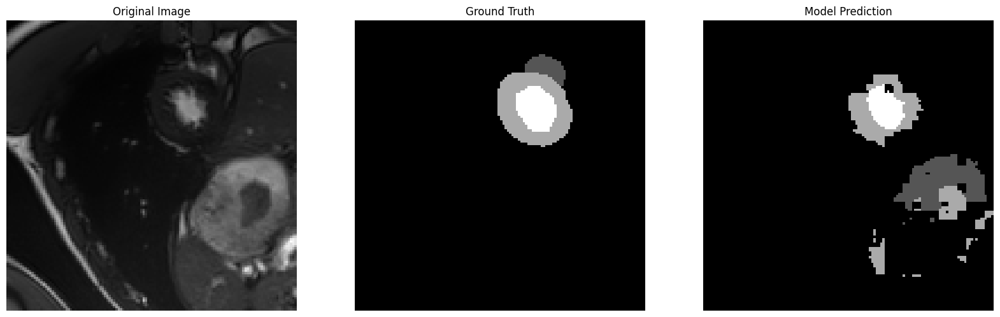

Model 2 Prediction:


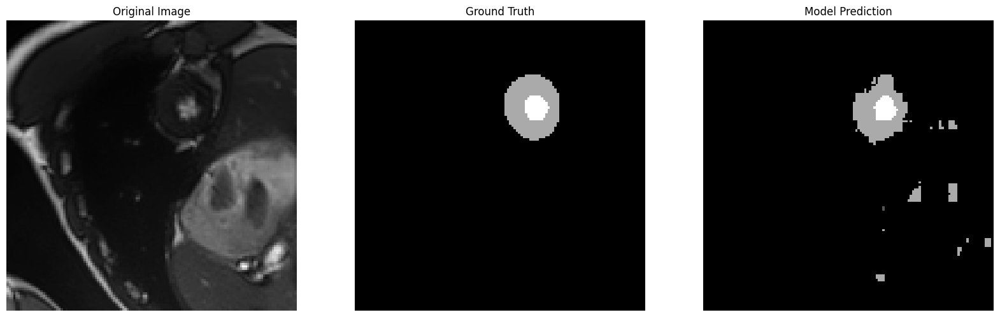

Model 2 Prediction:


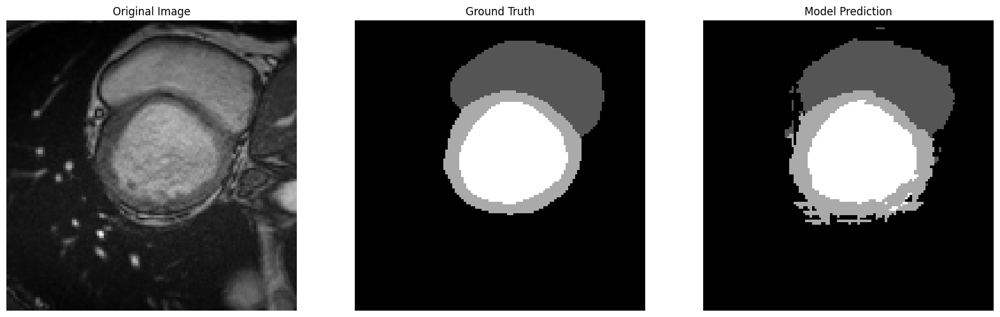

Model 2 Prediction:


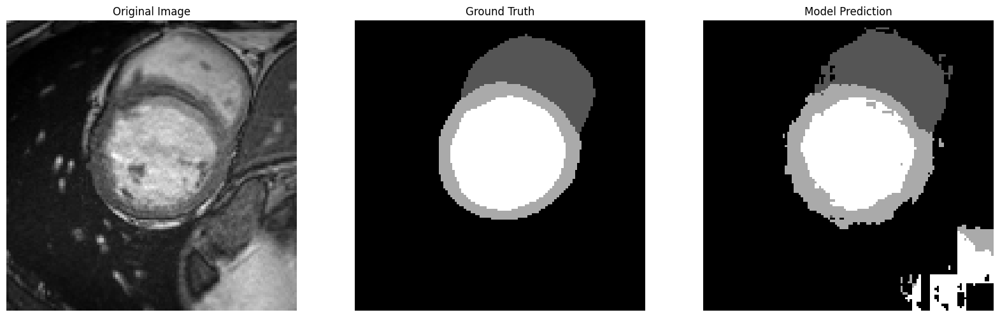

Model 2 Prediction:


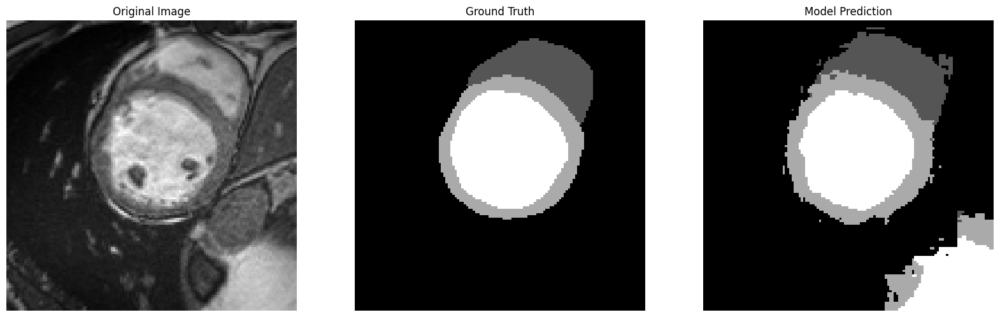

Model 2 Prediction:


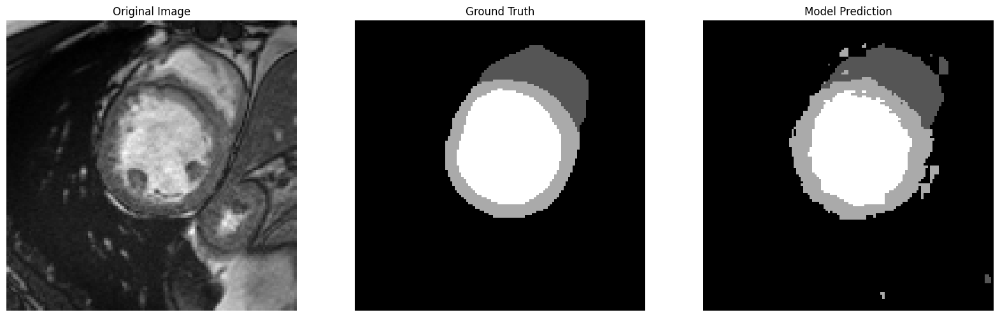

Model 2 Prediction:


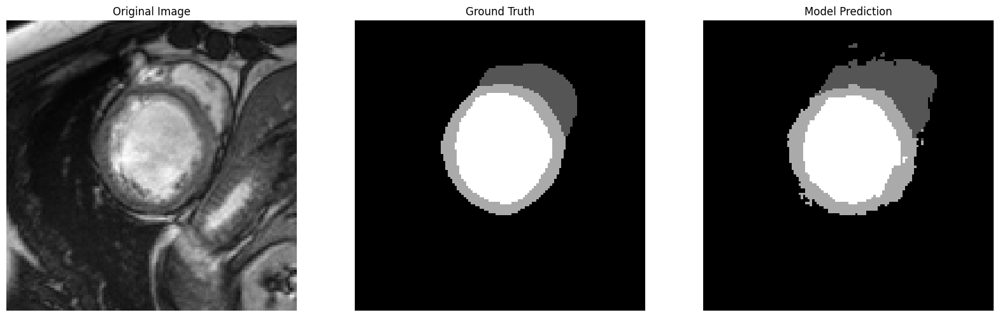

Model 2 Prediction:


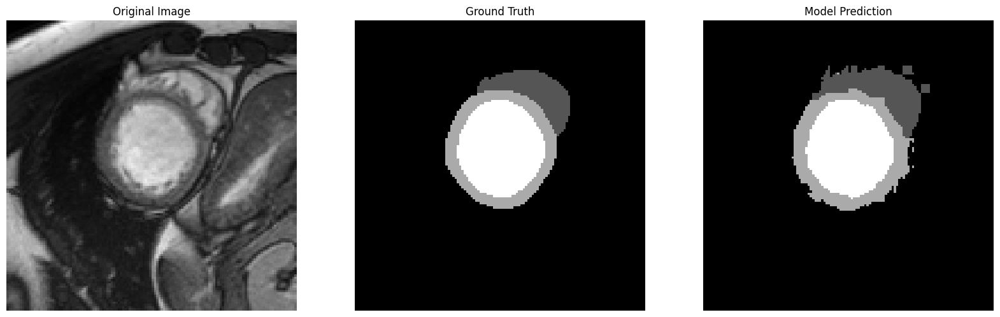

Model 2 Prediction:


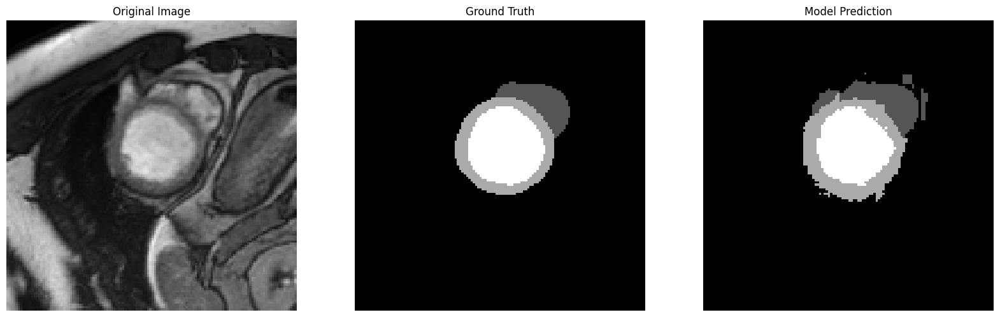

Model 2 Prediction:


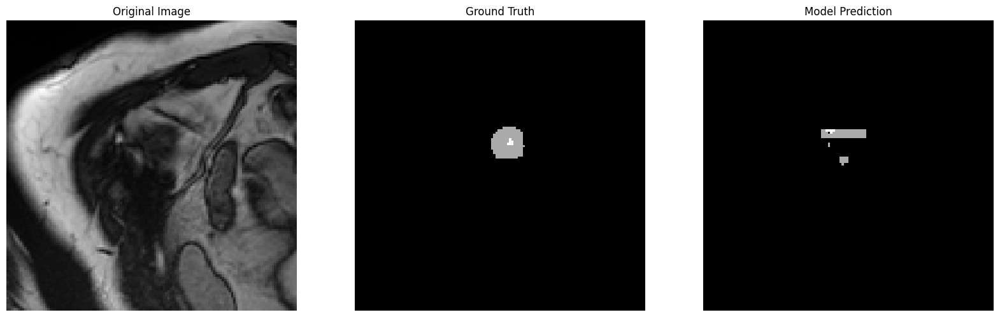

Model 2 Prediction:


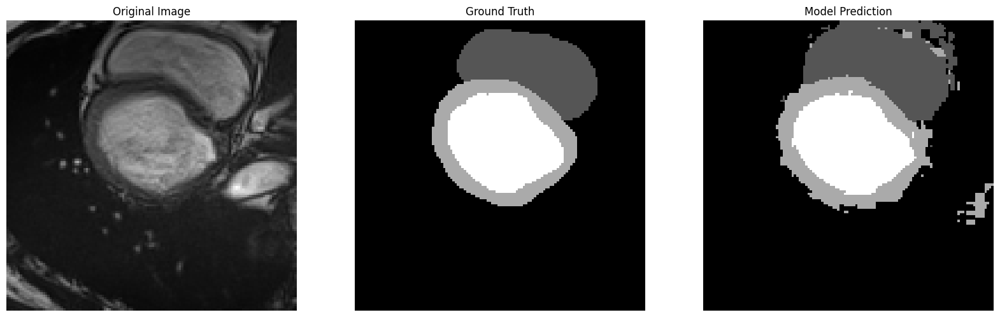

Model 2 Prediction:


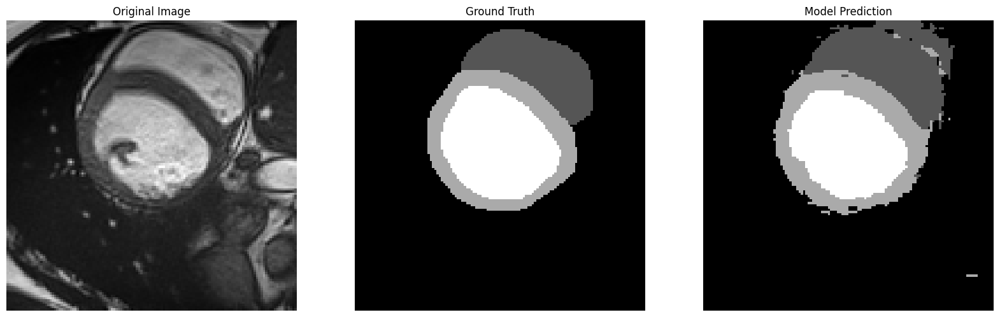

Model 2 Prediction:


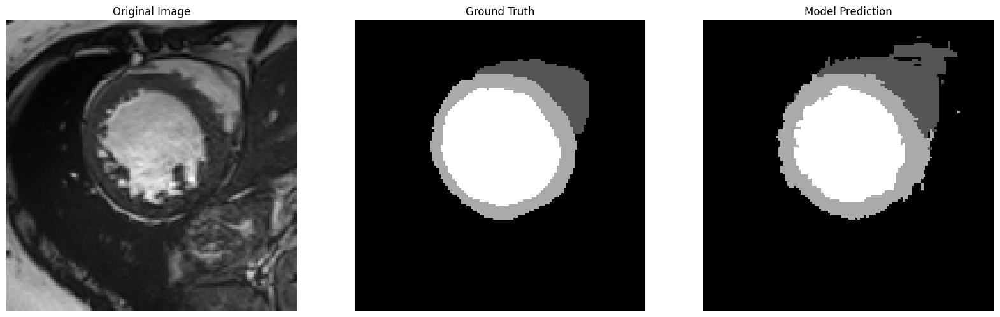

Model 2 Prediction:


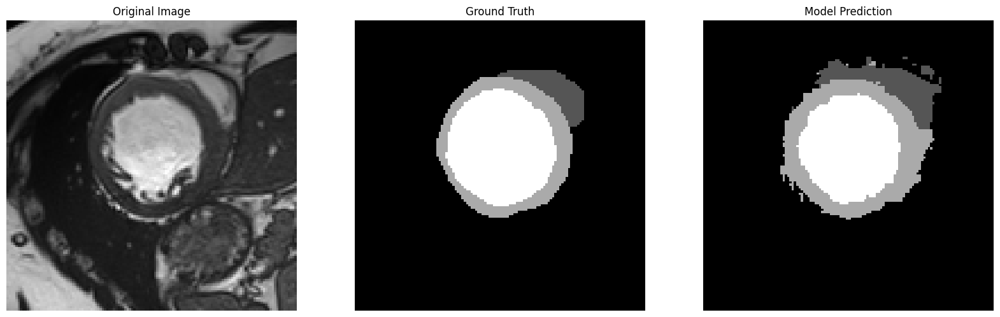

Model 2 Prediction:


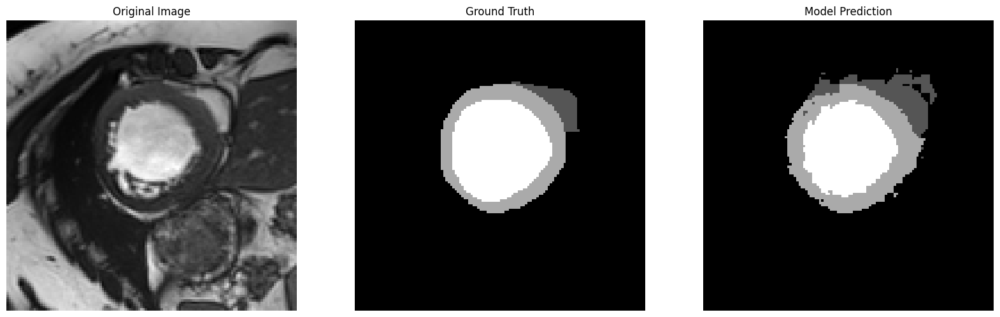

Model 2 Prediction:


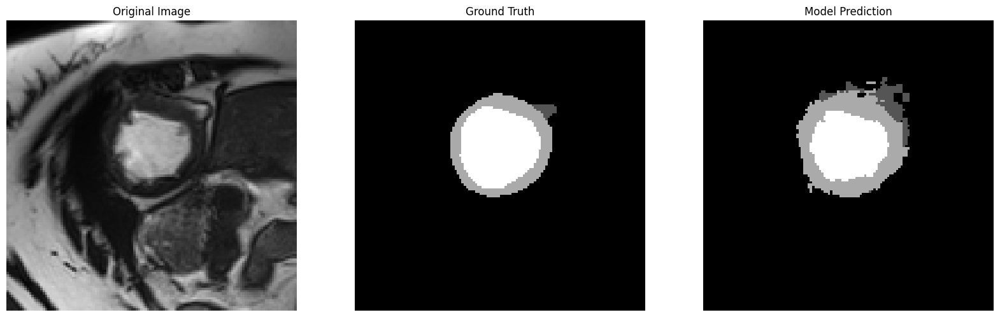

Model 2 Prediction:


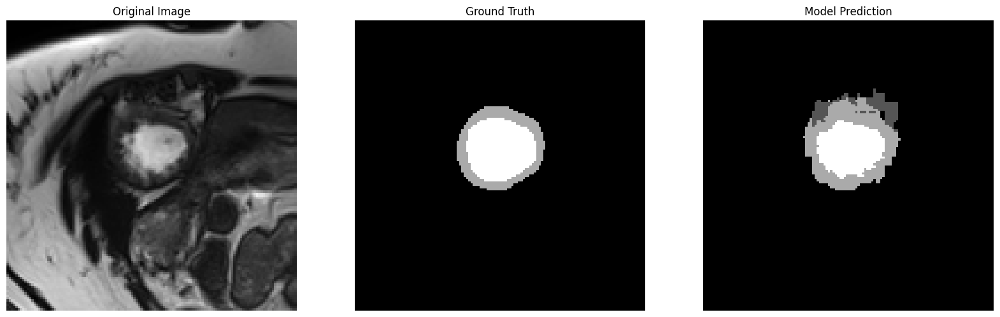

Model 2 Prediction:


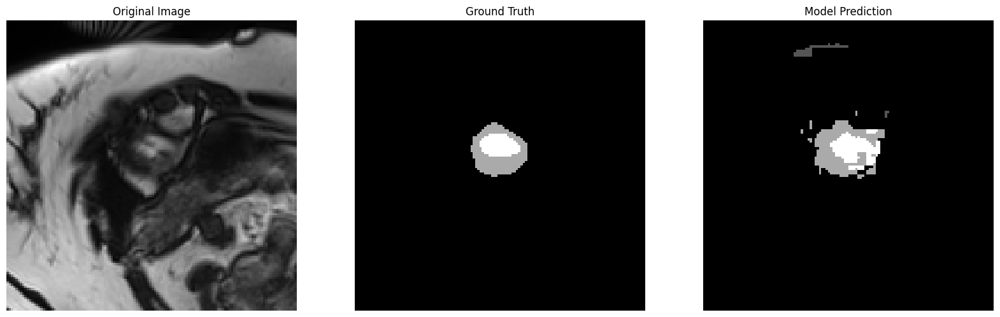

In [ ]:
def visualize_predictions(image, mask, prediction):
    fig, axs = plt.subplots(1, 3, figsize=(20, 20))

    axs[0].imshow(image.cpu().squeeze().numpy(), cmap='gray')
    axs[0].set_title('Original Image')

    axs[1].imshow(mask.cpu().squeeze().numpy(), cmap='gray')
    axs[1].set_title('Ground Truth')

    axs[2].imshow(prediction.cpu().squeeze().numpy(), cmap='gray')
    axs[2].set_title('Model Prediction')

    for ax in axs:
        ax.axis('off')

    plt.show()

# Load the best model
model2.load_state_dict(torch.load(SAVE_PATH_SWIN, map_location=torch.device('cpu')))

model2.eval()

with torch.no_grad():
    for images, masks in val_dataloader:
        images, masks = images.to(device), masks.to(device)

        outputs2, *_ = model2(images)
        #prediction2 = outputs2
        prediction2 = torch.argmax(outputs2, dim=1)

        # Just visualize for the first few samples in the batch
        for i in range(min(3, images.size(0))):

            print("Model 2 Prediction:")
            visualize_predictions(images[i], masks[i], prediction2[i])

## F. Feature-level Cross Teaching b/w UNet and SwinUNet

### Data Loading

In [ ]:
class TwoStreamBatchSampler:
    def __init__(self, labeled_idxs, unlabeled_idxs, batch_size, unlabeled_batch_size):
        self.labeled_idxs = labeled_idxs
        self.unlabeled_idxs = unlabeled_idxs
        self.batch_size = batch_size
        self.unlabeled_batch_size = unlabeled_batch_size

        self.labeled_batch_size = self.batch_size - self.unlabeled_batch_size

    def __iter__(self):
        labeled_iter = iter(self.labeled_idxs)
        unlabeled_iter = iter(self.unlabeled_idxs)

        while True:
            batch = []
            for _ in range(self.labeled_batch_size):
                try:
                    batch.append(next(labeled_iter))
                except StopIteration:
                    break

            for _ in range(self.unlabeled_batch_size):
                try:
                    batch.append(next(unlabeled_iter))
                except StopIteration:
                    break

            if not batch:
                break  # No more data

            yield batch

    def __len__(self):
        return (len(self.labeled_idxs) + len(self.unlabeled_idxs)) // self.batch_size

batch_size = 16
labelled_batch_size = 8

total_slices = len(train_dataset)
labelled_slices = (1*len(train_dataset)) // 3 #Experiment

labeled_idxs = list(range(0, labelled_slices))
unlabeled_idxs = list(range(labelled_slices, total_slices))
batch_sampler = TwoStreamBatchSampler(labeled_idxs, unlabeled_idxs, batch_size=batch_size, unlabeled_batch_size=batch_size - labelled_batch_size)

# Create the dataloader
train_dataloader = DataLoader(train_dataset, sampler=SubsetRandomSampler(labeled_idxs), batch_size=16, num_workers=2)
train_semsup_dataloader = DataLoader(train_dataset, batch_sampler=batch_sampler, num_workers=2)
val_dataloader = DataLoader(val_dataset, batch_size=4, num_workers=2)

In [ ]:
from custom_networks.unet import UNet
from custom_networks.vision_transformer import SwinUnet

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

#### Model 1 - UNet ##########
model1 = UNet(in_chns=1, class_num=4)
model1 = model1.to(device)

#### Model 2 - Swin UNet ##########

# Swin Transformer parameters
swin_config = argparse.Namespace(
    PATCH_SIZE = 4, #4
    IN_CHANS = 3,
    EMBED_DIM = 96,
    DEPTHS = [4, 4, 10, 4],
    DECODER_DEPTHS =  [4, 4, 10, 4],
    NUM_HEADS = [4, 8, 16, 32],
    WINDOW_SIZE = 8,
    MLP_RATIO = 4,
    QKV_BIAS = True,
    QK_SCALE = None,
    APE = False,
    PATCH_NORM = True,
    FINAL_UPSAMPLE= "expand_first",
    DROP_RATE = 0.0,
    DROP_PATH_RATE = 0.1,
    USE_CHECKPOINT = False
)
pretrained_swinunet_path = "/content/drive/MyDrive/saved_models/best_model_swin_16bs_finetune.pth" #Fine tune previous - 112 epochs 0.17 validation loss
model2 = SwinUnet(swin_config, img_size=128, num_classes=4)
checkpoint = torch.load(pretrained_swinunet_path, map_location=torch.device('cpu'))
model2.load_state_dict(checkpoint)
model2 = model2.to(device)

dice_metric1 = DiceMetric(include_background=True, reduction="mean")
iou_metric1 = MeanIoU(include_background = True, reduction ="mean")
dice_metric2 = DiceMetric(include_background=True, reduction="mean")
iou_metric2 = MeanIoU(include_background = True, reduction ="mean")

## Loss, Optimizers, Metrics
optimizer1 = optim.AdamW(model1.parameters(), lr=0.003, weight_decay=0.0001)
optimizer2 = optim.AdamW(model2.parameters(), lr=0.003, weight_decay=0.0001)
ce_loss = CrossEntropyLoss(weight=weights_normalized).to(device)
dice_loss = losses.DiceLoss(4).to(device)

SwinTransformerSys expand initial----depths:[4, 4, 10, 4];depths_decoder:[1, 2, 2, 2];drop_path_rate:0.1;num_classes:4
---final upsample expand_first---


### Feature Adaptation Layer

In [ ]:
class ConvFeatureAdaptation(nn.Module):
    def __init__(self):
        super(ConvFeatureAdaptation, self).__init__()
        self.conv1 = nn.Conv2d(128, 196, kernel_size=1, stride=1, padding=0)
        self.conv2 = nn.Conv2d(196, 196, kernel_size=3, stride=2, padding=1)
        self.conv3 = nn.Conv1d(196, 384, kernel_size=1, stride=1, padding=0)  # Notice Conv1d

    def forward(self, x):
        x = self.conv1(x)
        x = self.conv2(x)

        # Reshape [B, C, H, W] to [B, C, H*W]
        B, C, H, W = x.size()
        x = x.reshape(B, C, H*W)

        x = self.conv3(x)
        # Transpose to get [B, C, H*W] - might not be needed now, but keep it in case you change the order in the future
        x = x.transpose(1, 2)
        return x

# Instantiate the layer
adaptation_layer = ConvFeatureAdaptation().to(device)

### Rampup and Cosine Similarity Util Functions

In [ ]:
def generate_pseudo_feature_map(feature_map, percentile=95):
    """
    Generate pseudo feature map by keeping top X% of activations.

    Args:
    - feature_map (torch.Tensor): The original feature map from the model.
    - percentile (int): The percentile of activations to keep.

    Returns:
    - torch.Tensor: The pseudo feature map.
    """
    # Calculate the threshold value for the given percentile
    threshold = torch.quantile(feature_map, percentile / 100.0)

    # Convert feature map to binary form
    pseudo_feature_map = (feature_map >= threshold).float()

    return pseudo_feature_map

def sigmoid_rampup(current, rampup_length=5):
    """Sigmoid rampup function"""
    if rampup_length == 0:
        return 1.0
    else:
        current = float(current)
        rampup = float(rampup_length)
        if current < rampup_length:
            phase = 1.0 - current / rampup
            val = float(math.exp(-5.0 * phase * phase))
            return val
        else:
            return 1.0

def feature_linear_rampup(epoch, scale=1.0, length=10):
    """Ramp-up function for feature-level dice loss."""
    if epoch < length:
        return float(epoch) / float(length) * scale
    else:
        return scale

def cosine_similarity_loss(input, target, eps=1e-8):
    """
    Compute the cosine similarity between input and target tensors
    """
    # Ensure the tensors are flattened
    input_norm = input.reshape(input.size(0), -1)
    target_norm = target.reshape(target.size(0), -1)

    # Normalize the vectors
    input_norm = F.normalize(input_norm, p=2, dim=1)
    target_norm = F.normalize(target_norm, p=2, dim=1)

    # Cosine similarity
    cosine_similarity = torch.sum(input_norm * target_norm, dim=1)

    # Cosine similarity loss
    # We subtract the similarity from 1 to get the loss (1 means completely similar, 0 means orthogonal)
    loss = 1 - cosine_similarity.mean()

    return loss

In [ ]:
# To store losses for plotting
train_losses = []
val_losses = []
val_dice_scores1 = []
val_iou_scores1 = []
val_dice_scores2 = []
val_iou_scores2 = []

validation_interval = 5
num_epochs = 50
MAX_CONSISTENCY_WEIGHT = 0.3
MAX_CONSISTENCY_WEIGHT_FEAT = 0.7
model1trn_losses = []
model2trn_losses = []
pseudotrn_losses = []
featsuptrn_lossed = []
model1sup_losses = []
model2sup_losses = []

consistency_weights = {}
feature_ramps = {}

model_save_dir = '/content/drive/MyDrive/saved_models'
best_val_loss = float('inf')
SAVE_PATH1 = os.path.join(model_save_dir,'best_model_ct_unet.pth')
SAVE_PATH2 = os.path.join(model_save_dir,'best_model_ct_swin.pth')

## LR Schedulers
scheduler1 = CosineAnnealingLR(optimizer1, T_max=len(train_dataloader) * num_epochs)
scheduler2 = CosineAnnealingLR(optimizer2, T_max=len(train_dataloader) * num_epochs)

for epoch in range(num_epochs):
    # Set the models to training mode
    model1.train()
    model2.train()

    # Compute consistency weight for this epoch
    consistency_weight_epoch = min(sigmoid_rampup(epoch, rampup_length=5), MAX_CONSISTENCY_WEIGHT)
    current_feature_ramp = min(sigmoid_rampup(epoch, rampup_length=5), MAX_CONSISTENCY_WEIGHT_FEAT)
    #current_feature_ramp = feature_linear_rampup(epoch, scale=0.5, length=num_epochs)

    running_loss_train = 0.0
    running_pseudosuploss_train = 0.0
    running_featsuploss_train = 0.0
    running_model1loss_train = 0.0
    running_model2loss_train = 0.0
    running_sup1loss_train = 0.0
    running_sup2loss_train = 0.0

    for images, masks in tqdm(train_semsup_dataloader, desc=f"Epoch {epoch+1} Training", ncols=100)  :

        images = images.to(device)
        masks = masks.long().squeeze(1).to(device)

        # Forward pass
        outputs1, feat_map_1 = model1(images)
        feat_map_1_adapted = adaptation_layer(feat_map_1)

        outputs_soft1 = torch.softmax(outputs1, dim=1)
        outputs2, feat_map_2 = model2(images)

        feat_map_2_matchdim = feat_map_2[2]

        outputs_soft2 = torch.softmax(outputs2, dim=1)

        # Supervision loss
        loss1 = 0.5 * (ce_loss(outputs1[:labelled_batch_size], masks[:labelled_batch_size].long()) + dice_loss(
                outputs_soft1[:labelled_batch_size], masks[:labelled_batch_size].unsqueeze(1)))
        loss2 = 0.5 * (ce_loss(outputs2[:labelled_batch_size], masks[:labelled_batch_size].long()) + dice_loss(
                outputs_soft2[:labelled_batch_size], masks[:labelled_batch_size].unsqueeze(1)))

        # Pseudo-supervision loss - cross teaching, outputs of model 1 compared with pseudo outputs of model2 and vice-versa
        pseudo_outputs1 = torch.argmax(
            outputs_soft1[labelled_batch_size:].detach(), dim=1, keepdim=False)
        pseudo_outputs2 = torch.argmax(
            outputs_soft2[labelled_batch_size:].detach(), dim=1, keepdim=False)
        pseudo_supervision1 = dice_loss(
            outputs_soft1[labelled_batch_size:], pseudo_outputs2.unsqueeze(1))
        pseudo_supervision2 = dice_loss(
            outputs_soft2[labelled_batch_size:], pseudo_outputs1.unsqueeze(1))

        # Feature level pseudo supervision loss - cross teaching

        pseudo_feat_map_1 = feat_map_1_adapted[labelled_batch_size:]
        pseudo_feat_map_2 = feat_map_2_matchdim[labelled_batch_size:]

        # Check if the tensors are empty
        if pseudo_feat_map_1.size(0) == 0 or pseudo_feat_map_2.size(0) == 0:
            continue

        # Feature level pseudo supervision loss - cross teaching
        feature_level_cosine_loss_1 = cosine_similarity_loss(pseudo_feat_map_1, feat_map_2_matchdim[labelled_batch_size:])
        feature_level_cosine_loss_2 = cosine_similarity_loss(pseudo_feat_map_2, feat_map_1_adapted[labelled_batch_size:])

        # Scope for experimentation
        model1_loss = loss1 + consistency_weight_epoch * pseudo_supervision1 + current_feature_ramp * feature_level_cosine_loss_1
        model2_loss = loss2 + consistency_weight_epoch * pseudo_supervision2 + current_feature_ramp * feature_level_cosine_loss_2

        consistency_weights[epoch] = consistency_weight_epoch
        feature_ramps[epoch] = current_feature_ramp

        # Total loss
        loss = model1_loss + model2_loss

        optimizer1.zero_grad()
        optimizer2.zero_grad()

        loss.backward()

        optimizer1.step()
        optimizer2.step()

        # Print statistics
        running_loss_train += loss.item() * images.size(0)
        running_model1loss_train += model1_loss.item() * images.size(0)
        running_model2loss_train += model2_loss.item() * images.size(0)

        running_sup1loss_train += loss1.item() * images.size(0)
        running_sup2loss_train += loss2.item() * images.size(0)

        pseudoloss = pseudo_supervision1 + pseudo_supervision2
        running_pseudosuploss_train += pseudoloss.item() * images.size(0)

        featloss = feature_level_cosine_loss_1 + feature_level_cosine_loss_2
        running_featsuploss_train += featloss.item() * images.size(0)

    train_losses.append(running_loss_train / len(train_dataloader.dataset))

    model1trn_losses.append(running_model1loss_train / len(train_dataloader.dataset))
    model2trn_losses.append(running_model2loss_train / len(train_dataloader.dataset))

    model1sup_losses.append(running_sup1loss_train / len(train_dataloader.dataset))
    model2sup_losses.append(running_sup2loss_train / len(train_dataloader.dataset))

    pseudotrn_losses.append(running_pseudosuploss_train / len(train_dataloader.dataset))
    featsuptrn_lossed.append(running_featsuploss_train / len(train_dataloader.dataset))

    print(f"Epoch {epoch+1}, Training Loss: {train_losses[-1]:.3f}")
    scheduler1.step()
    scheduler2.step()
    print(f"Epoch {epoch+1}, Model1 LR: {optimizer1.param_groups[0]['lr']:.5f}, Model2 LR: {optimizer2.param_groups[0]['lr']:.5f}")

    ## Validation
    if (epoch + 1) % validation_interval == 0:
        model1.eval()
        model2.eval()

        with torch.no_grad():  # deactivate autograd for efficiency
            running_loss_val = 0.0
            for images, masks in tqdm(val_dataloader, desc=f"Epoch {epoch+1} Validation", ncols=100):

                images = images.to(device)
                masks = masks.long().squeeze(1).to(device)

                # Forward pass
                outputs1, _ = model1(images)
                outputs_soft1 = torch.softmax(outputs1, dim=1)
                outputs2, _ = model2(images)
                outputs_soft2 = torch.softmax(outputs2, dim=1)

                # Supervision loss
                val_loss1 = 0.5 * (ce_loss(outputs1, masks) + dice_loss(outputs_soft1, masks.unsqueeze(1)))
                val_loss2 = 0.5 * (ce_loss(outputs2, masks) + dice_loss(outputs_soft2, masks.unsqueeze(1)))

                # Combine the losses
                total_val_loss = val_loss1 + val_loss2

                # Accumulate the loss for statistics
                running_loss_val += total_val_loss.item() * images.size(0)

                val_masks = [post_label(i) for i in decollate_batch(masks.unsqueeze(1))]

                val_outputs1 = [post_pred(i) for i in decollate_batch(outputs1)]
                dice_score1 = dice_metric1(val_outputs1, val_masks)
                iou_score1 = iou_metric1(val_outputs1, val_masks)

                val_outputs2 = [post_pred(i) for i in decollate_batch(outputs2)]
                dice_score2 = dice_metric2(val_outputs2, val_masks)
                iou_score2 = iou_metric2(val_outputs2, val_masks)

            dice_scores = dice_metric1.aggregate().item()
            iou_scores = iou_metric1.aggregate().item()
            dice_metric1.reset()
            iou_metric1.reset()
            val_dice_scores1.append(dice_scores)
            val_iou_scores1.append(iou_scores)

            dice_scores = dice_metric2.aggregate().item()
            iou_scores = iou_metric2.aggregate().item()
            dice_metric2.reset()
            iou_metric2.reset()
            val_dice_scores2.append(dice_scores)
            val_iou_scores2.append(iou_scores)

            # Compute the average validation loss for this epoch
            avg_val_loss = running_loss_val / len(val_dataloader.dataset)
            val_losses.append(avg_val_loss)

            # Save best model
            if avg_val_loss < best_val_loss:
                best_val_loss = avg_val_loss
                torch.save(model1.state_dict(), SAVE_PATH1)
                torch.save(model2.state_dict(), SAVE_PATH2)
                print(f"Saved best models at epoch {epoch+1}")

            # Print stats
            print(f"Epoch {epoch+1}, Training Loss: {train_losses[-1]:.3f}, Validation Loss: {val_losses[-1]:.3f}")
            print(f"Validation Dice 1: {val_dice_scores1[-1]:.3f}, Validation IoU1: {val_iou_scores1[-1]:.3f} \| Validation Dice 2: {val_dice_scores2[-1]:.3f}, Validation IoU2: {val_iou_scores2[-1]:.3f}")


Epoch 1 Training: 49it [00:12,  4.08it/s]


Epoch 1, Training Loss: 0.822
Epoch 1, Model1 LR: 0.00300, Model2 LR: 0.00300


Epoch 2 Training: 49it [00:11,  4.35it/s]


Epoch 2, Training Loss: 0.802
Epoch 2, Model1 LR: 0.00300, Model2 LR: 0.00300


Epoch 3 Training: 49it [00:11,  4.25it/s]


Epoch 3, Training Loss: 0.820
Epoch 3, Model1 LR: 0.00300, Model2 LR: 0.00300


Epoch 4 Training: 49it [00:11,  4.20it/s]


Epoch 4, Training Loss: 0.882
Epoch 4, Model1 LR: 0.00300, Model2 LR: 0.00300


Epoch 5 Training: 49it [00:11,  4.33it/s]


Epoch 5, Training Loss: 0.790
Epoch 5, Model1 LR: 0.00300, Model2 LR: 0.00300


Epoch 5 Validation: 100%|███████████████████████████████████████████| 26/26 [00:03<00:00,  7.26it/s]


Saved best models at epoch 5
Epoch 5, Training Loss: 0.790, Validation Loss: 0.888
Validation Dice 1: 0.504, Validation IoU1: 0.408 \| Validation Dice 2: 0.803, Validation IoU2: 0.712


Epoch 6 Training: 49it [00:12,  3.87it/s]


Epoch 6, Training Loss: 0.778
Epoch 6, Model1 LR: 0.00300, Model2 LR: 0.00300


Epoch 7 Training: 49it [00:12,  4.07it/s]


Epoch 7, Training Loss: 0.705
Epoch 7, Model1 LR: 0.00300, Model2 LR: 0.00300


Epoch 8 Training: 49it [00:12,  3.94it/s]


Epoch 8, Training Loss: 0.742
Epoch 8, Model1 LR: 0.00300, Model2 LR: 0.00300


Epoch 9 Training: 49it [00:12,  3.77it/s]


Epoch 9, Training Loss: 0.679
Epoch 9, Model1 LR: 0.00300, Model2 LR: 0.00300


Epoch 10 Training: 49it [00:11,  4.13it/s]


Epoch 10, Training Loss: 0.682
Epoch 10, Model1 LR: 0.00300, Model2 LR: 0.00300


Epoch 10 Validation: 100%|██████████████████████████████████████████| 26/26 [00:02<00:00,  9.86it/s]


Saved best models at epoch 10
Epoch 10, Training Loss: 0.682, Validation Loss: 0.683
Validation Dice 1: 0.642, Validation IoU1: 0.539 \| Validation Dice 2: 0.795, Validation IoU2: 0.709


Epoch 11 Training: 49it [00:12,  3.85it/s]


Epoch 11, Training Loss: 0.668
Epoch 11, Model1 LR: 0.00300, Model2 LR: 0.00300


Epoch 12 Training: 49it [00:12,  4.03it/s]


Epoch 12, Training Loss: 0.619
Epoch 12, Model1 LR: 0.00300, Model2 LR: 0.00300


Epoch 13 Training: 49it [00:11,  4.20it/s]


Epoch 13, Training Loss: 0.628
Epoch 13, Model1 LR: 0.00300, Model2 LR: 0.00300


Epoch 14 Training: 49it [00:11,  4.21it/s]


Epoch 14, Training Loss: 0.577
Epoch 14, Model1 LR: 0.00300, Model2 LR: 0.00300


Epoch 15 Training: 49it [00:11,  4.10it/s]


Epoch 15, Training Loss: 0.571
Epoch 15, Model1 LR: 0.00300, Model2 LR: 0.00300


Epoch 15 Validation: 100%|██████████████████████████████████████████| 26/26 [00:02<00:00,  9.44it/s]


Saved best models at epoch 15
Epoch 15, Training Loss: 0.571, Validation Loss: 0.596
Validation Dice 1: 0.693, Validation IoU1: 0.598 \| Validation Dice 2: 0.801, Validation IoU2: 0.714


Epoch 16 Training: 49it [00:12,  4.05it/s]


Epoch 16, Training Loss: 0.574
Epoch 16, Model1 LR: 0.00300, Model2 LR: 0.00300


Epoch 17 Training: 49it [00:12,  3.88it/s]


Epoch 17, Training Loss: 0.583
Epoch 17, Model1 LR: 0.00299, Model2 LR: 0.00299


Epoch 18 Training: 49it [00:14,  3.50it/s]


Epoch 18, Training Loss: 0.576
Epoch 18, Model1 LR: 0.00299, Model2 LR: 0.00299


Epoch 19 Training: 49it [00:11,  4.32it/s]


Epoch 19, Training Loss: 0.538
Epoch 19, Model1 LR: 0.00299, Model2 LR: 0.00299


Epoch 20 Training: 49it [00:11,  4.21it/s]


Epoch 20, Training Loss: 0.555
Epoch 20, Model1 LR: 0.00299, Model2 LR: 0.00299


Epoch 20 Validation: 100%|██████████████████████████████████████████| 26/26 [00:02<00:00,  8.70it/s]


Saved best models at epoch 20
Epoch 20, Training Loss: 0.555, Validation Loss: 0.592
Validation Dice 1: 0.705, Validation IoU1: 0.614 \| Validation Dice 2: 0.792, Validation IoU2: 0.695


Epoch 21 Training: 49it [00:11,  4.12it/s]


Epoch 21, Training Loss: 0.535
Epoch 21, Model1 LR: 0.00299, Model2 LR: 0.00299


Epoch 22 Training: 49it [00:11,  4.24it/s]


Epoch 22, Training Loss: 0.480
Epoch 22, Model1 LR: 0.00299, Model2 LR: 0.00299


Epoch 23 Training: 49it [00:11,  4.19it/s]


Epoch 23, Training Loss: 0.473
Epoch 23, Model1 LR: 0.00299, Model2 LR: 0.00299


Epoch 24 Training: 49it [00:12,  3.94it/s]


Epoch 24, Training Loss: 0.494
Epoch 24, Model1 LR: 0.00299, Model2 LR: 0.00299


Epoch 25 Training: 49it [00:11,  4.28it/s]


Epoch 25, Training Loss: 0.443
Epoch 25, Model1 LR: 0.00299, Model2 LR: 0.00299


Epoch 25 Validation: 100%|██████████████████████████████████████████| 26/26 [00:03<00:00,  6.84it/s]


Saved best models at epoch 25
Epoch 25, Training Loss: 0.443, Validation Loss: 0.531
Validation Dice 1: 0.746, Validation IoU1: 0.651 \| Validation Dice 2: 0.806, Validation IoU2: 0.722


Epoch 26 Training: 49it [00:12,  3.91it/s]


Epoch 26, Training Loss: 0.447
Epoch 26, Model1 LR: 0.00299, Model2 LR: 0.00299


Epoch 27 Training: 49it [00:13,  3.55it/s]


Epoch 27, Training Loss: 0.412
Epoch 27, Model1 LR: 0.00299, Model2 LR: 0.00299


Epoch 28 Training: 49it [00:11,  4.23it/s]


Epoch 28, Training Loss: 0.409
Epoch 28, Model1 LR: 0.00299, Model2 LR: 0.00299


Epoch 29 Training: 49it [00:11,  4.21it/s]


Epoch 29, Training Loss: 0.396
Epoch 29, Model1 LR: 0.00299, Model2 LR: 0.00299


Epoch 30 Training: 49it [00:11,  4.17it/s]


Epoch 30, Training Loss: 0.455
Epoch 30, Model1 LR: 0.00298, Model2 LR: 0.00298


Epoch 30 Validation: 100%|██████████████████████████████████████████| 26/26 [00:02<00:00, 10.03it/s]


Saved best models at epoch 30
Epoch 30, Training Loss: 0.455, Validation Loss: 0.438
Validation Dice 1: 0.801, Validation IoU1: 0.712 \| Validation Dice 2: 0.794, Validation IoU2: 0.703


Epoch 31 Training: 49it [00:12,  3.95it/s]


Epoch 31, Training Loss: 0.423
Epoch 31, Model1 LR: 0.00298, Model2 LR: 0.00298


Epoch 32 Training: 49it [00:12,  4.00it/s]


Epoch 32, Training Loss: 0.400
Epoch 32, Model1 LR: 0.00298, Model2 LR: 0.00298


Epoch 33 Training: 49it [00:11,  4.30it/s]


Epoch 33, Training Loss: 0.400
Epoch 33, Model1 LR: 0.00298, Model2 LR: 0.00298


Epoch 34 Training: 49it [00:11,  4.25it/s]


Epoch 34, Training Loss: 0.363
Epoch 34, Model1 LR: 0.00298, Model2 LR: 0.00298


Epoch 35 Training: 49it [00:11,  4.16it/s]


Epoch 35, Training Loss: 0.391
Epoch 35, Model1 LR: 0.00298, Model2 LR: 0.00298


Epoch 35 Validation: 100%|██████████████████████████████████████████| 26/26 [00:02<00:00,  9.79it/s]


Saved best models at epoch 35
Epoch 35, Training Loss: 0.391, Validation Loss: 0.422
Validation Dice 1: 0.806, Validation IoU1: 0.720 \| Validation Dice 2: 0.823, Validation IoU2: 0.739


Epoch 36 Training: 49it [00:14,  3.40it/s]


Epoch 36, Training Loss: 0.379
Epoch 36, Model1 LR: 0.00298, Model2 LR: 0.00298


Epoch 37 Training: 49it [00:12,  3.99it/s]


Epoch 37, Training Loss: 0.331
Epoch 37, Model1 LR: 0.00298, Model2 LR: 0.00298


Epoch 38 Training: 49it [00:11,  4.11it/s]


Epoch 38, Training Loss: 0.351
Epoch 38, Model1 LR: 0.00297, Model2 LR: 0.00297


Epoch 39 Training: 49it [00:11,  4.15it/s]


Epoch 39, Training Loss: 0.354
Epoch 39, Model1 LR: 0.00297, Model2 LR: 0.00297


Epoch 40 Training: 49it [00:11,  4.25it/s]


Epoch 40, Training Loss: 0.314
Epoch 40, Model1 LR: 0.00297, Model2 LR: 0.00297


Epoch 40 Validation: 100%|██████████████████████████████████████████| 26/26 [00:03<00:00,  7.42it/s]


Saved best models at epoch 40
Epoch 40, Training Loss: 0.314, Validation Loss: 0.340
Validation Dice 1: 0.848, Validation IoU1: 0.767 \| Validation Dice 2: 0.833, Validation IoU2: 0.751


Epoch 41 Training: 49it [00:12,  4.07it/s]


Epoch 41, Training Loss: 0.358
Epoch 41, Model1 LR: 0.00297, Model2 LR: 0.00297


Epoch 42 Training: 49it [00:11,  4.23it/s]


Epoch 42, Training Loss: 0.396
Epoch 42, Model1 LR: 0.00297, Model2 LR: 0.00297


Epoch 43 Training: 49it [00:11,  4.22it/s]


Epoch 43, Training Loss: 0.363
Epoch 43, Model1 LR: 0.00297, Model2 LR: 0.00297


Epoch 44 Training: 49it [00:11,  4.21it/s]


Epoch 44, Training Loss: 0.344
Epoch 44, Model1 LR: 0.00297, Model2 LR: 0.00297


Epoch 45 Training: 49it [00:12,  3.84it/s]


Epoch 45, Training Loss: 0.321
Epoch 45, Model1 LR: 0.00296, Model2 LR: 0.00296


Epoch 45 Validation: 100%|██████████████████████████████████████████| 26/26 [00:05<00:00,  4.92it/s]


Epoch 45, Training Loss: 0.321, Validation Loss: 0.371
Validation Dice 1: 0.828, Validation IoU1: 0.743 \| Validation Dice 2: 0.828, Validation IoU2: 0.741


Epoch 46 Training: 49it [00:12,  3.89it/s]


Epoch 46, Training Loss: 0.308
Epoch 46, Model1 LR: 0.00296, Model2 LR: 0.00296


Epoch 47 Training: 49it [00:11,  4.25it/s]


Epoch 47, Training Loss: 0.309
Epoch 47, Model1 LR: 0.00296, Model2 LR: 0.00296


Epoch 48 Training: 49it [00:11,  4.11it/s]


Epoch 48, Training Loss: 0.289
Epoch 48, Model1 LR: 0.00296, Model2 LR: 0.00296


Epoch 49 Training: 49it [00:11,  4.17it/s]


Epoch 49, Training Loss: 0.294
Epoch 49, Model1 LR: 0.00296, Model2 LR: 0.00296


Epoch 50 Training: 49it [00:11,  4.10it/s]


Epoch 50, Training Loss: 0.301
Epoch 50, Model1 LR: 0.00296, Model2 LR: 0.00296


Epoch 50 Validation: 100%|██████████████████████████████████████████| 26/26 [00:02<00:00,  9.87it/s]


Saved best models at epoch 50
Epoch 50, Training Loss: 0.301, Validation Loss: 0.336
Validation Dice 1: 0.847, Validation IoU1: 0.772 \| Validation Dice 2: 0.829, Validation IoU2: 0.752


### Plot Feature-level Cross Teaching Results

In [ ]:
val_epochs = list(range(validation_interval, num_epochs+1, validation_interval))
val_epochs

[5, 10, 15, 20, 25, 30, 35, 40, 45, 50]

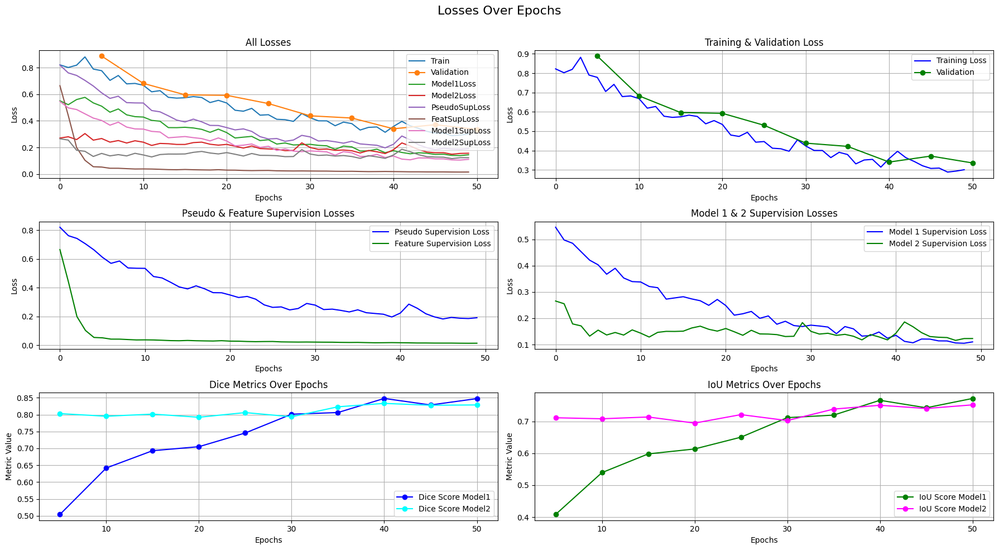

In [ ]:
fig, ax = plt.subplots(3, 2, figsize=(18, 10))
fig.suptitle('Losses Over Epochs', fontsize=16)

# Plot All Losses
ax[0, 0].plot(train_losses, label="Train")
ax[0, 0].plot(val_epochs, val_losses, label="Validation", marker='o')
ax[0, 0].plot(model1trn_losses, label="Model1Loss")
ax[0, 0].plot(model2trn_losses, label="Model2Loss")
ax[0, 0].plot(pseudotrn_losses, label="PseudoSupLoss")
ax[0, 0].plot(featsuptrn_lossed, label="FeatSupLoss")
ax[0, 0].plot(model1sup_losses, label="Model1SupLoss")
ax[0, 0].plot(model2sup_losses, label="Model2SupLoss")
ax[0, 0].set_title('All Losses')
ax[0, 0].set_xlabel("Epochs")
ax[0, 0].set_ylabel("Loss")
ax[0, 0].legend()
ax[0, 0].grid(True)

# Plot Training & Validation Loss
ax[0, 1].plot(train_losses, label='Training Loss', color='blue')
ax[0, 1].plot(val_epochs, val_losses, label="Validation", color='green', marker='o')
ax[0, 1].set_title('Training & Validation Loss')
ax[0, 1].set_xlabel("Epochs")
ax[0, 1].set_ylabel("Loss")
ax[0, 1].legend()
ax[0, 1].grid(True)

# Plot Pseudo Supervision and Feature Supervision Losses
ax[1, 0].plot(pseudotrn_losses, label='Pseudo Supervision Loss', color='blue')
ax[1, 0].plot(featsuptrn_lossed, label='Feature Supervision Loss', color='green')
ax[1, 0].set_title('Pseudo & Feature Supervision Losses')
ax[1, 0].set_xlabel("Epochs")
ax[1, 0].set_ylabel("Loss")
ax[1, 0].legend()
ax[1, 0].grid(True)

# Plot Individual Supervision Losses
ax[1, 1].plot(model1sup_losses, label='Model 1 Supervision Loss', color='blue')
ax[1, 1].plot(model2sup_losses, label='Model 2 Supervision Loss', color='green')
ax[1, 1].set_title('Model 1 & 2 Supervision Losses')
ax[1, 1].set_xlabel("Epochs")
ax[1, 1].set_ylabel("Loss")
ax[1, 1].legend()
ax[1, 1].grid(True)

# Plot Dice Metrics for both models over epochs
ax[2, 0].plot(val_epochs, val_dice_scores1, label="Dice Score Model1", marker='o', color='blue')
ax[2, 0].plot(val_epochs, val_dice_scores2, label="Dice Score Model2", marker='o', color='cyan')
ax[2, 0].set_title('Dice Metrics Over Epochs')
ax[2, 0].set_xlabel("Epochs")
ax[2, 0].set_ylabel("Metric Value")
ax[2, 0].legend()
ax[2, 0].grid(True)

# Plot IoU Metrics for both models over epochs
ax[2, 1].plot(val_epochs, val_iou_scores1, label="IoU Score Model1", marker='o', color='green')
ax[2, 1].plot(val_epochs, val_iou_scores2, label="IoU Score Model2", marker='o', color='magenta')
ax[2, 1].set_title('IoU Metrics Over Epochs')
ax[2, 1].set_xlabel("Epochs")
ax[2, 1].set_ylabel("Metric Value")
ax[2, 1].legend()
ax[2, 1].grid(True)

plt.tight_layout()
plt.subplots_adjust(top=0.9)
plt.show()

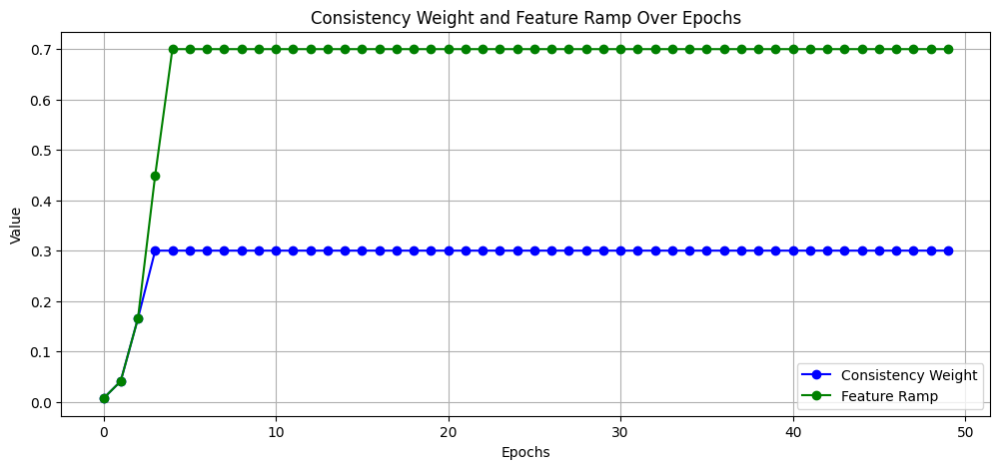

In [ ]:
plt.figure(figsize=(12, 5))

# Plot consistency weights
plt.plot(consistency_weights.keys(), consistency_weights.values(), label='Consistency Weight', color='blue', marker='o')

# Plot feature ramps
plt.plot(feature_ramps.keys(), feature_ramps.values(), label='Feature Ramp', color='green', marker='o')

plt.title('Consistency Weight and Feature Ramp Over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Value')
plt.legend()
plt.grid(True)
plt.show()

### Visualize Cross TeachingPredictions

Model 1 Prediction:


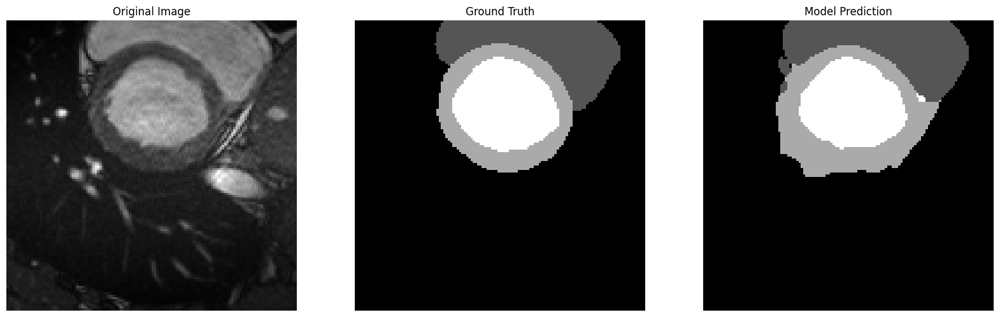

Model 2 Prediction:


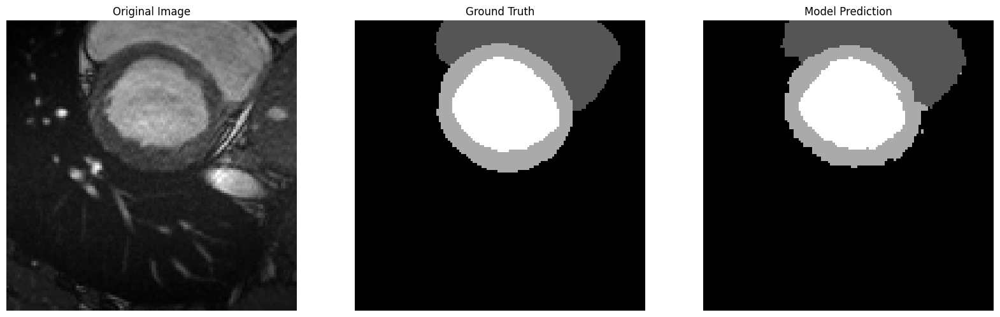

Model 1 Prediction:


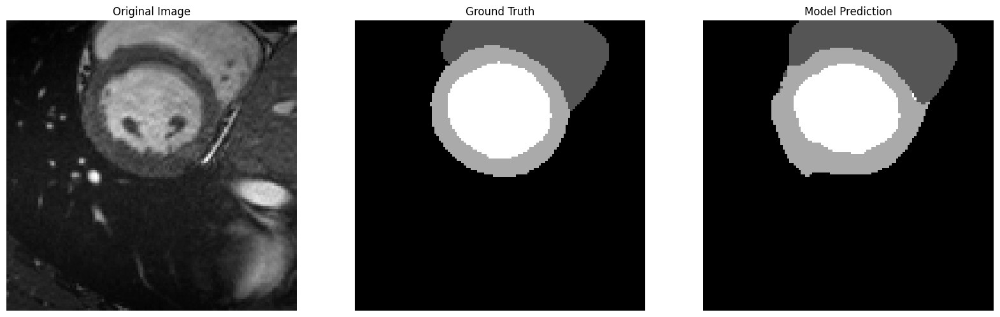

Model 2 Prediction:


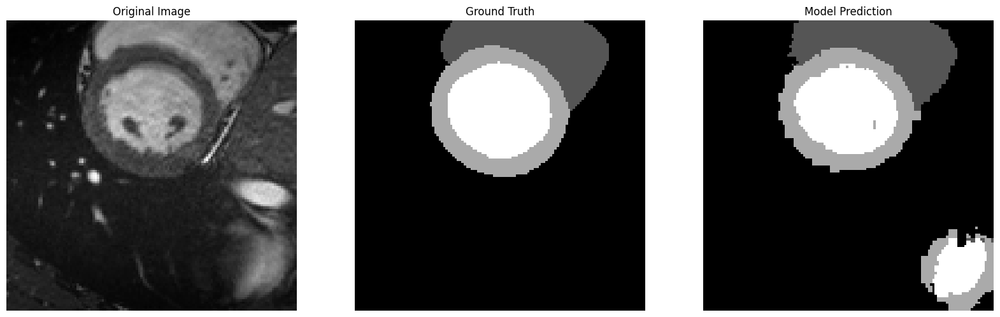

Model 1 Prediction:


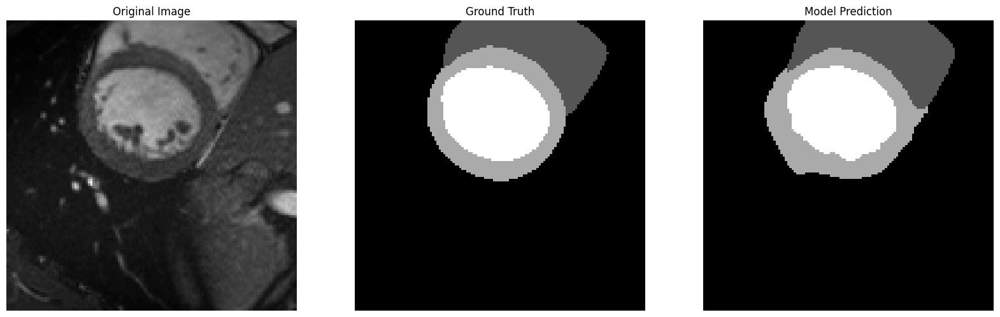

Model 2 Prediction:


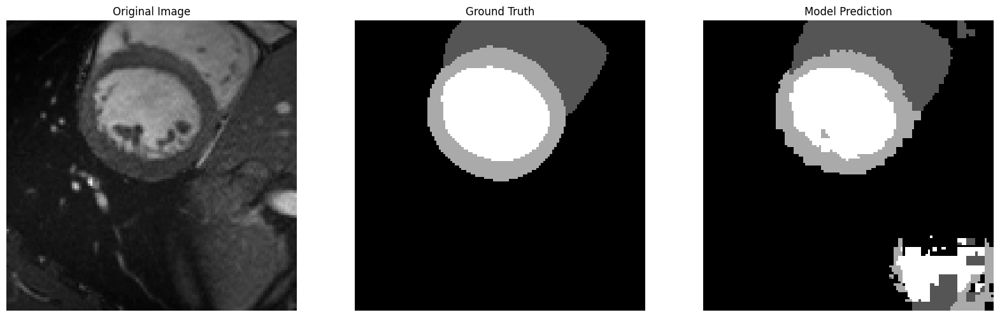

Model 1 Prediction:


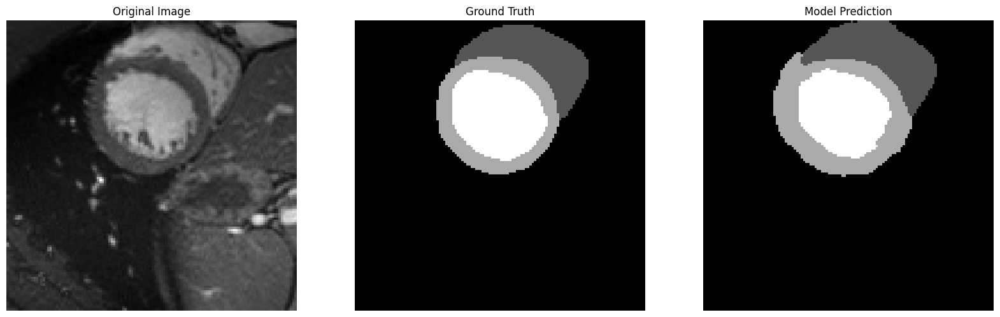

Model 2 Prediction:


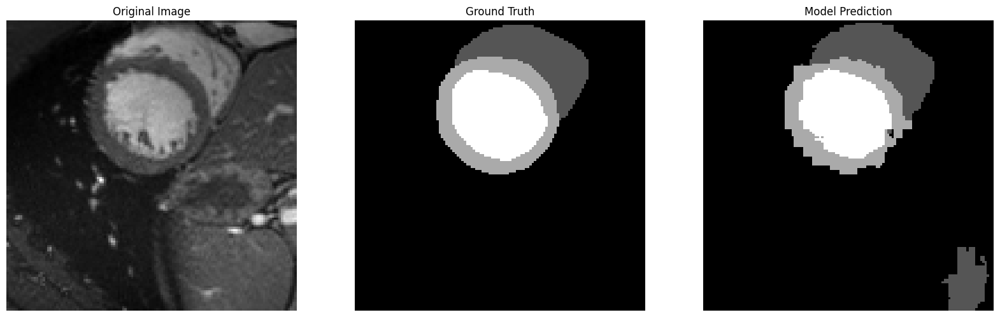

Model 1 Prediction:


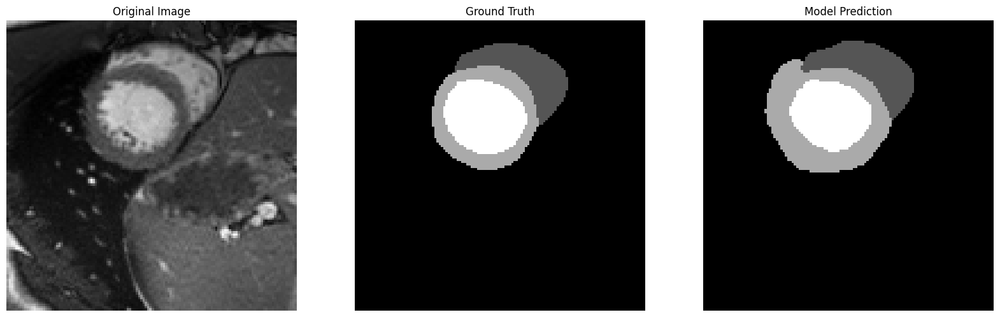

Model 2 Prediction:


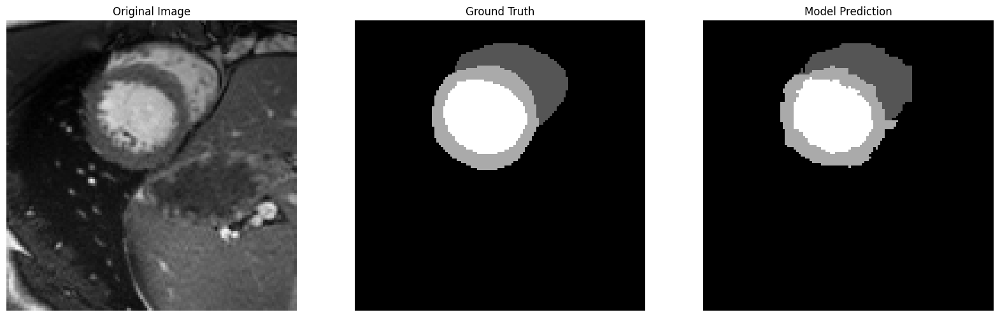

Model 1 Prediction:


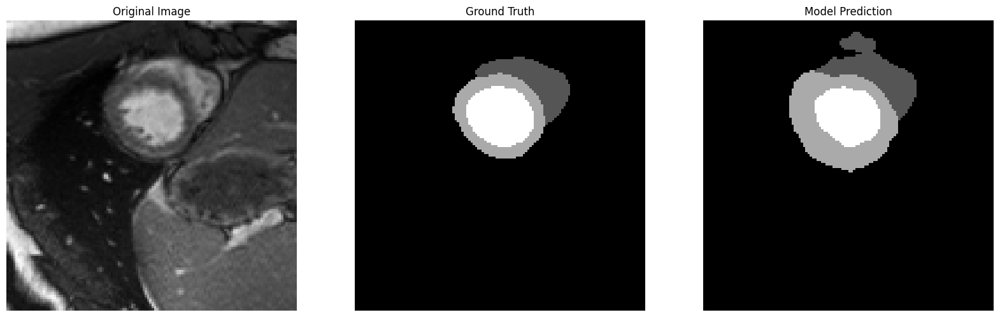

Model 2 Prediction:


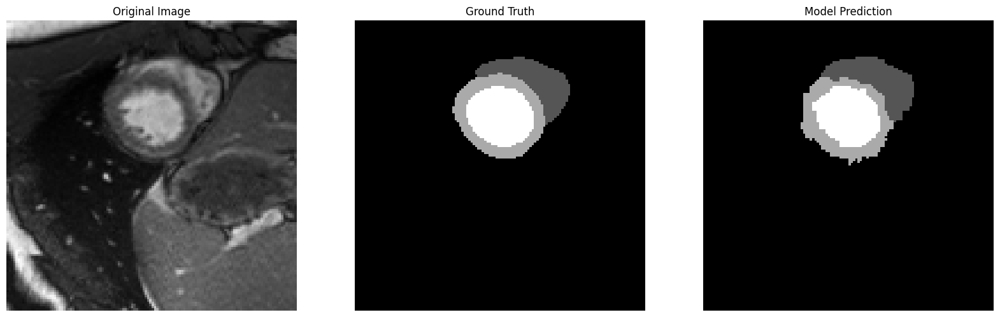

Model 1 Prediction:


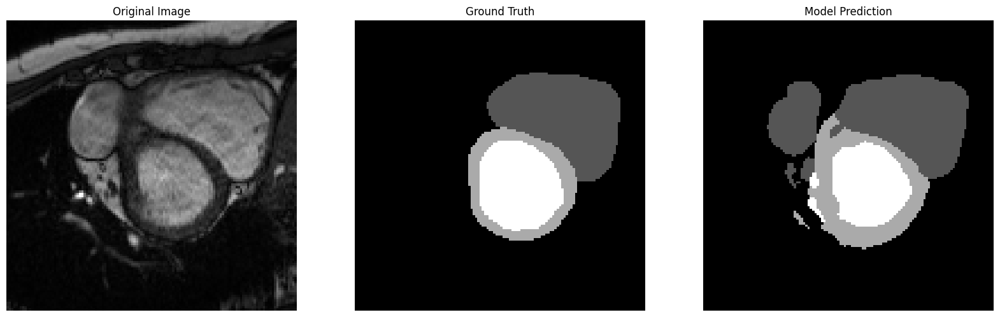

Model 2 Prediction:


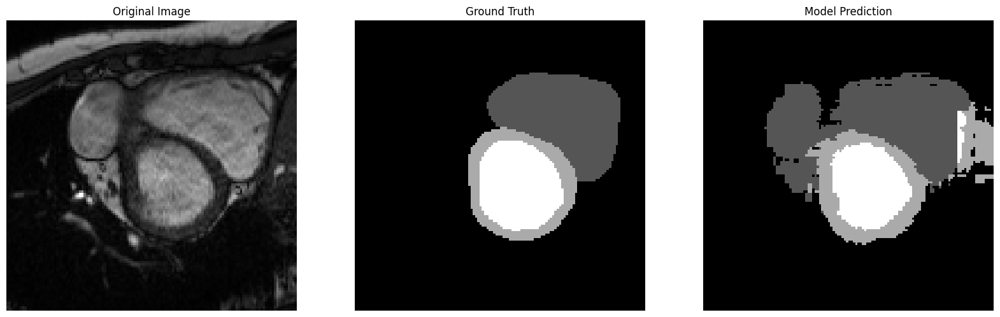

Model 1 Prediction:


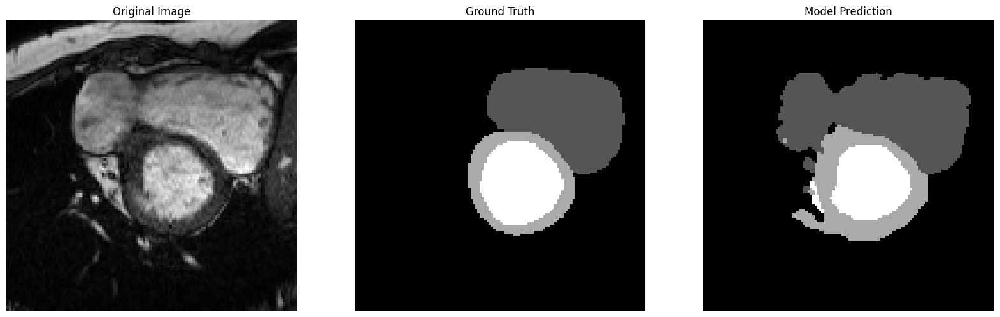

Model 2 Prediction:


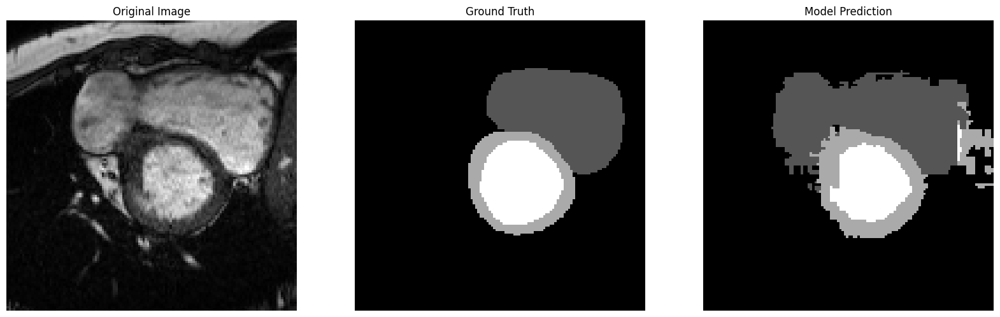

Model 1 Prediction:


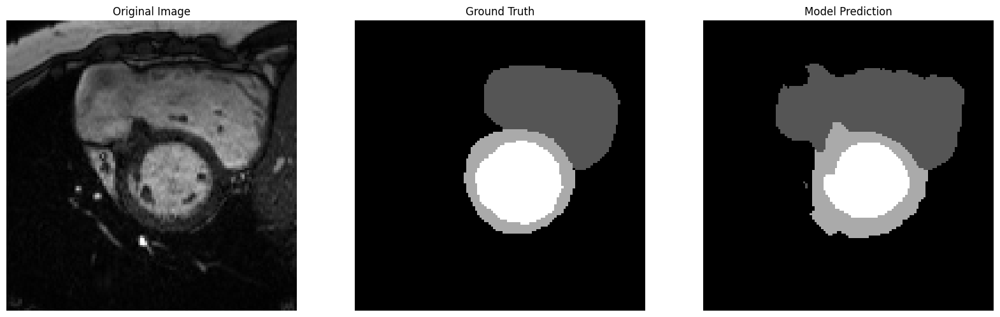

Model 2 Prediction:


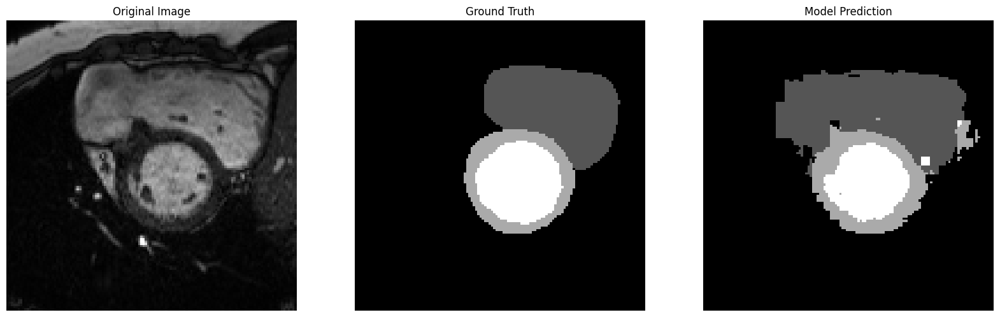

Model 1 Prediction:


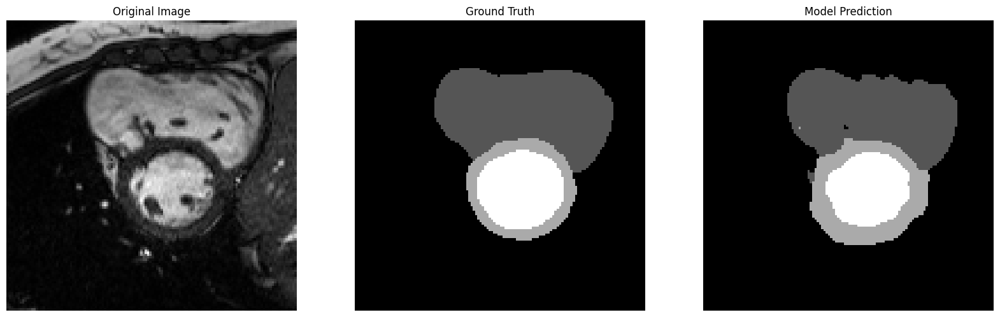

Model 2 Prediction:


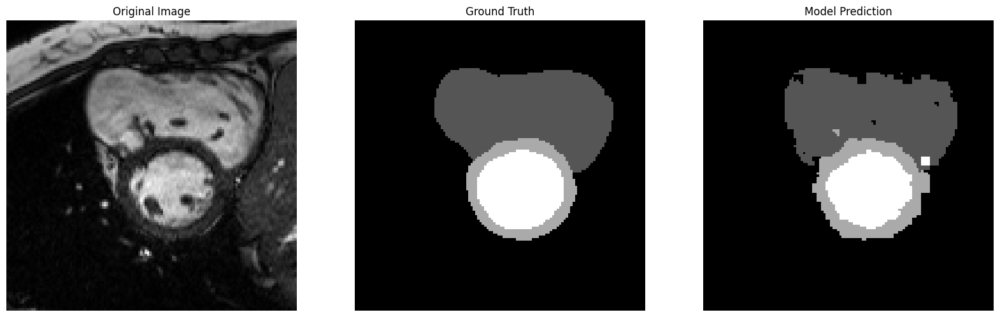

Model 1 Prediction:


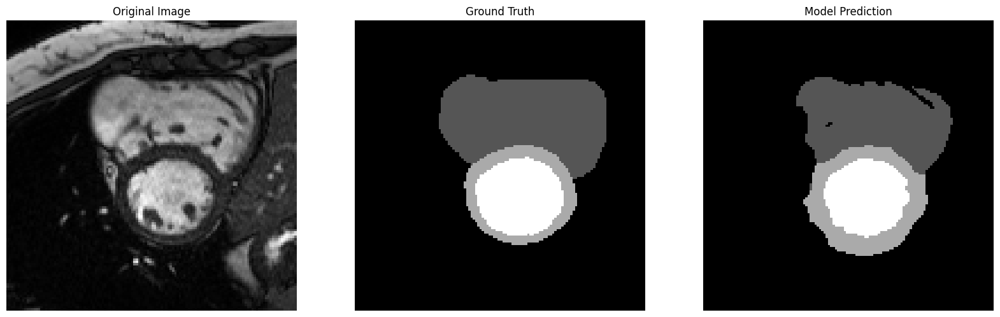

Model 2 Prediction:


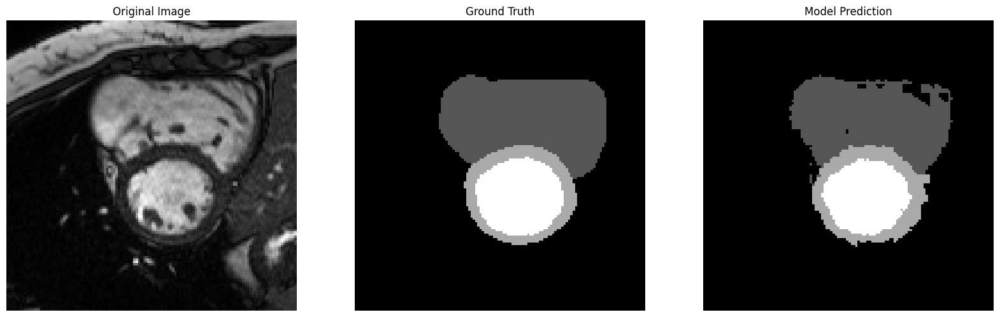

Model 1 Prediction:


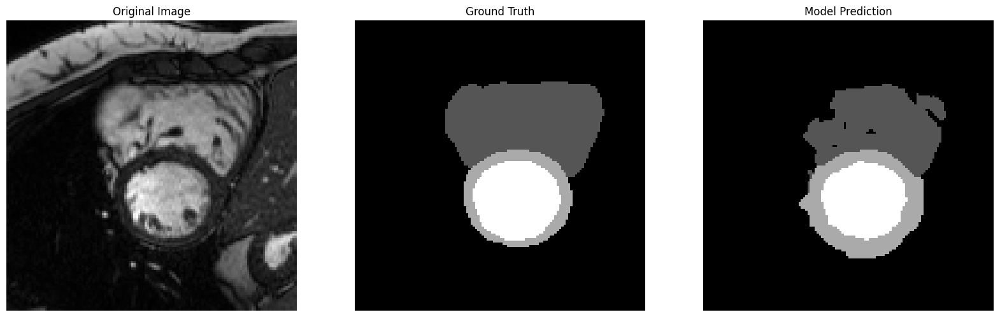

Model 2 Prediction:


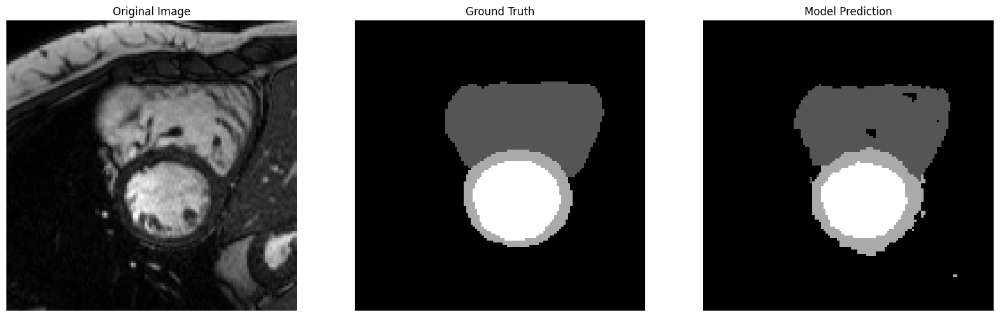

Model 1 Prediction:


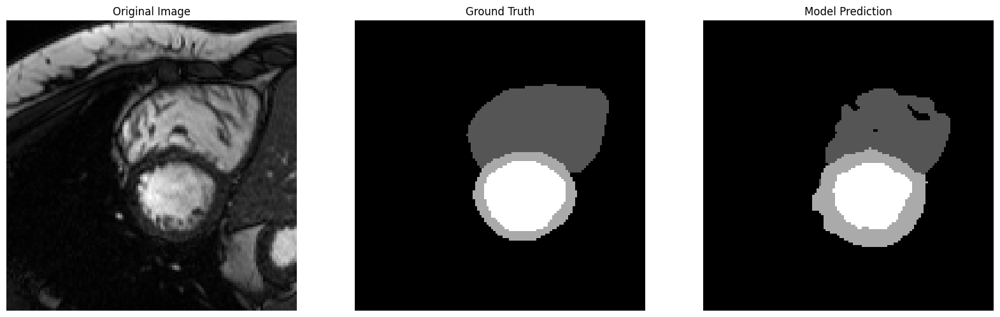

Model 2 Prediction:


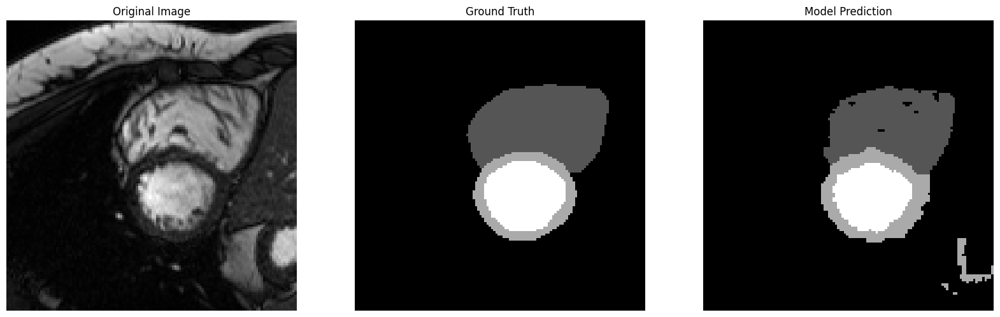

Model 1 Prediction:


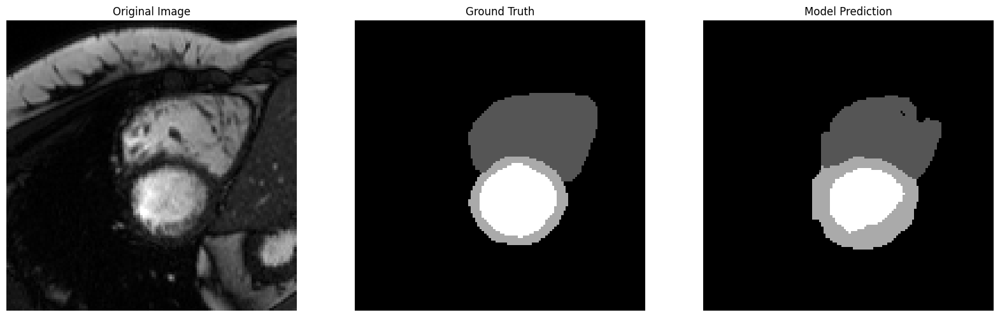

Model 2 Prediction:


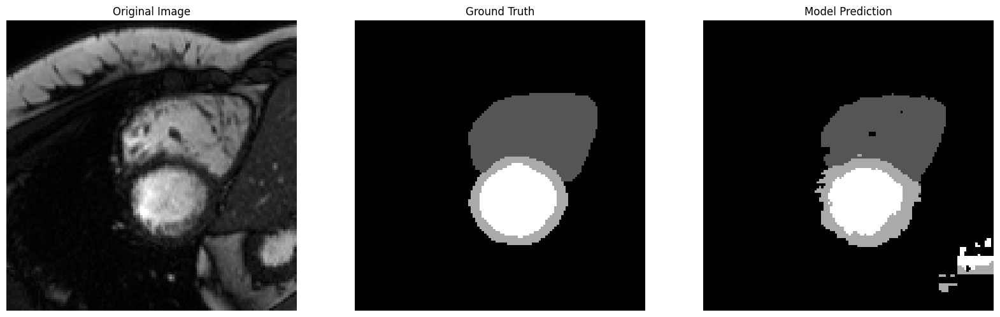

Model 1 Prediction:


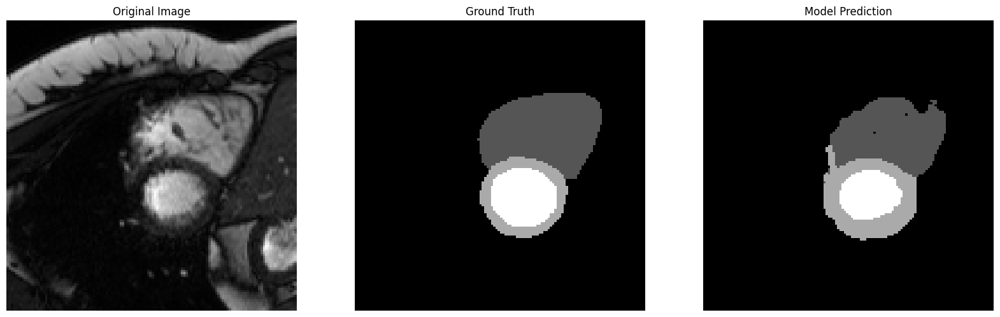

Model 2 Prediction:


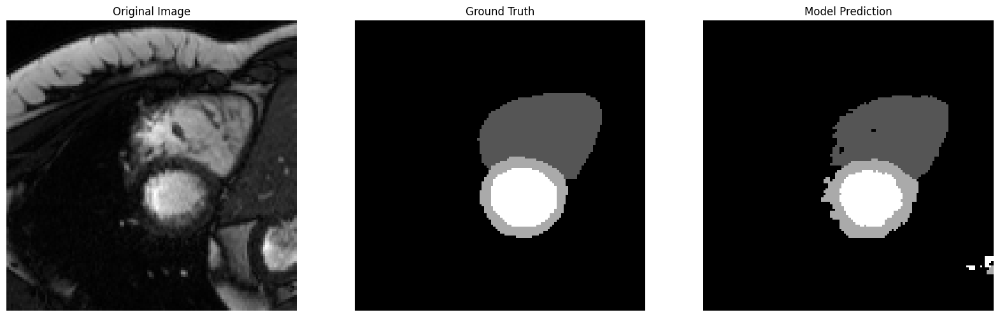

Model 1 Prediction:


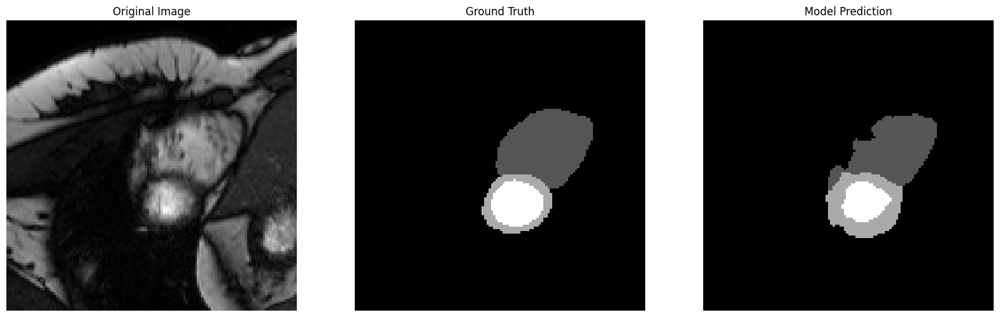

Model 2 Prediction:


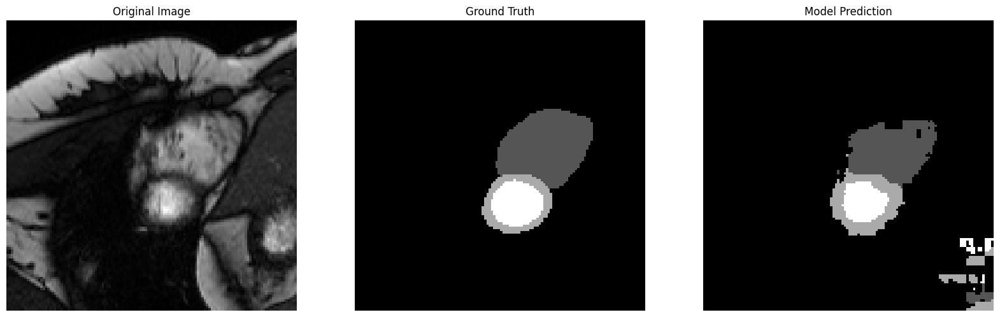

Model 1 Prediction:


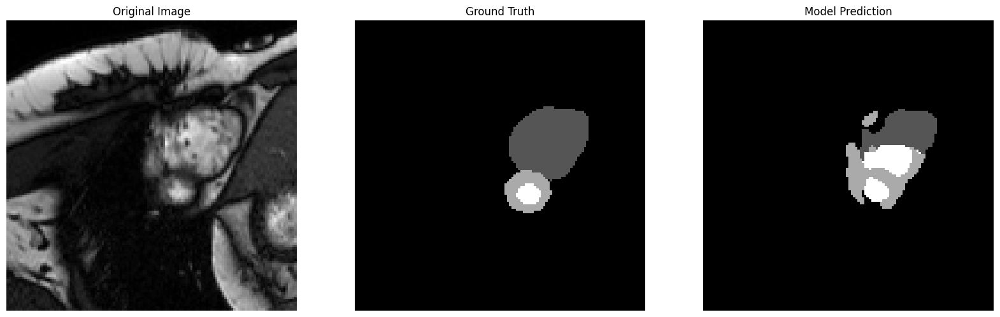

Model 2 Prediction:


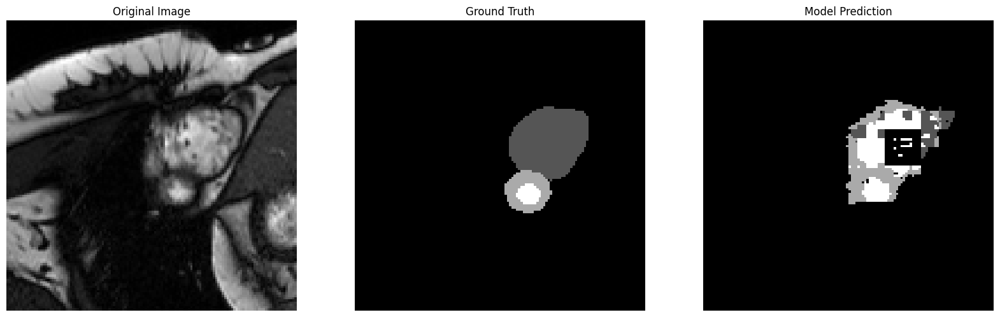

Model 1 Prediction:


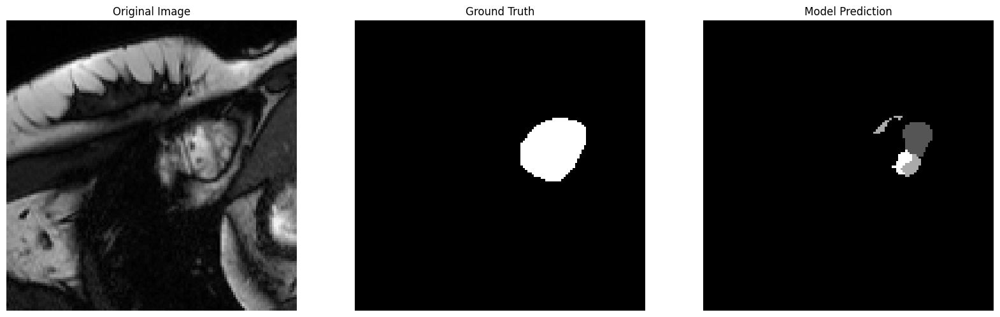

Model 2 Prediction:


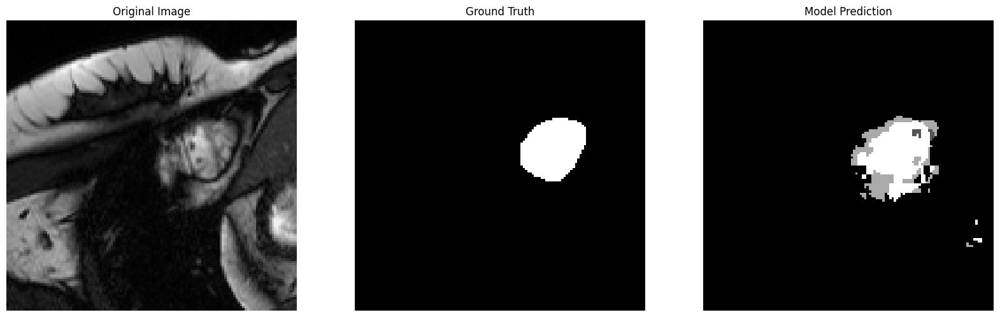

Model 1 Prediction:


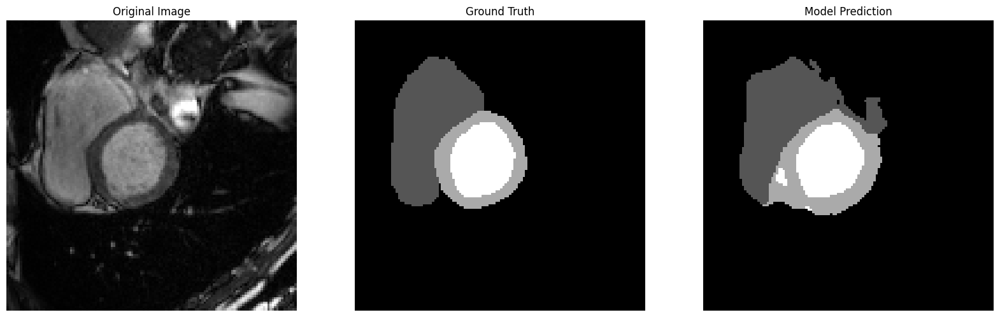

Model 2 Prediction:


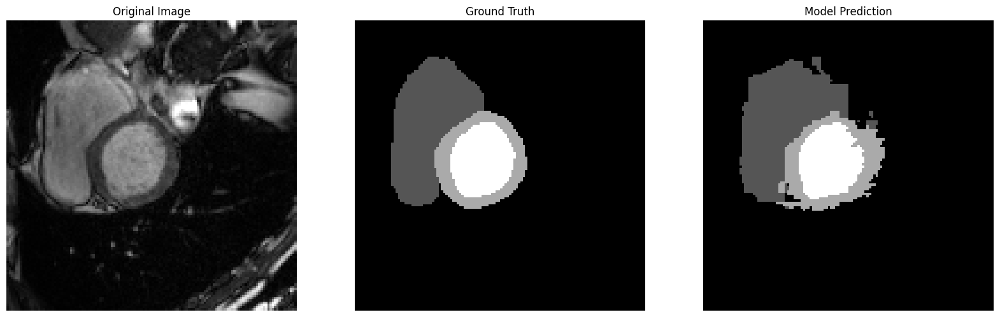

Model 1 Prediction:


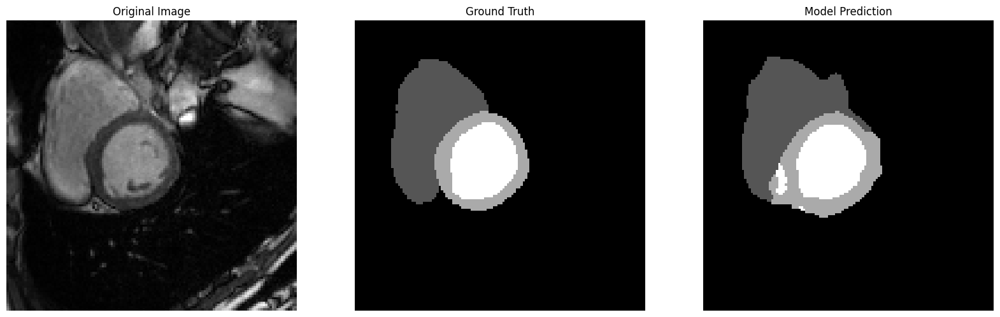

Model 2 Prediction:


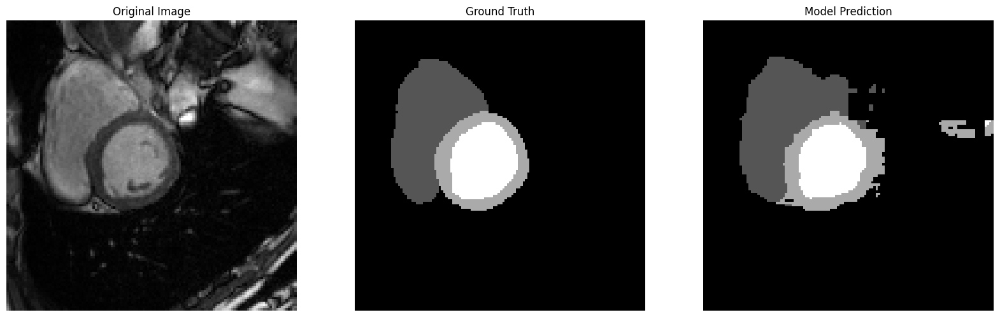

Model 1 Prediction:


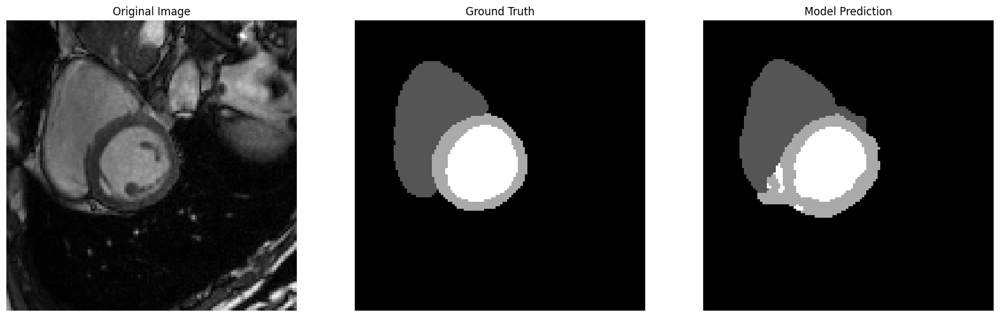

Model 2 Prediction:


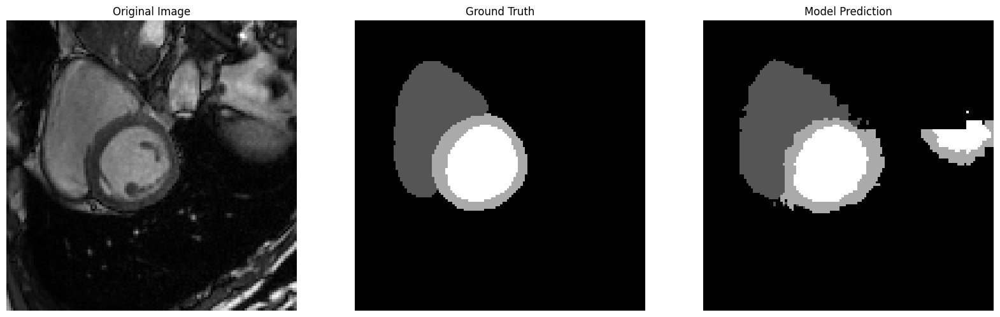

Model 1 Prediction:


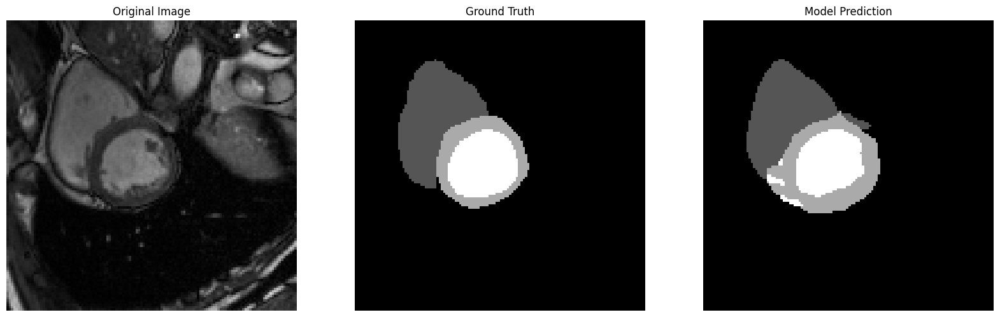

Model 2 Prediction:


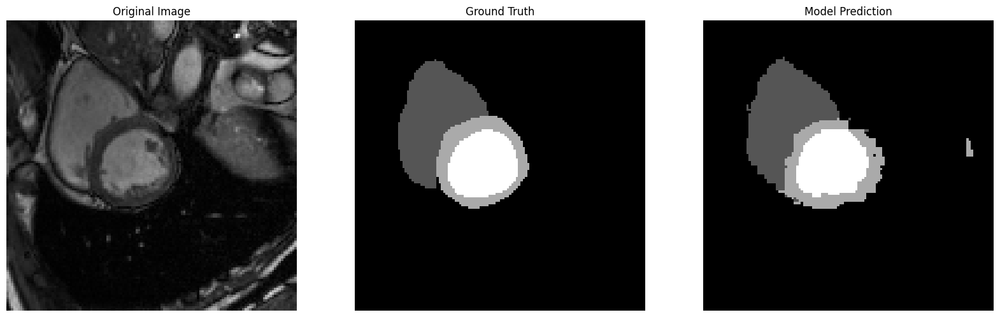

Model 1 Prediction:


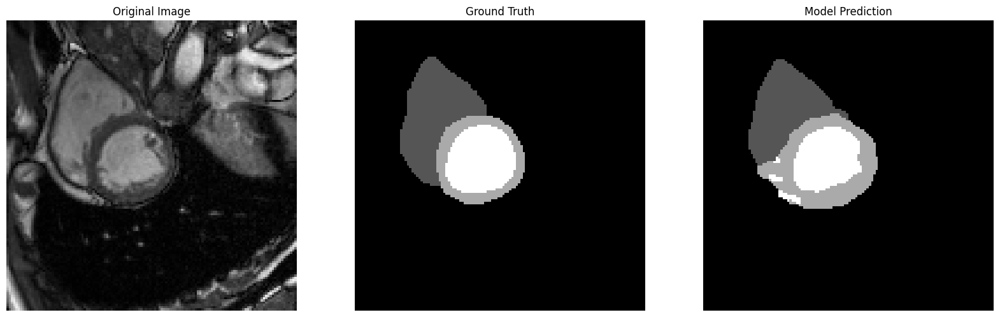

Model 2 Prediction:


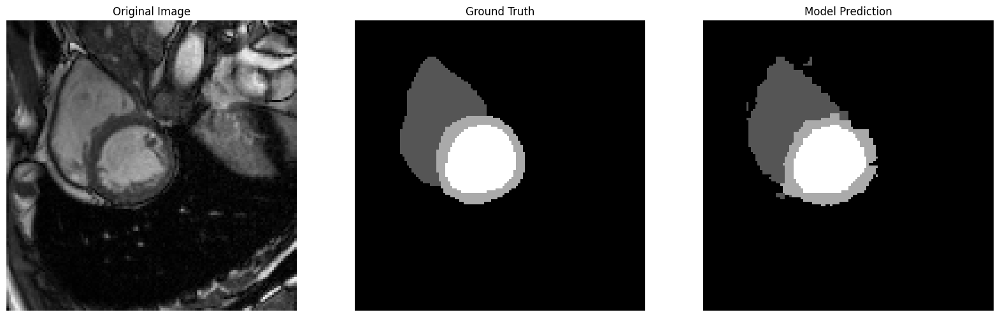

Model 1 Prediction:


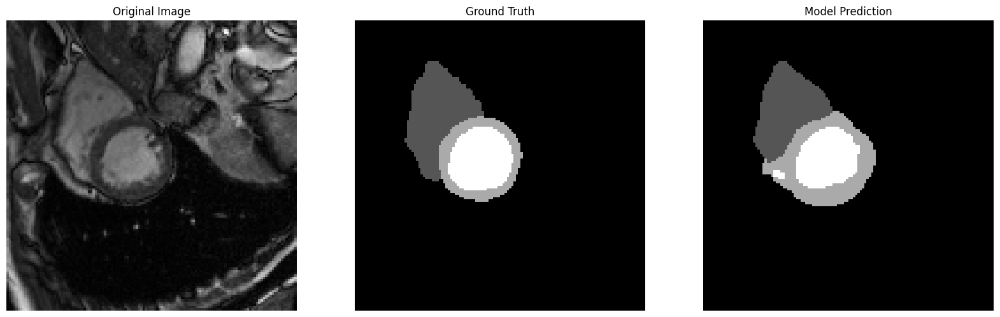

Model 2 Prediction:


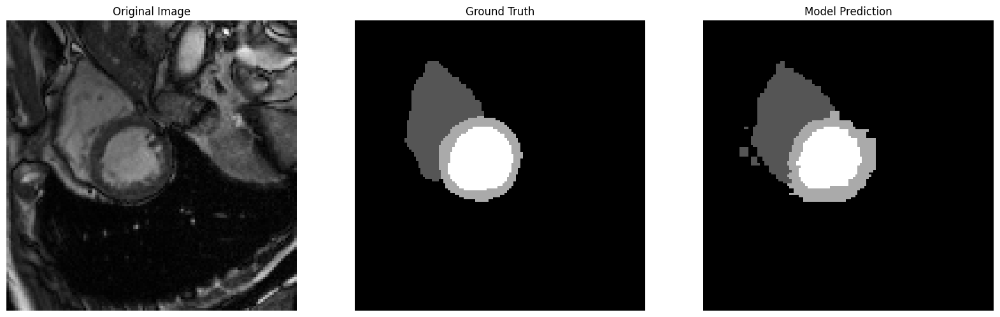

Model 1 Prediction:


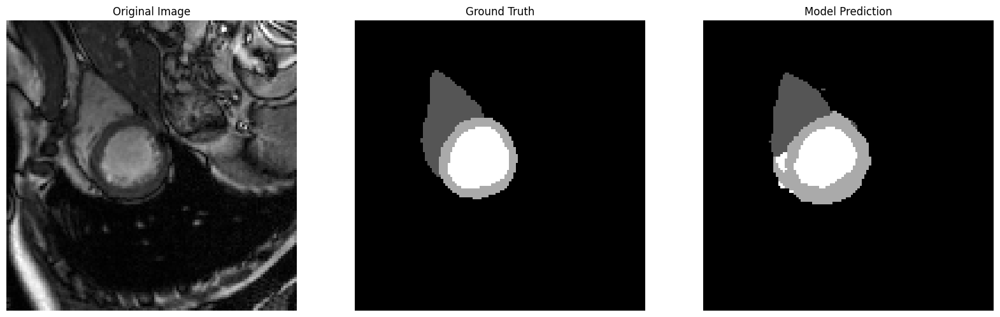

Model 2 Prediction:


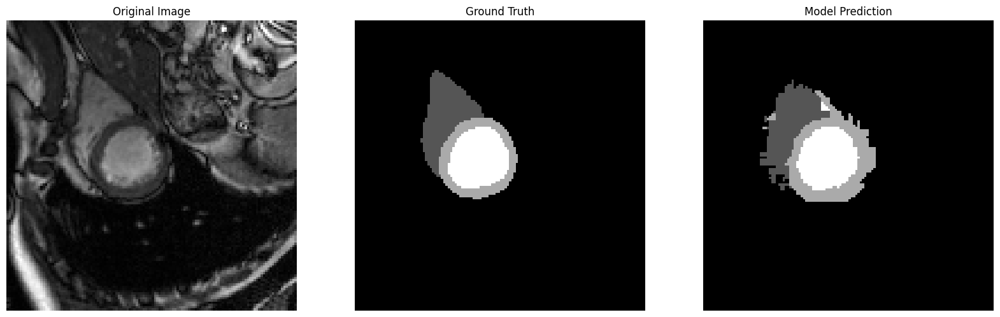

Model 1 Prediction:


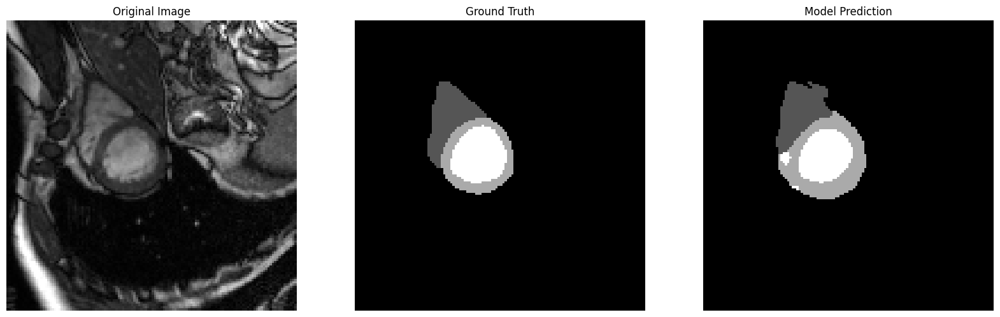

Model 2 Prediction:


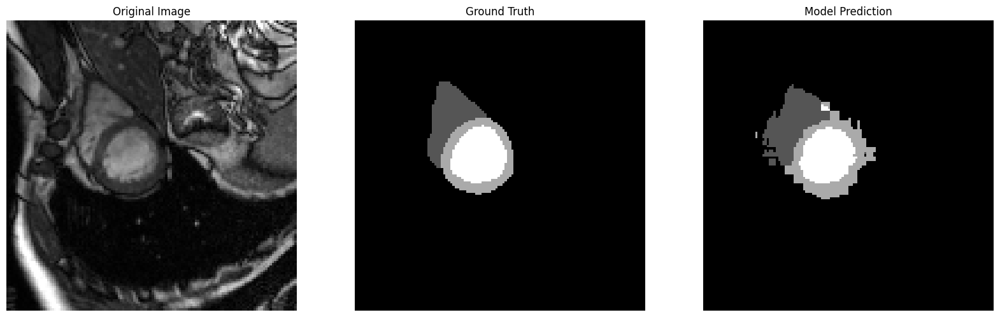

Model 1 Prediction:


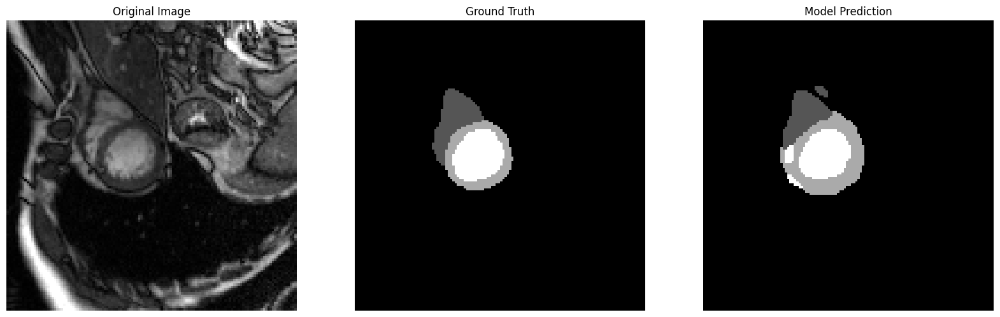

Model 2 Prediction:


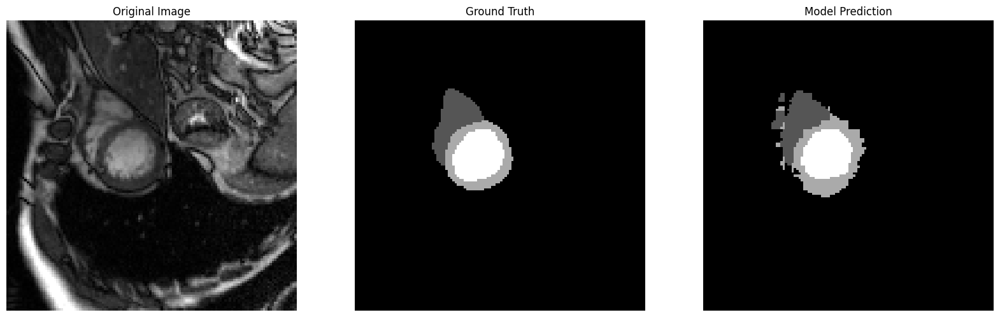

Model 1 Prediction:


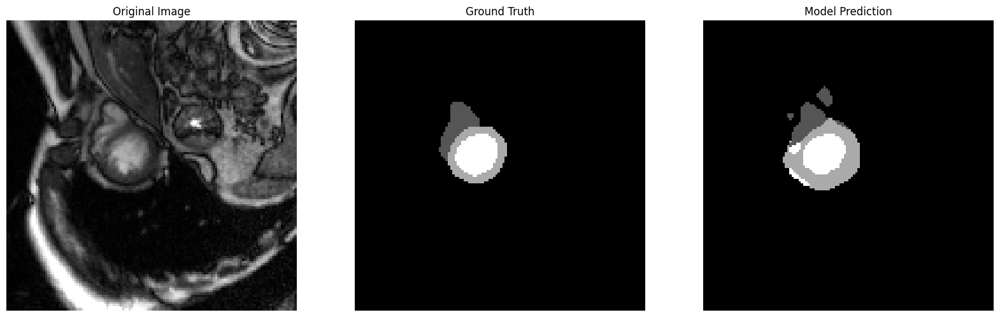

Model 2 Prediction:


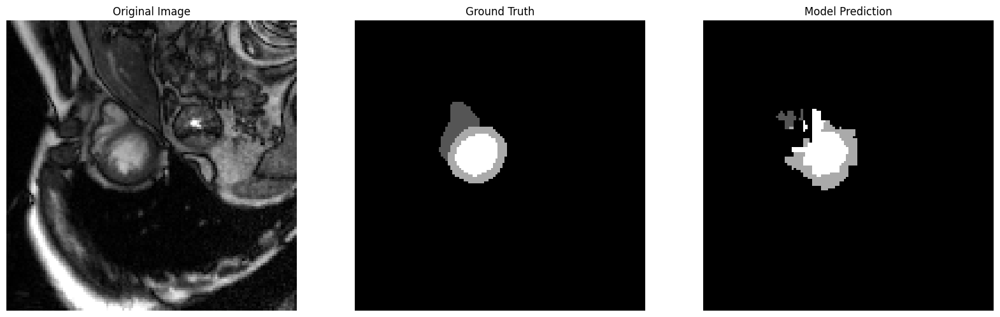

Model 1 Prediction:


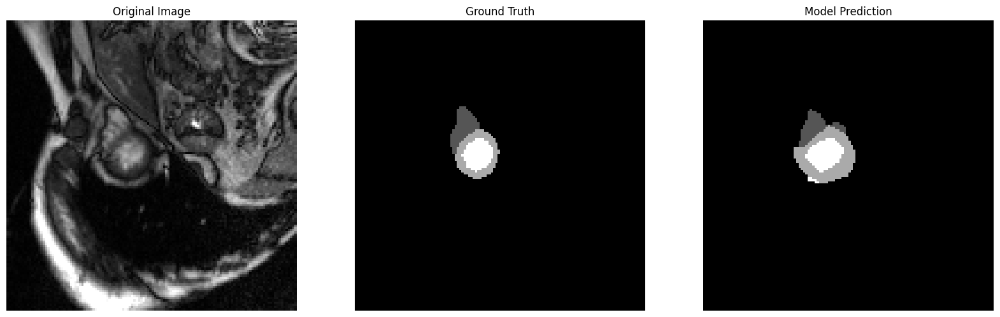

Model 2 Prediction:


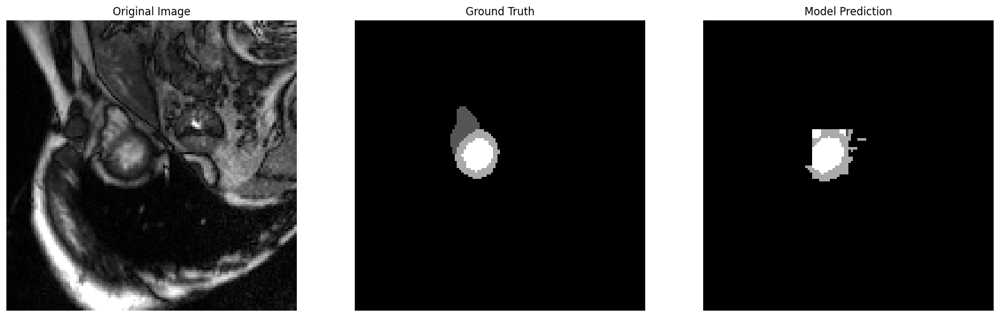

Model 1 Prediction:


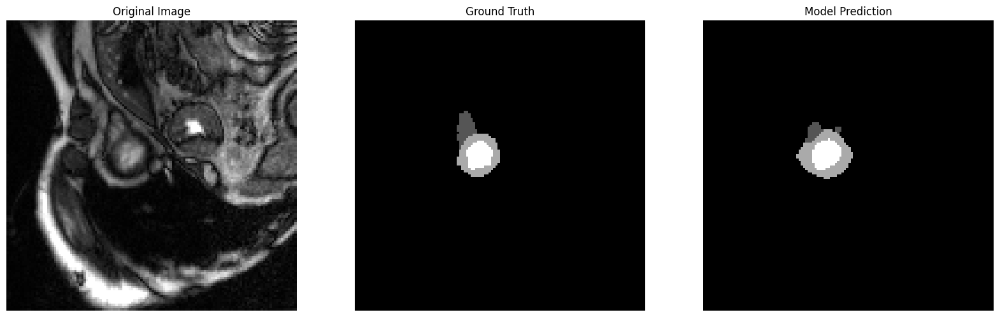

Model 2 Prediction:


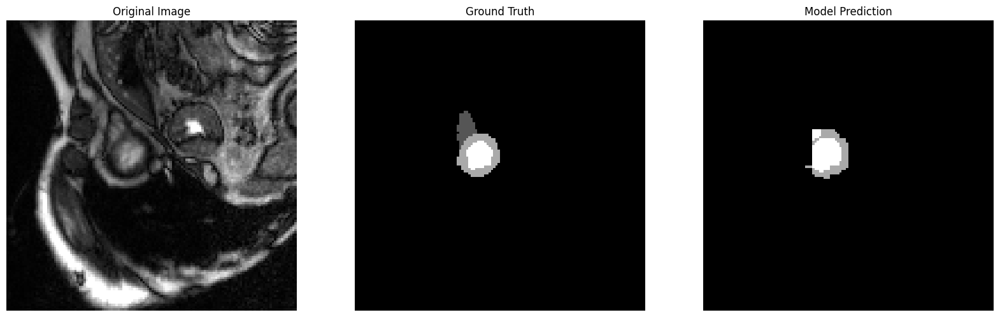

Model 1 Prediction:


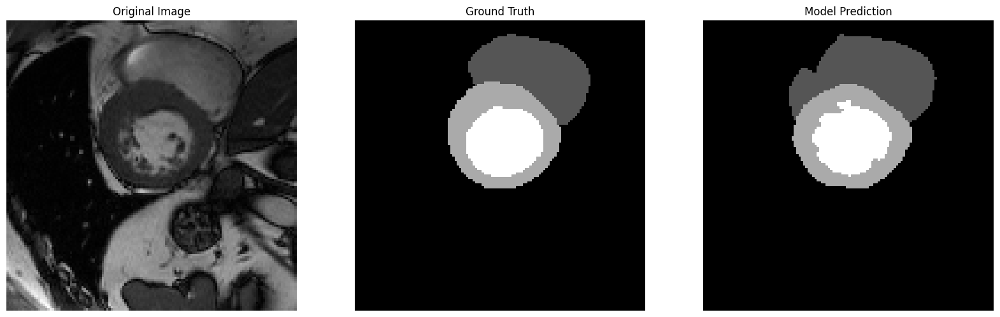

Model 2 Prediction:


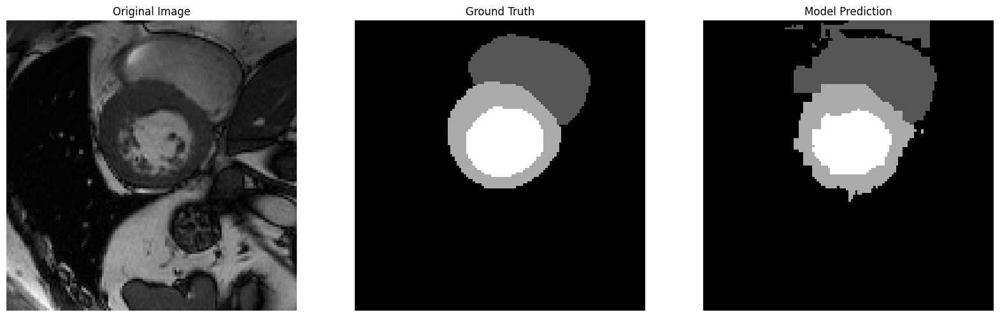

Model 1 Prediction:


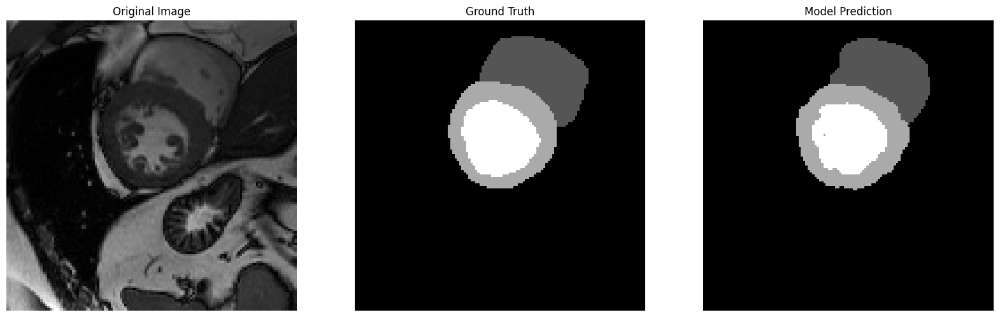

Model 2 Prediction:


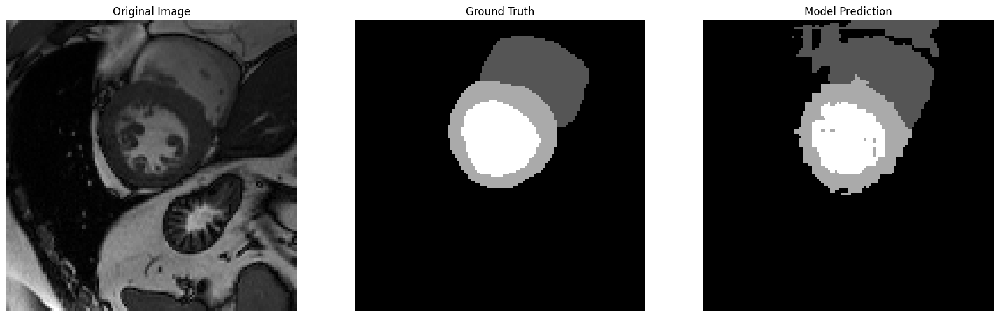

Model 1 Prediction:


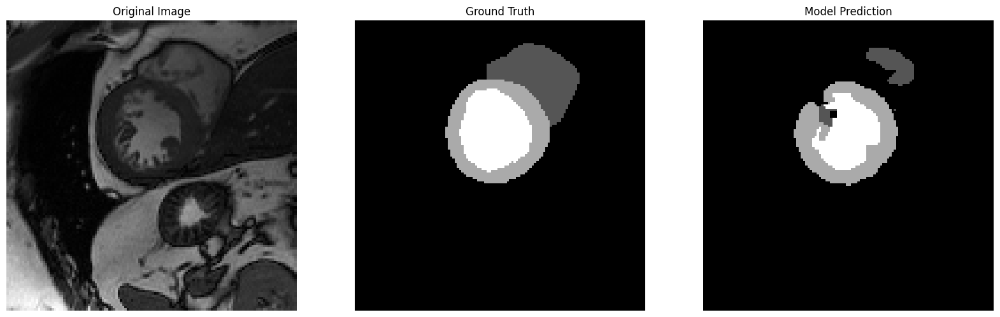

Model 2 Prediction:


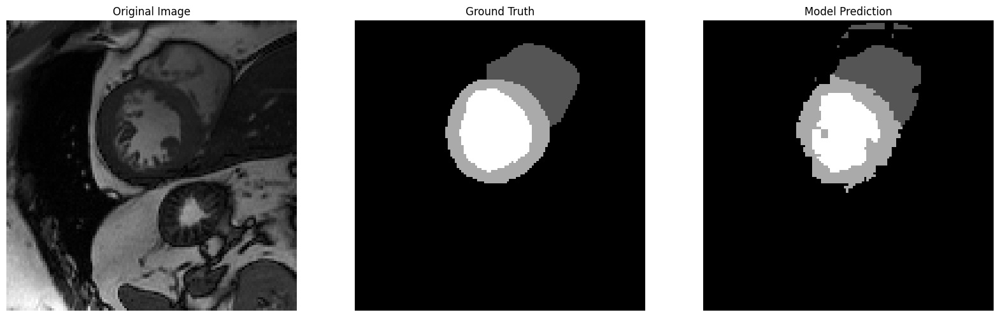

Model 1 Prediction:


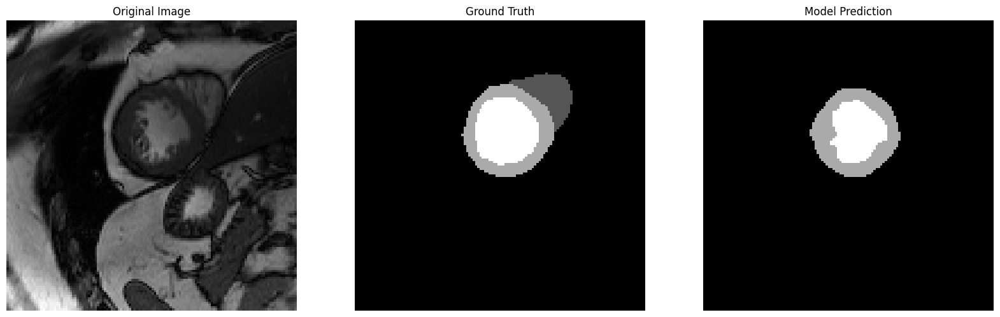

Model 2 Prediction:


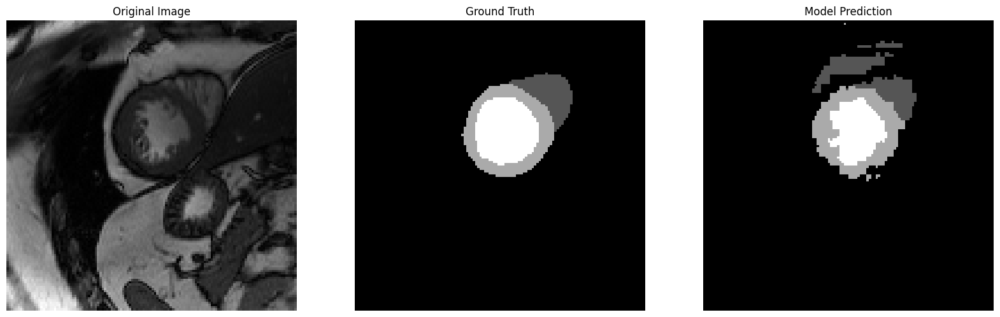

Model 1 Prediction:


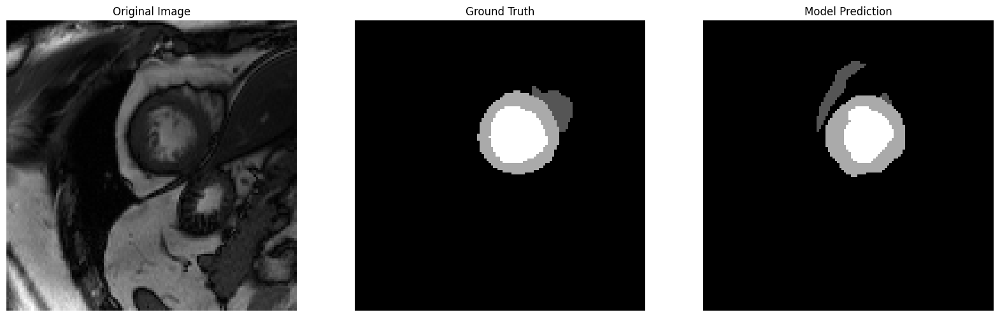

Model 2 Prediction:


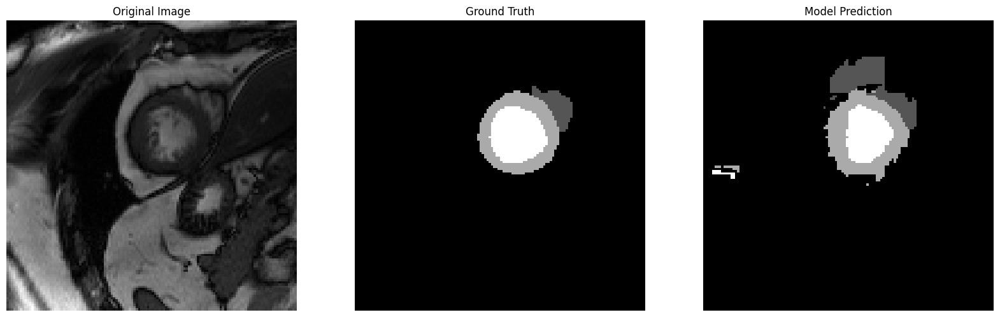

Model 1 Prediction:


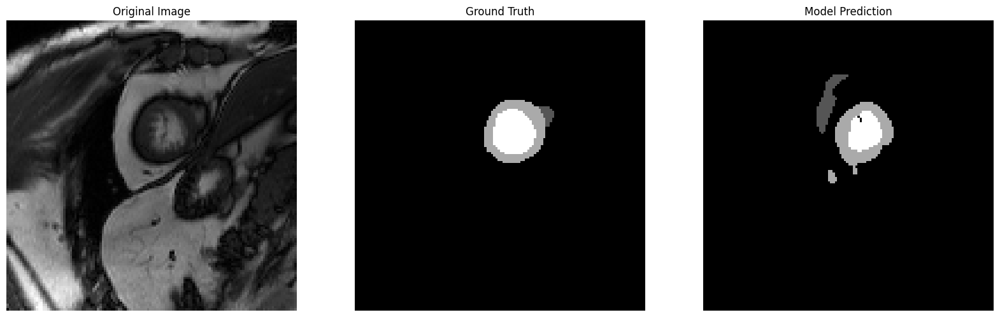

Model 2 Prediction:


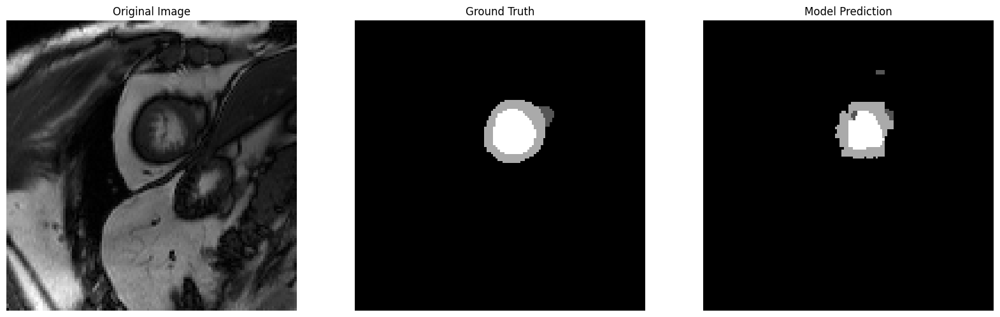

Model 1 Prediction:


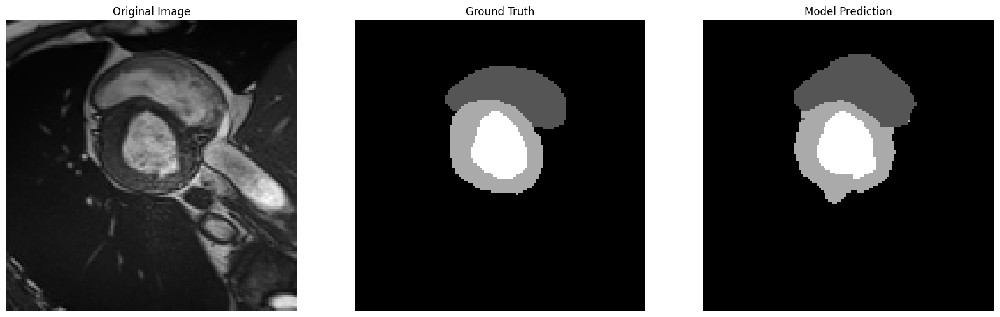

Model 2 Prediction:


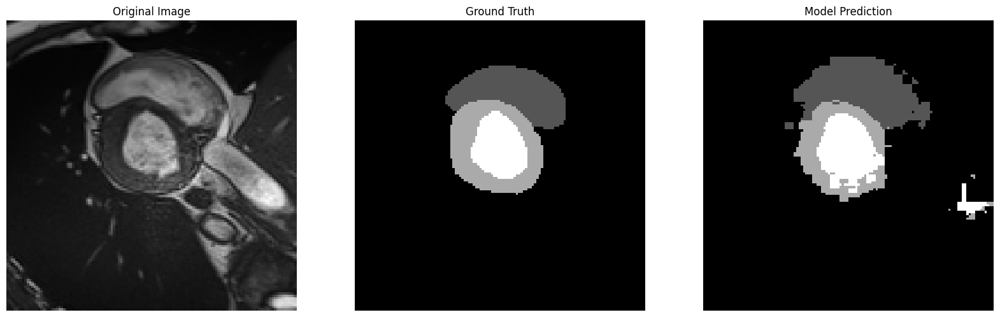

Model 1 Prediction:


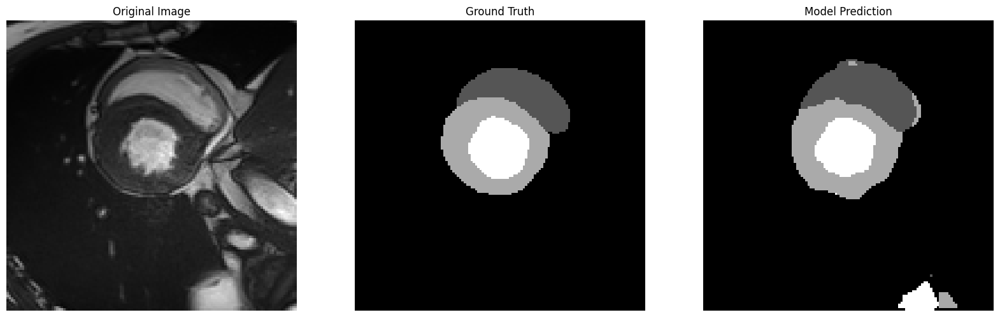

Model 2 Prediction:


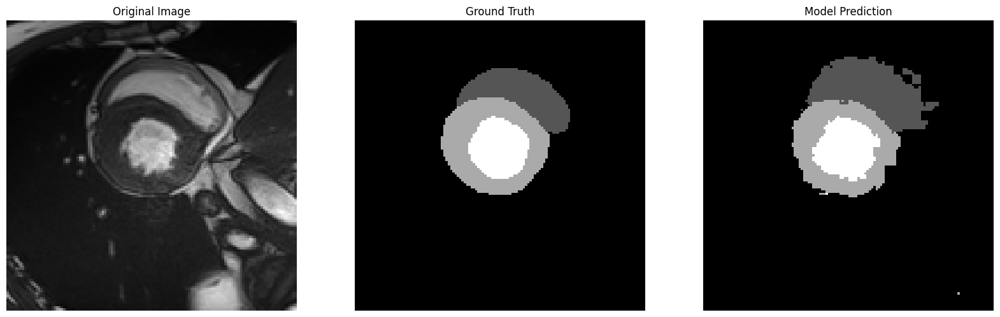

Model 1 Prediction:


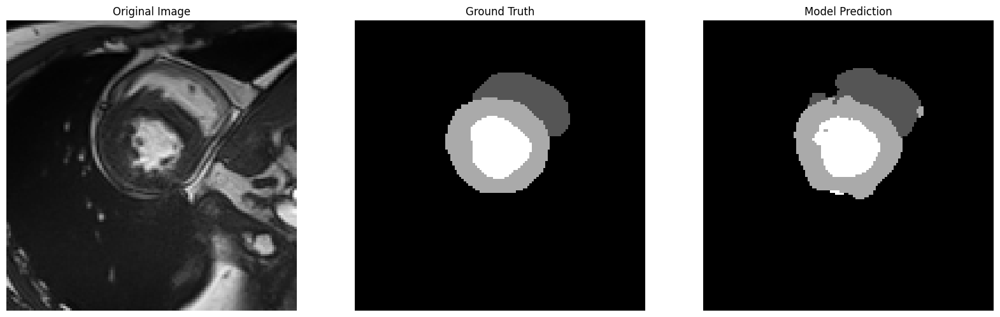

Model 2 Prediction:


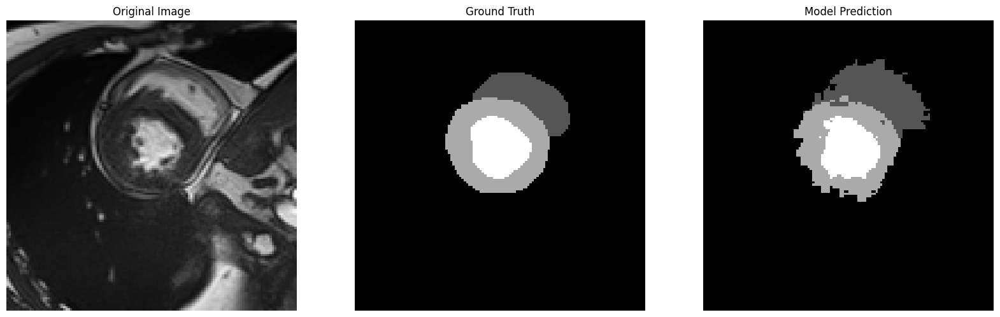

Model 1 Prediction:


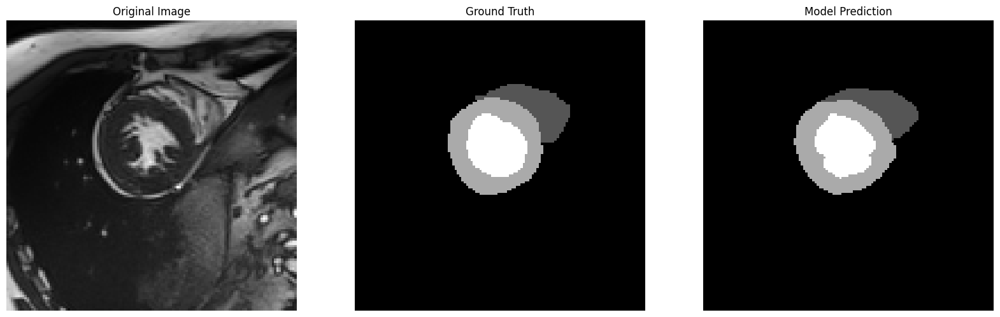

Model 2 Prediction:


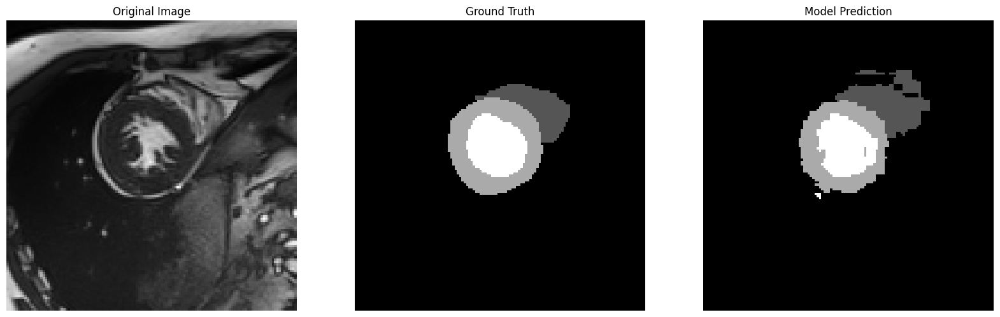

Model 1 Prediction:


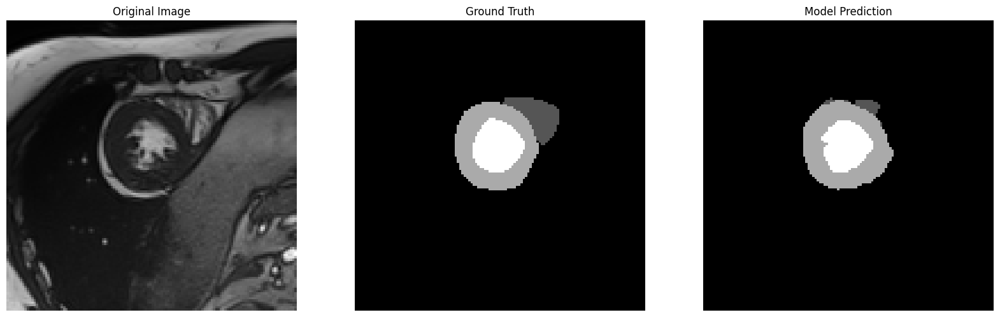

Model 2 Prediction:


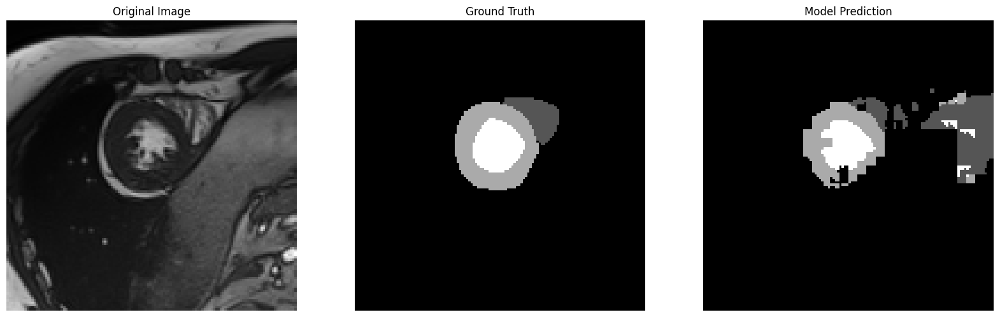

Model 1 Prediction:


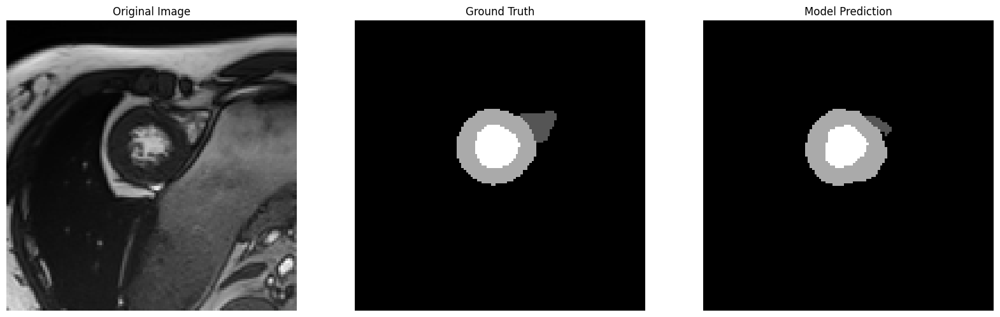

Model 2 Prediction:


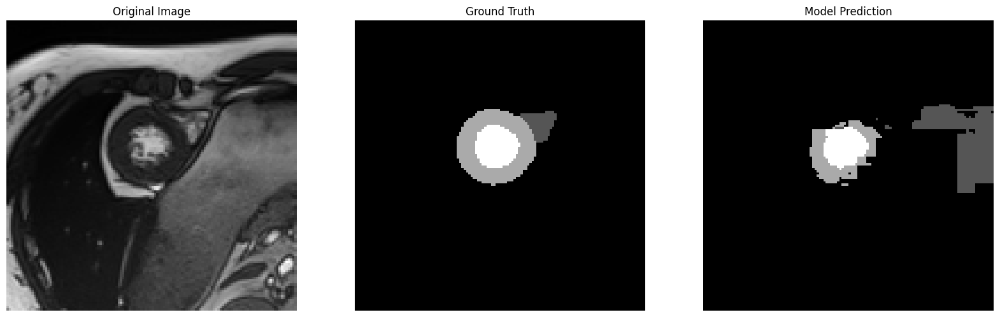

Model 1 Prediction:


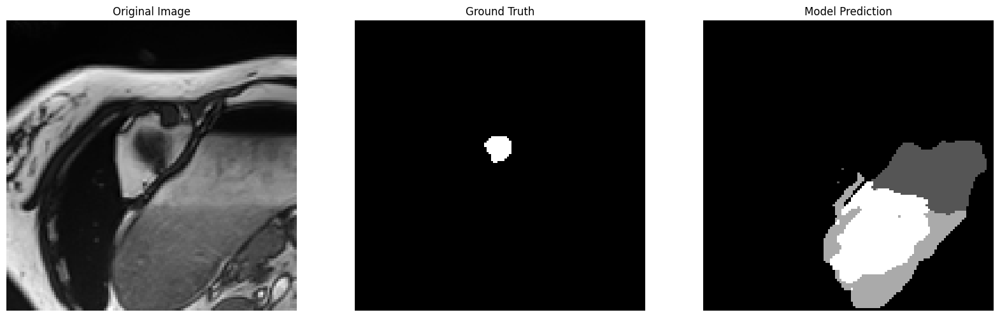

Model 2 Prediction:


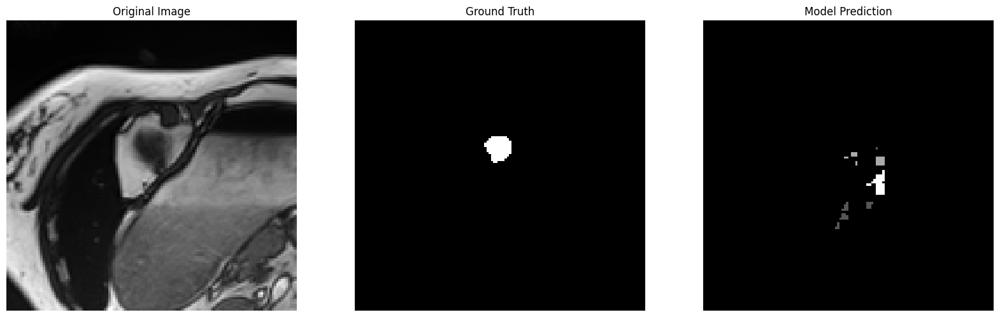

Model 1 Prediction:


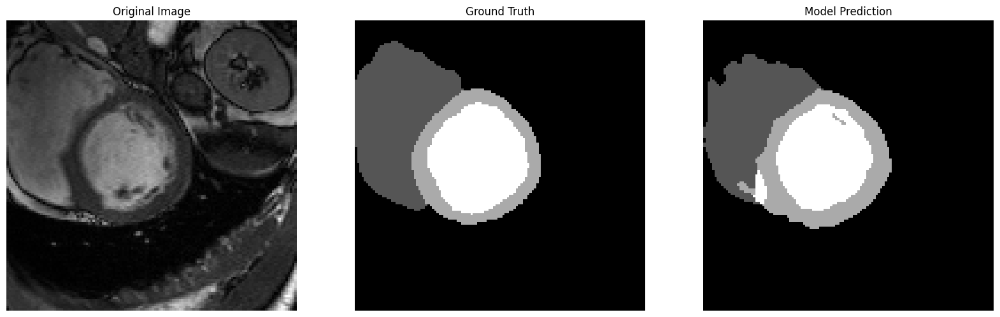

Model 2 Prediction:


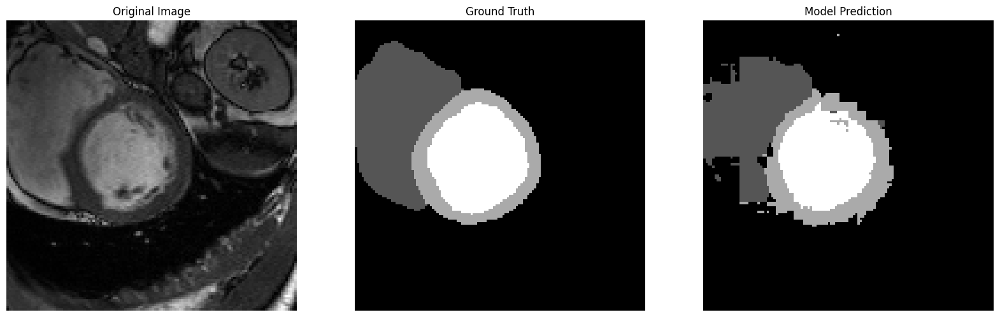

Model 1 Prediction:


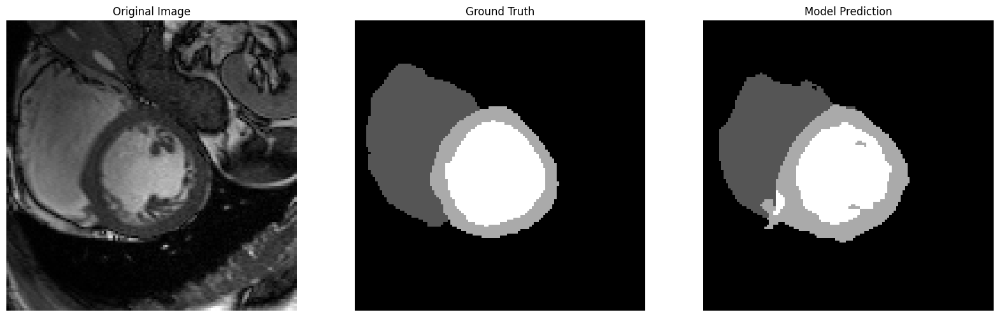

Model 2 Prediction:


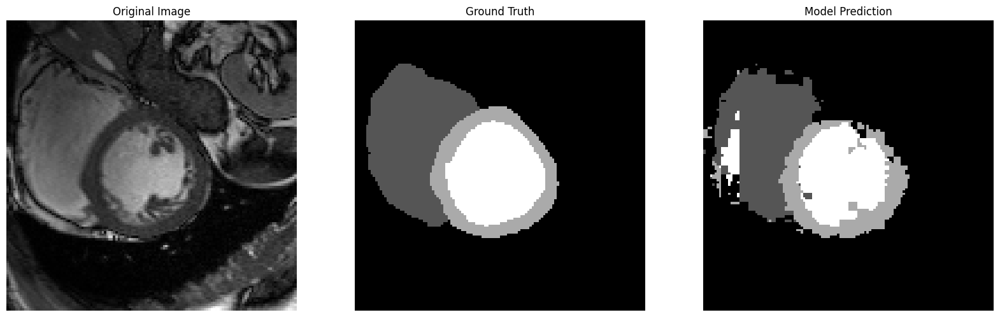

Model 1 Prediction:


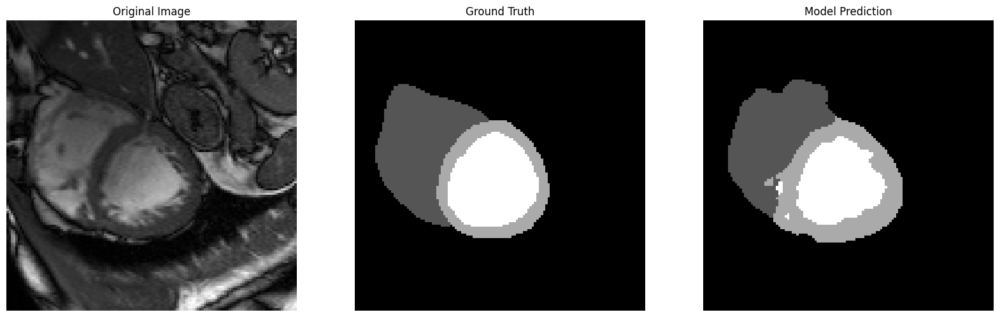

Model 2 Prediction:


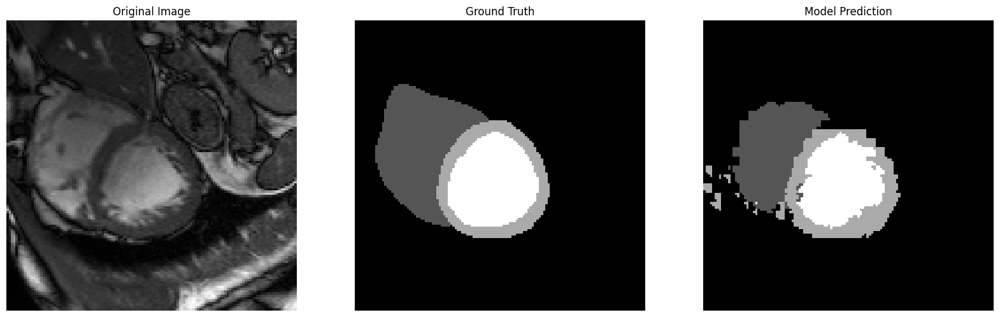

Model 1 Prediction:


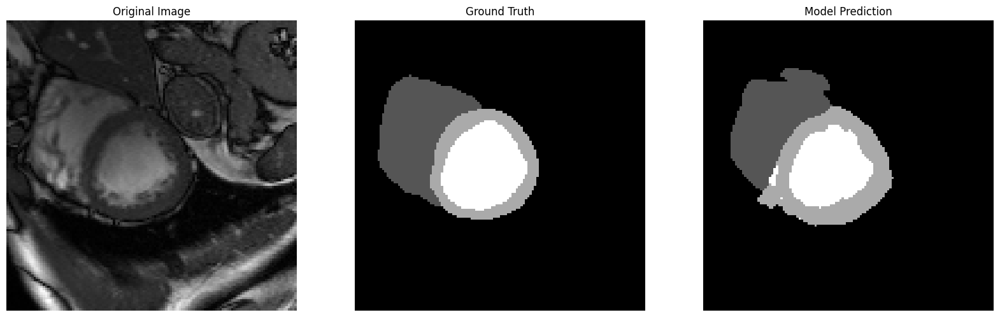

Model 2 Prediction:


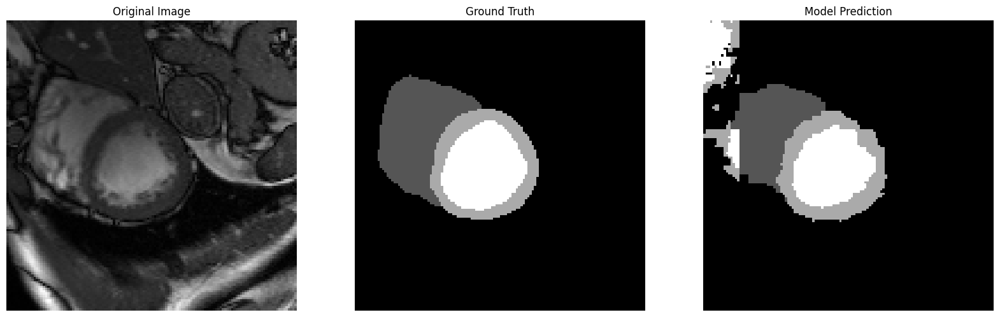

Model 1 Prediction:


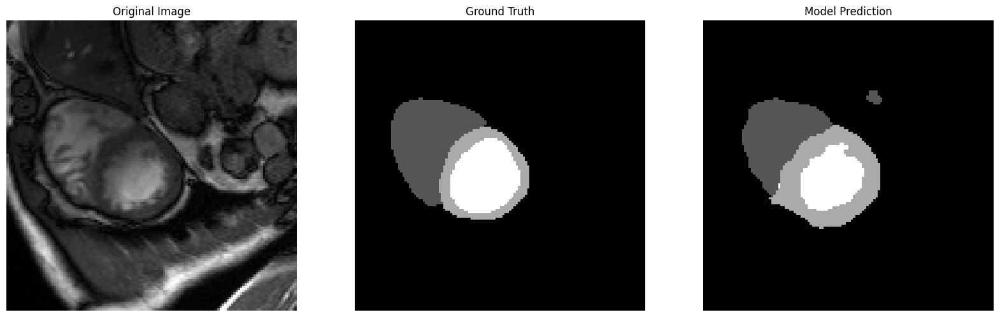

Model 2 Prediction:


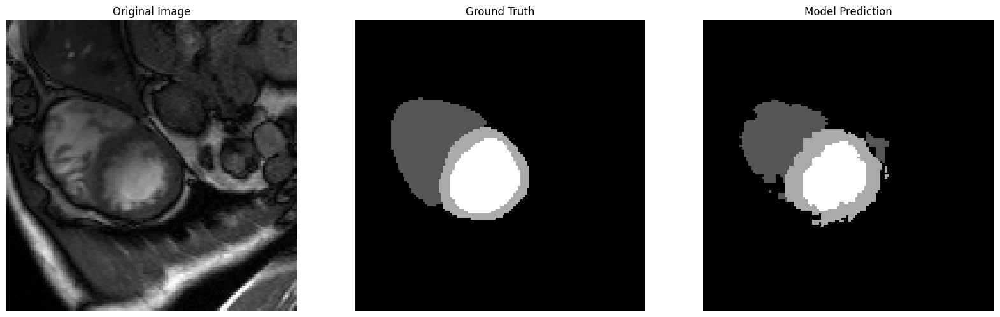

Model 1 Prediction:


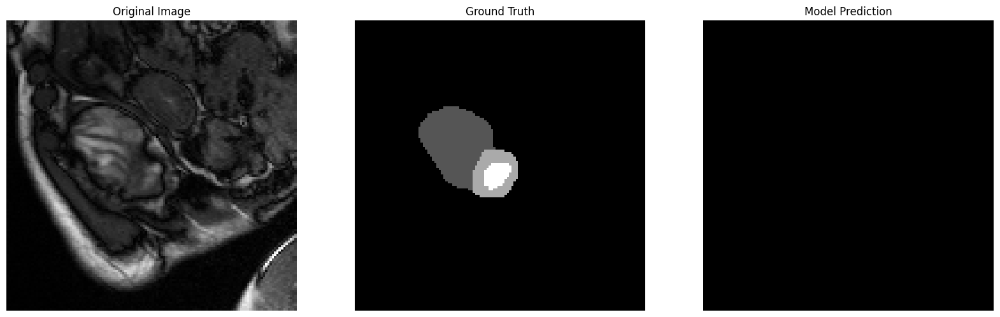

Model 2 Prediction:


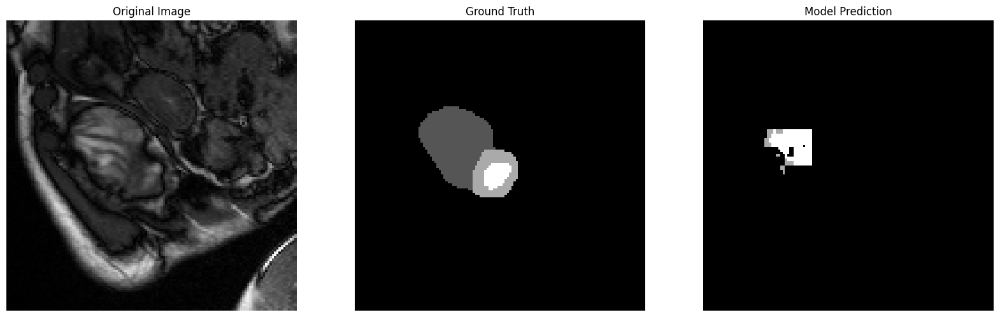

Model 1 Prediction:


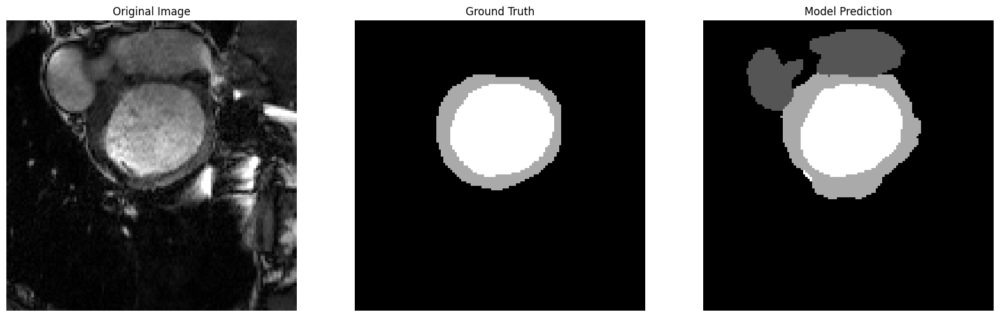

Model 2 Prediction:


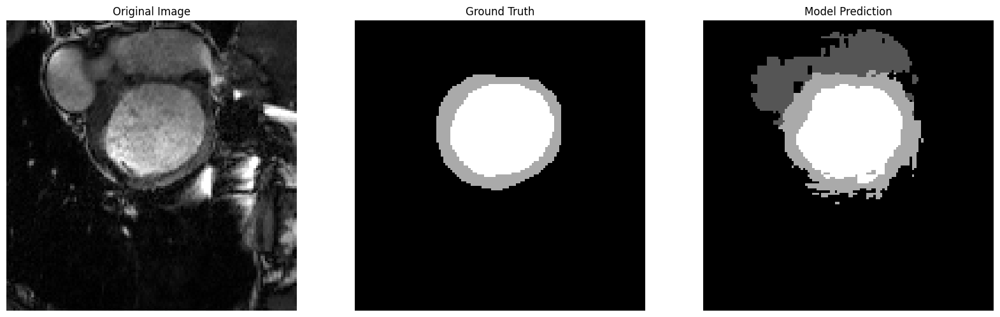

Model 1 Prediction:


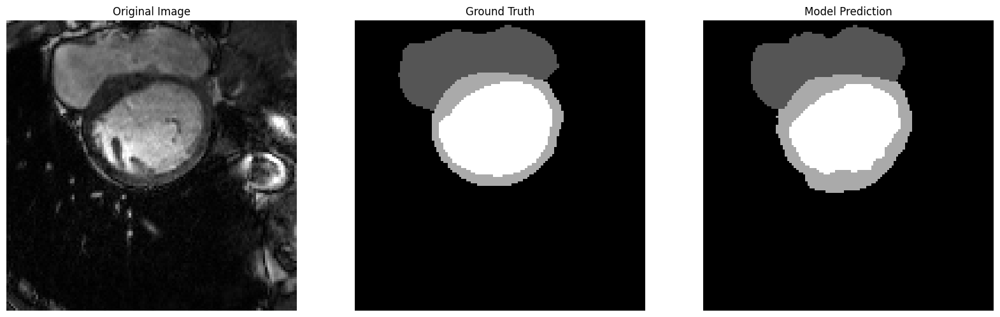

Model 2 Prediction:


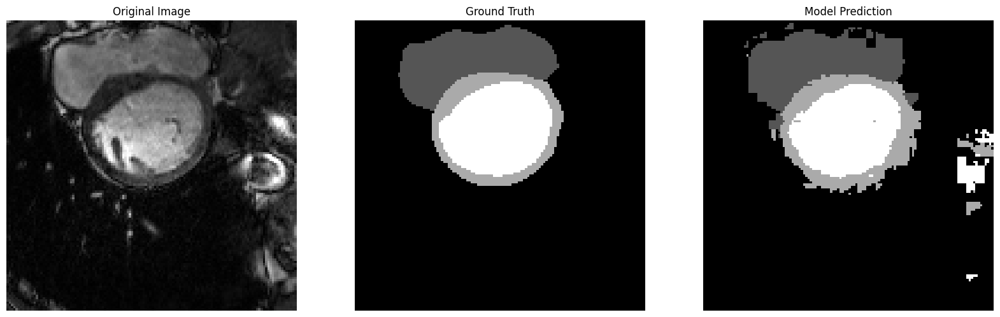

Model 1 Prediction:


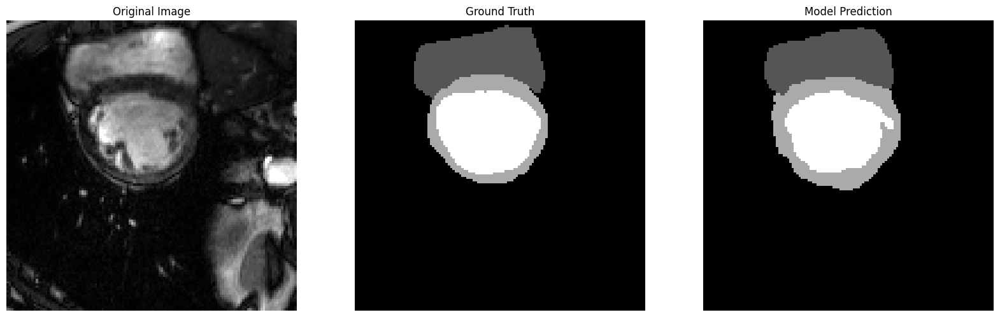

Model 2 Prediction:


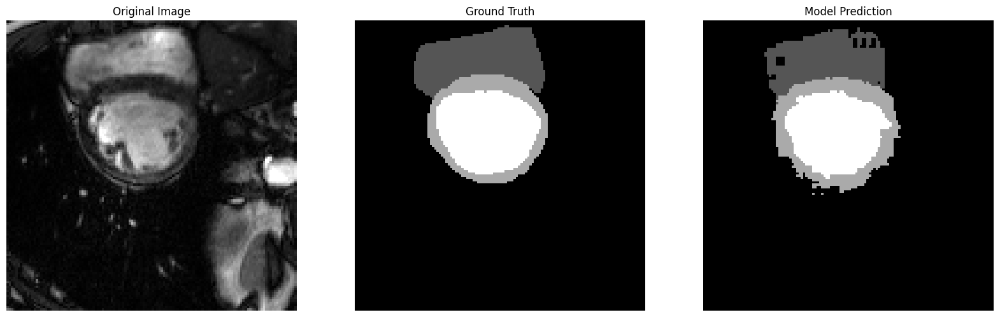

Model 1 Prediction:


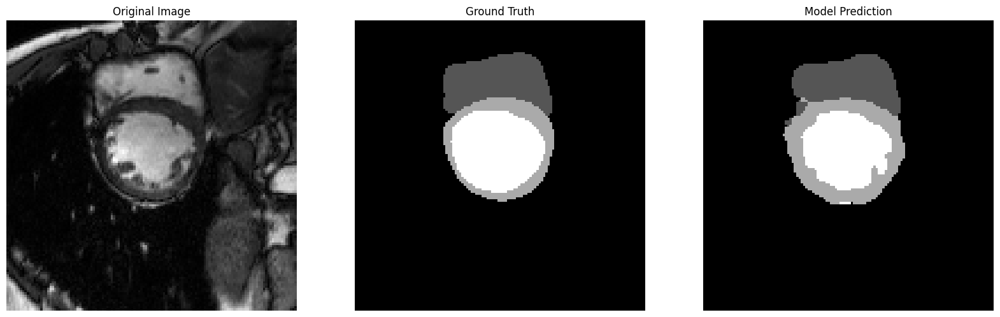

Model 2 Prediction:


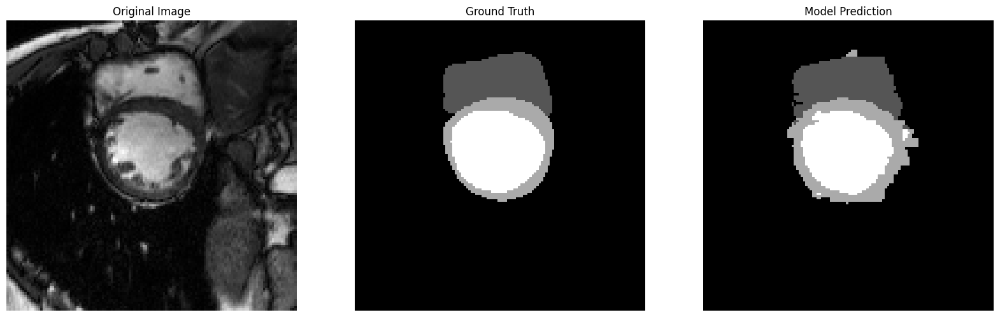

Model 1 Prediction:


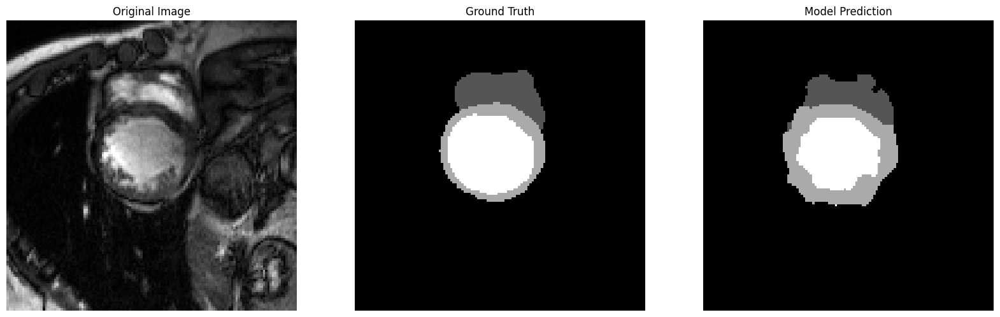

Model 2 Prediction:


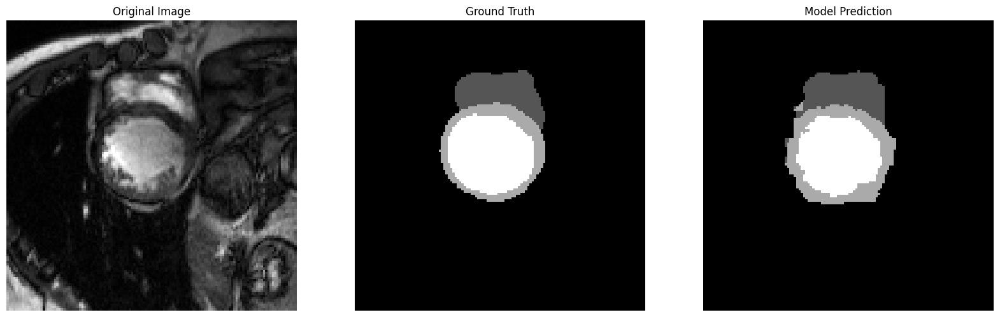

Model 1 Prediction:


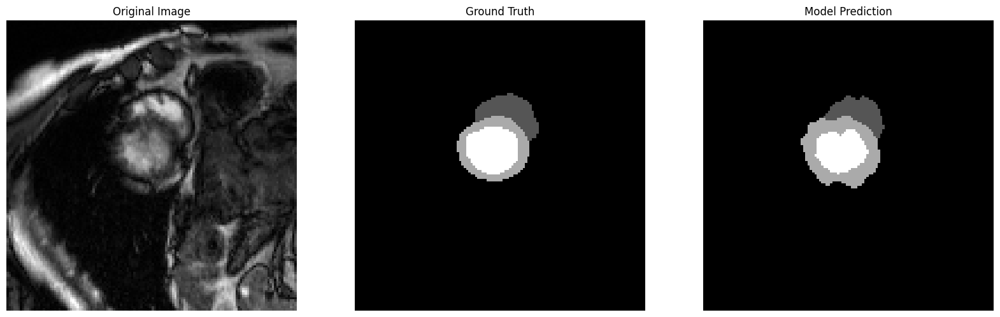

Model 2 Prediction:


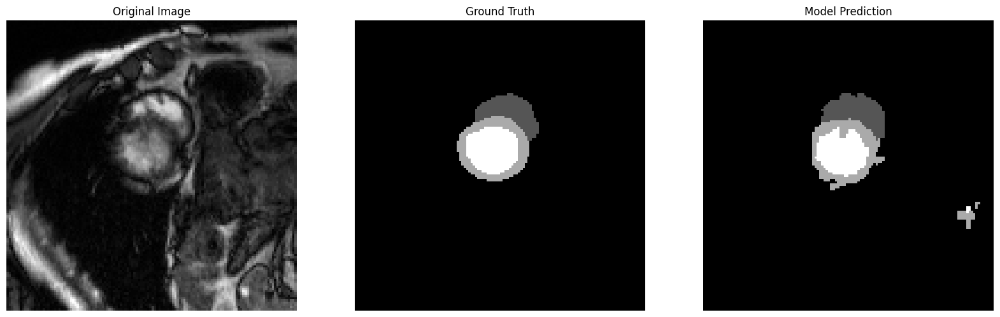

Model 1 Prediction:


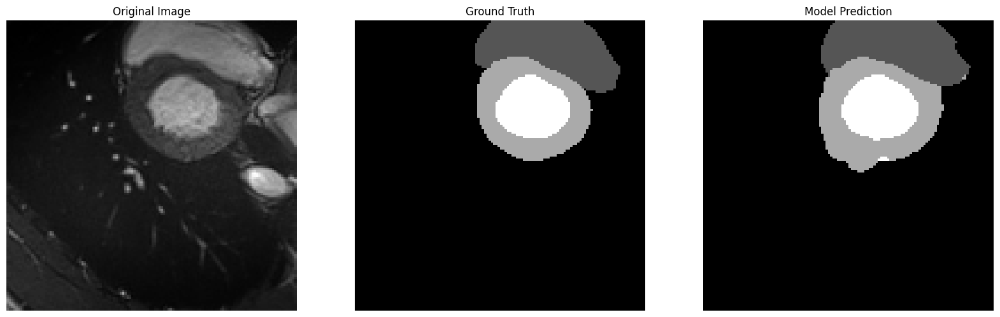

Model 2 Prediction:


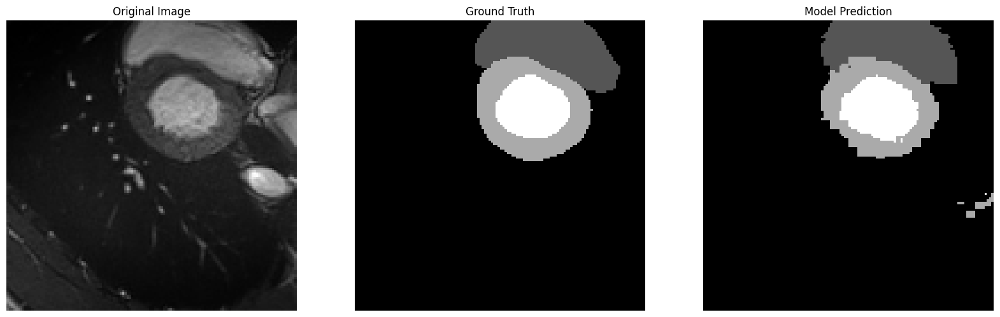

Model 1 Prediction:


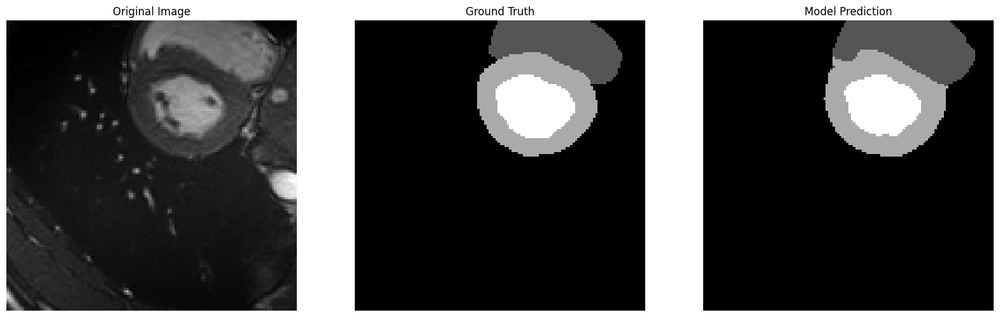

Model 2 Prediction:


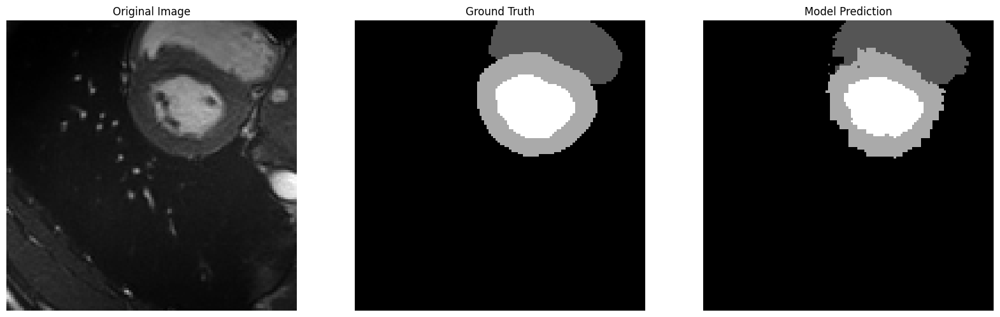

Model 1 Prediction:


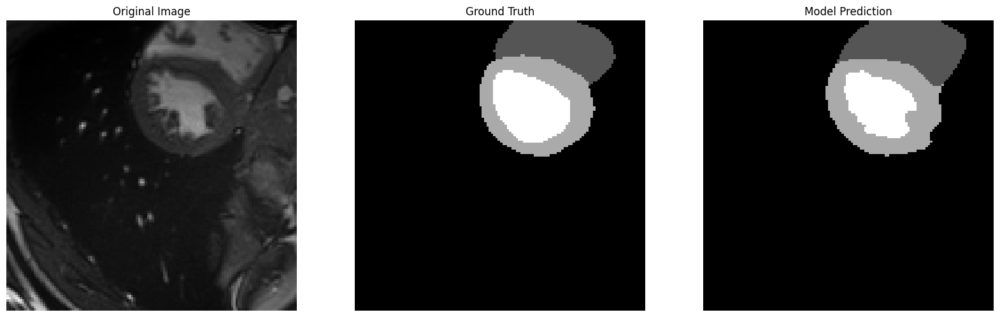

Model 2 Prediction:


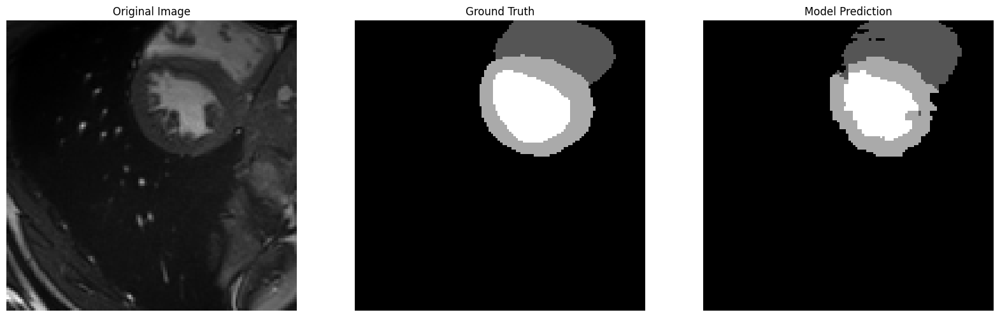

Model 1 Prediction:


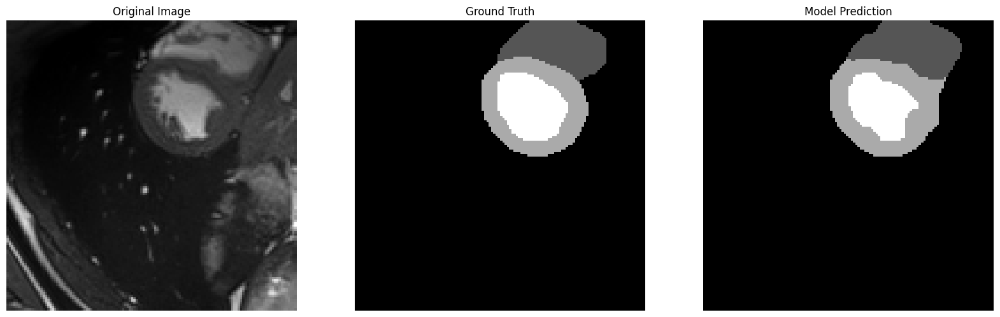

Model 2 Prediction:


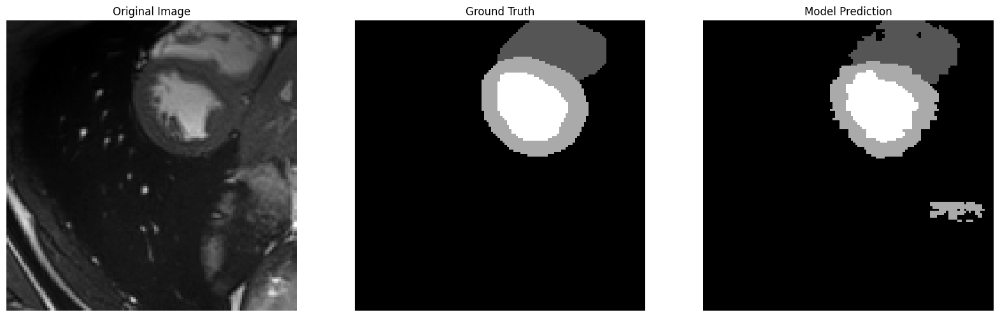

Model 1 Prediction:


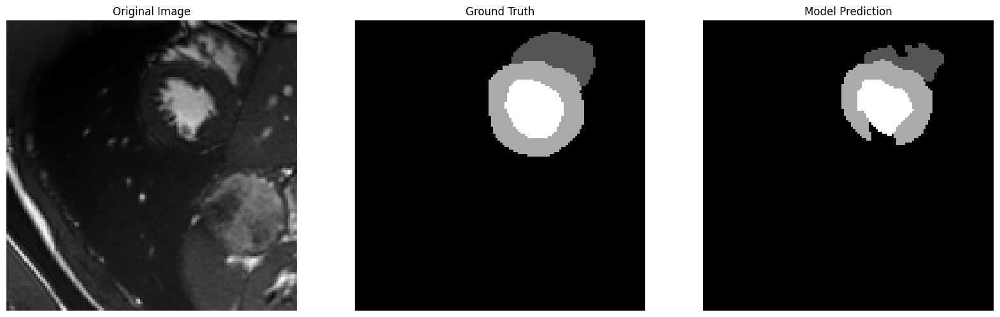

Model 2 Prediction:


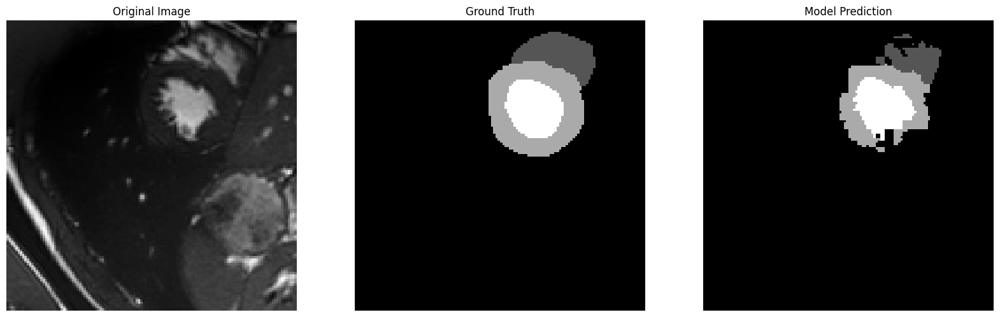

Model 1 Prediction:


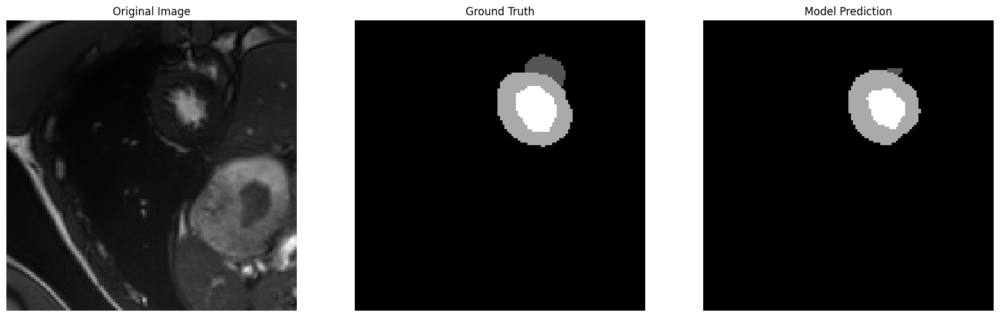

Model 2 Prediction:


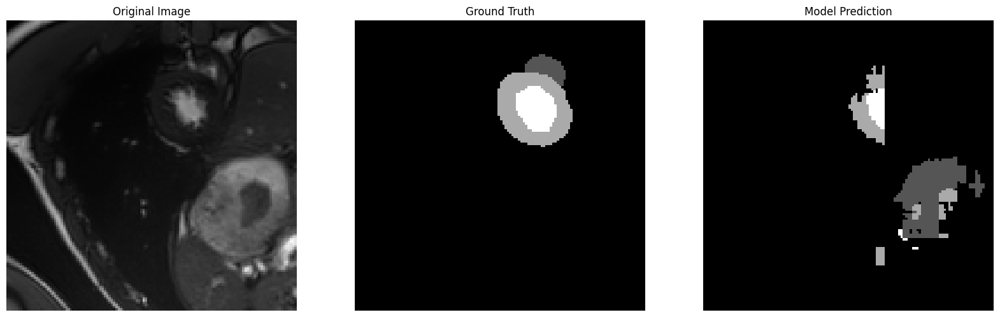

Model 1 Prediction:


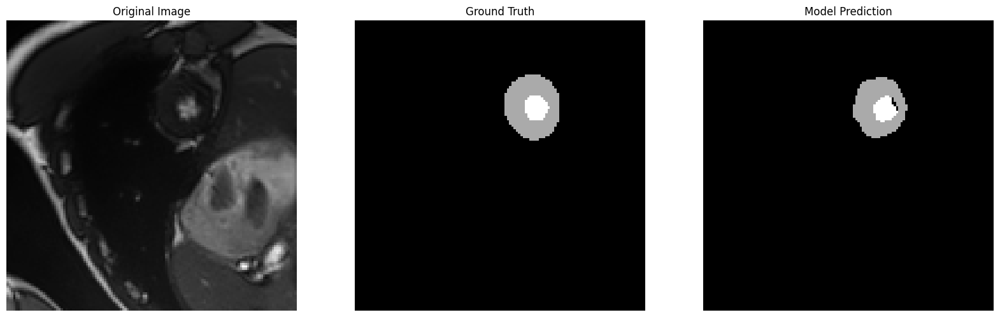

Model 2 Prediction:


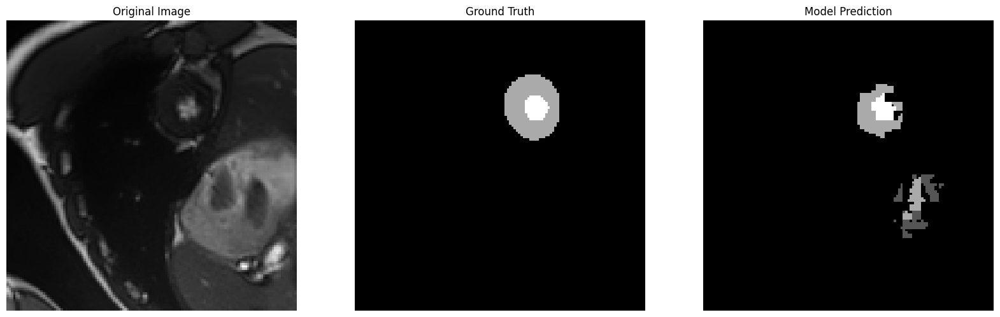

Model 1 Prediction:


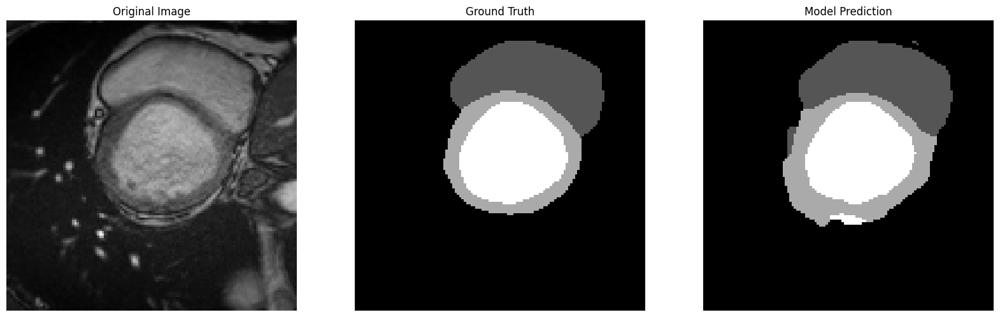

Model 2 Prediction:


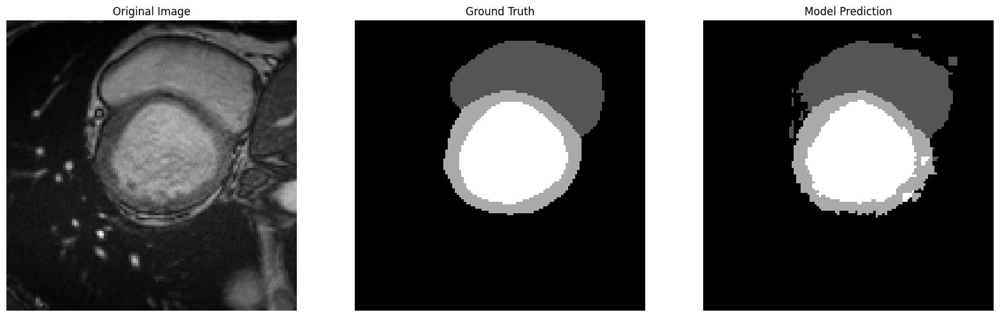

Model 1 Prediction:


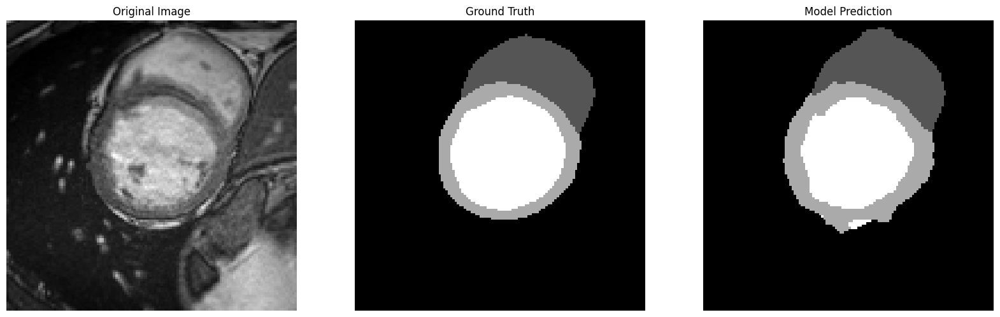

Model 2 Prediction:


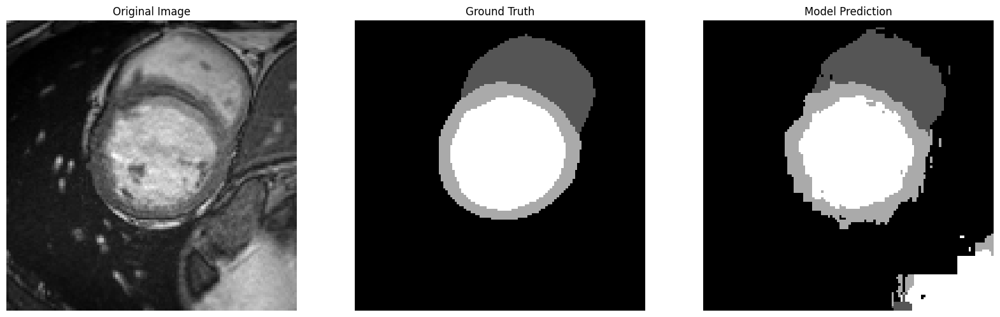

Model 1 Prediction:


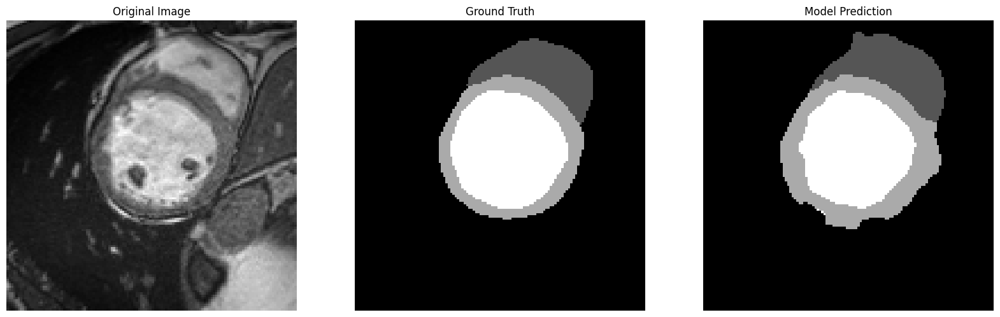

Model 2 Prediction:


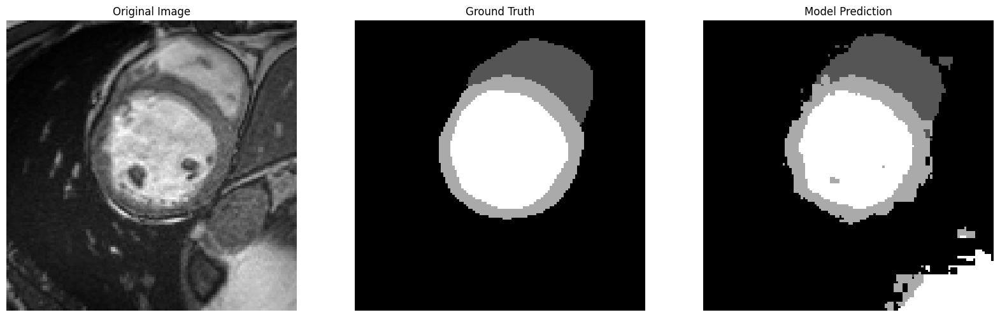

Model 1 Prediction:


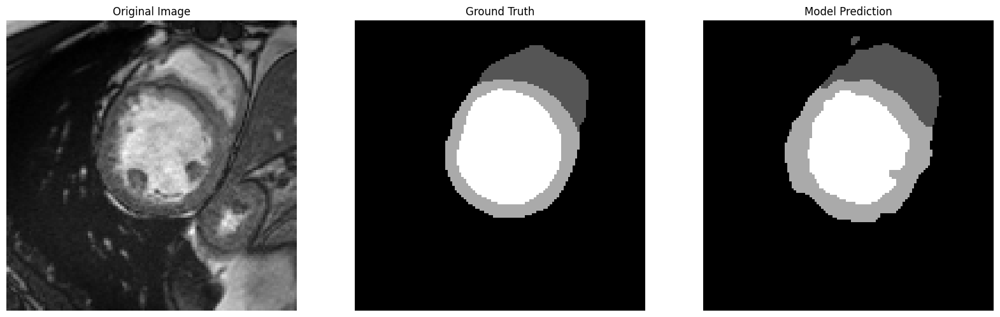

Model 2 Prediction:


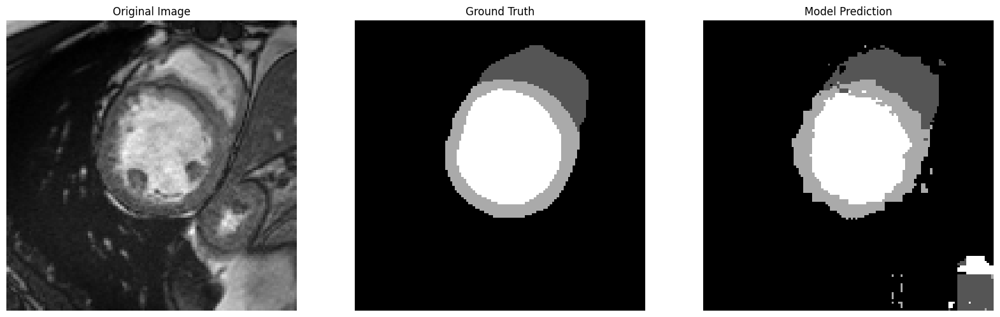

Model 1 Prediction:


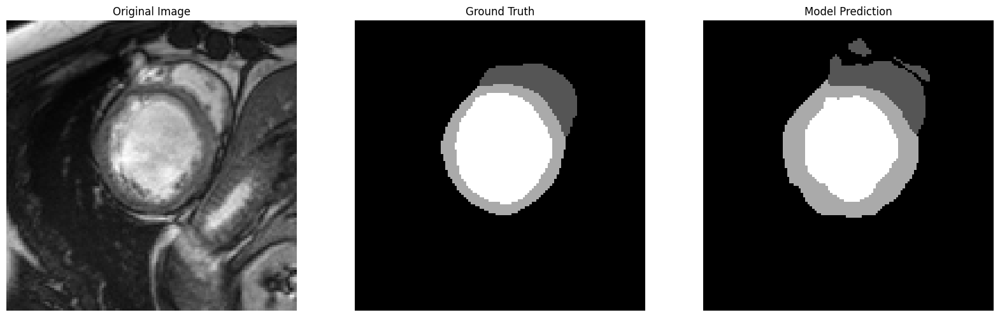

Model 2 Prediction:


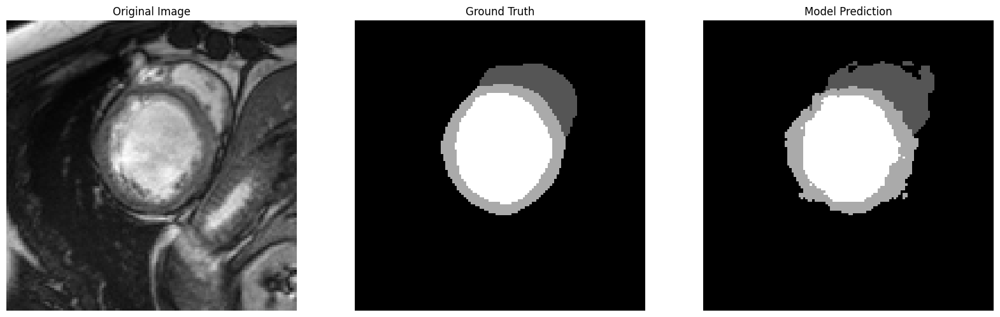

Model 1 Prediction:


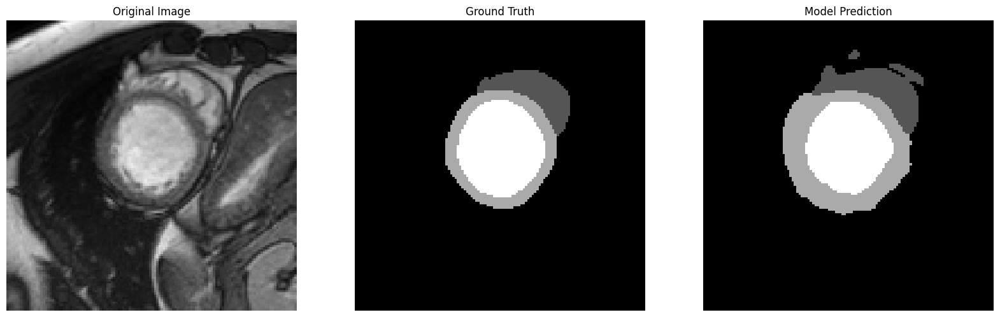

Model 2 Prediction:


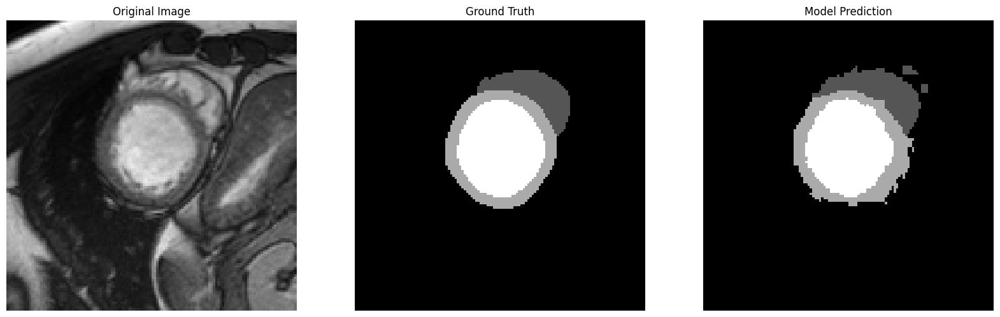

Model 1 Prediction:


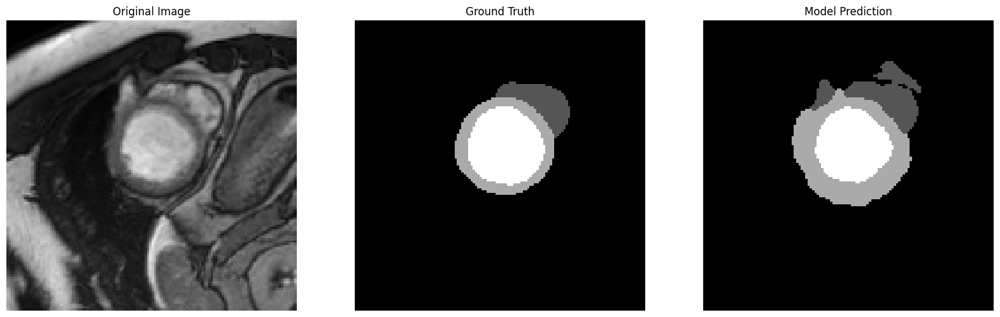

Model 2 Prediction:


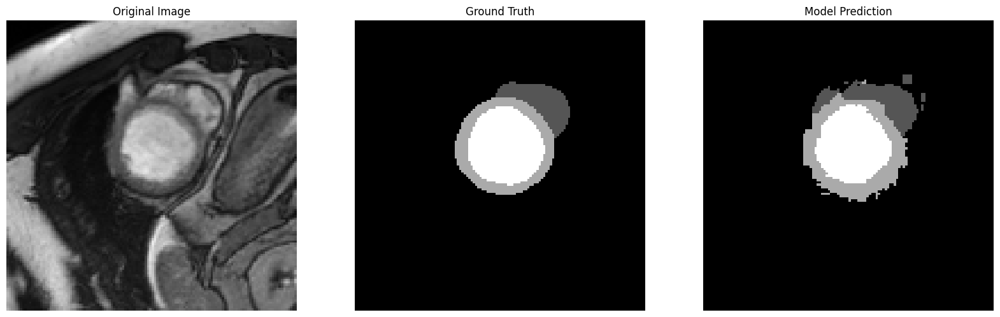

Model 1 Prediction:


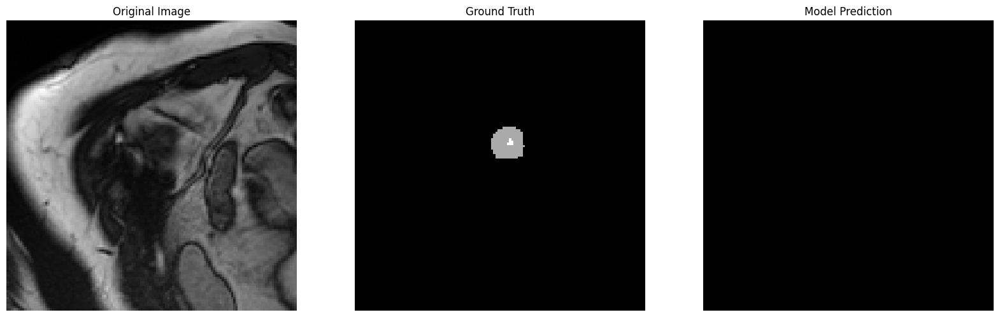

Model 2 Prediction:


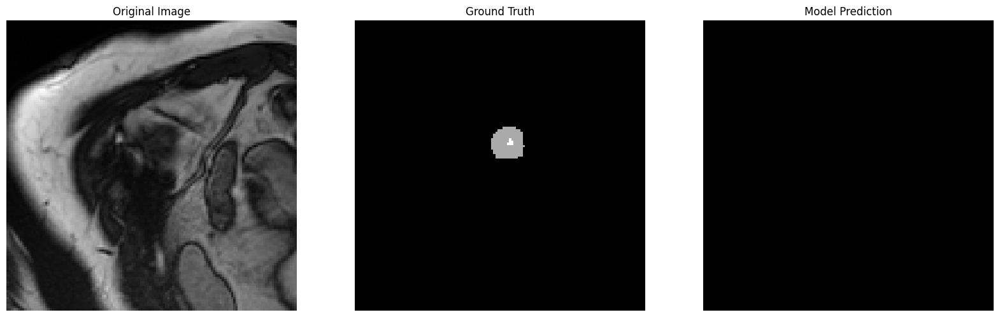

Model 1 Prediction:


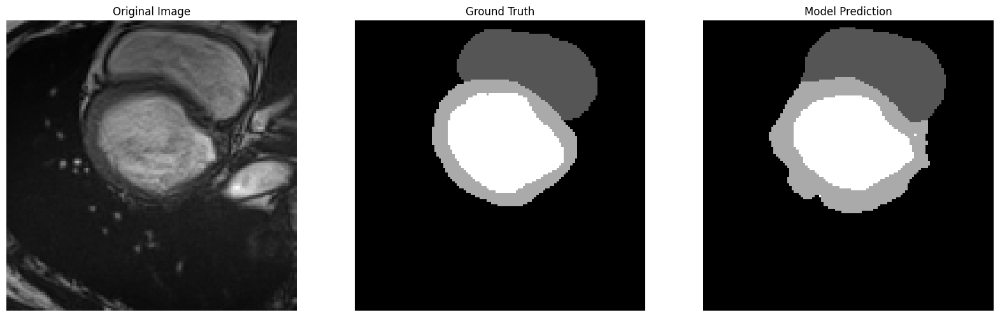

Model 2 Prediction:


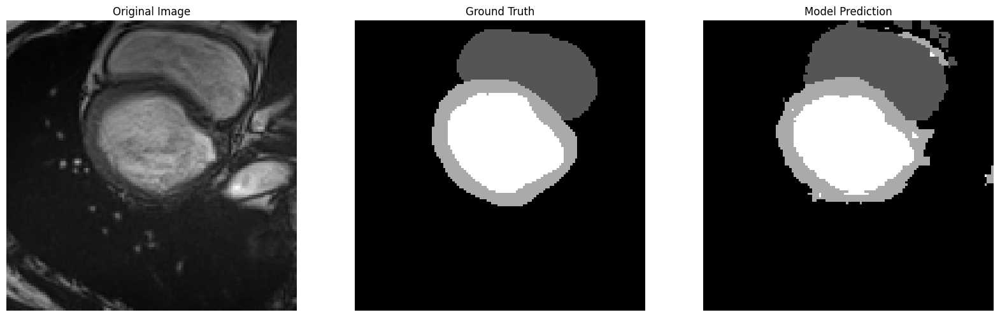

Model 1 Prediction:


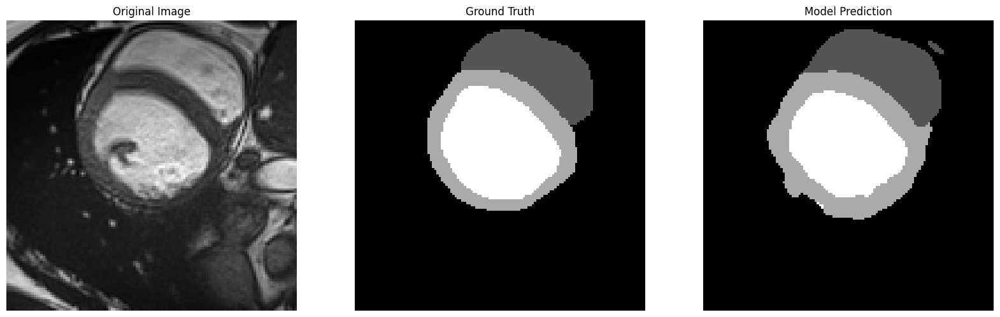

Model 2 Prediction:


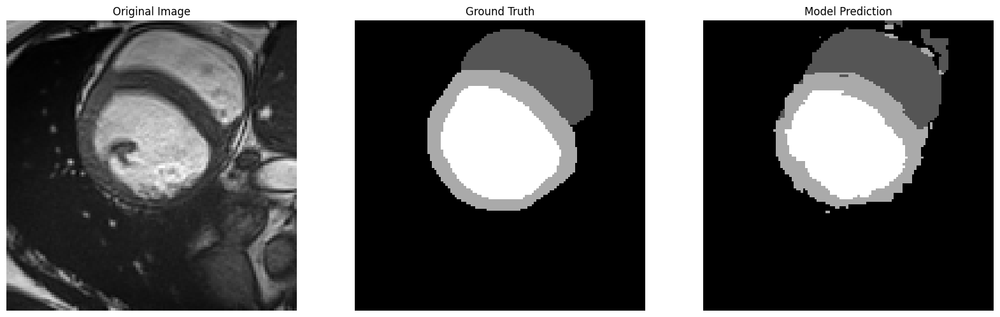

Model 1 Prediction:


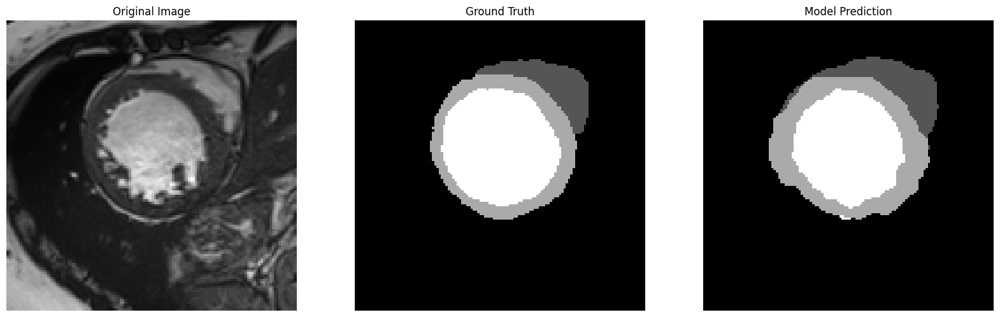

Model 2 Prediction:


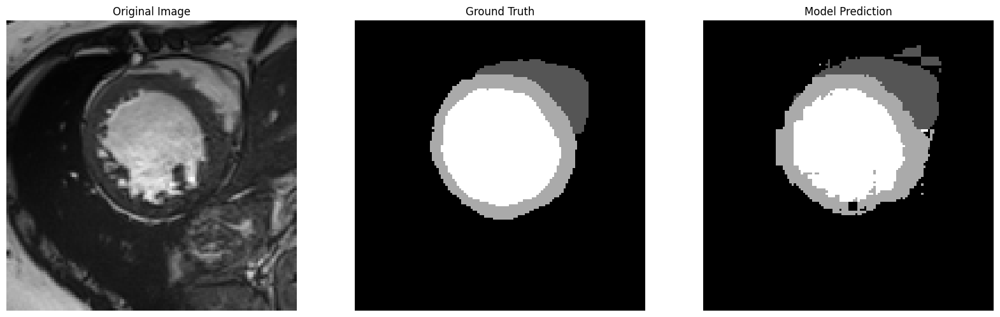

Model 1 Prediction:


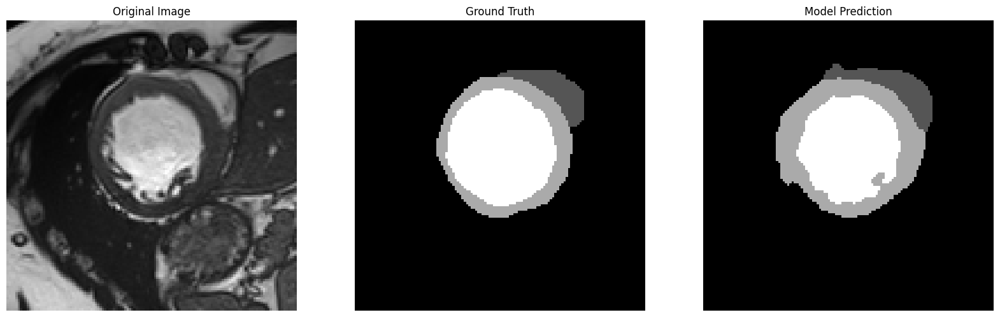

Model 2 Prediction:


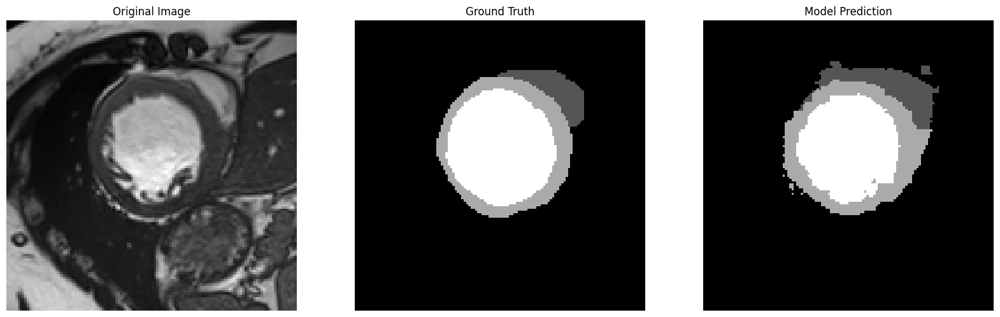

Model 1 Prediction:


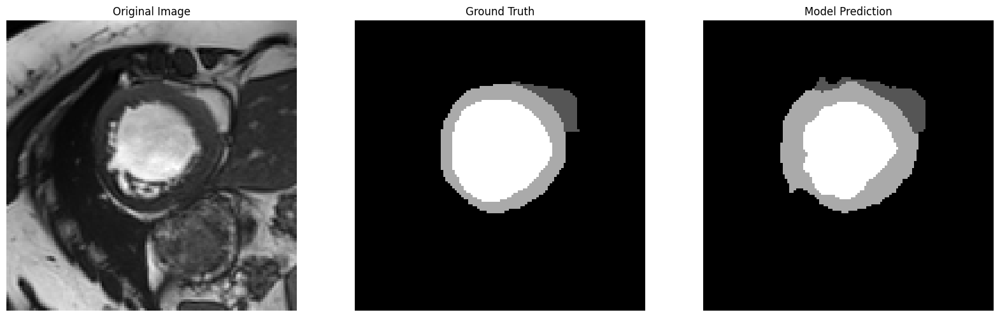

Model 2 Prediction:


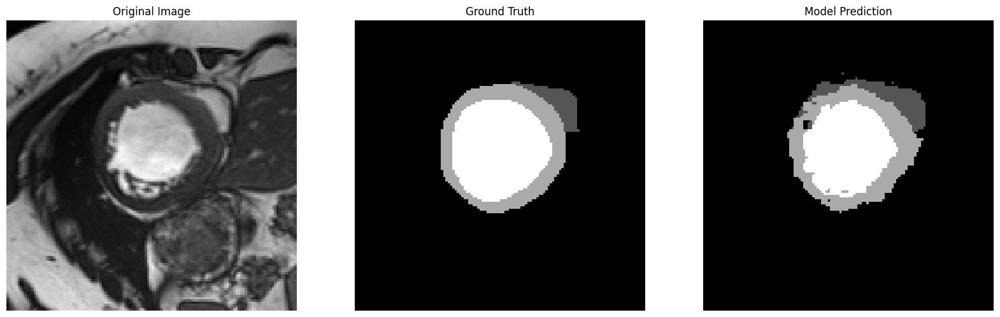

Model 1 Prediction:


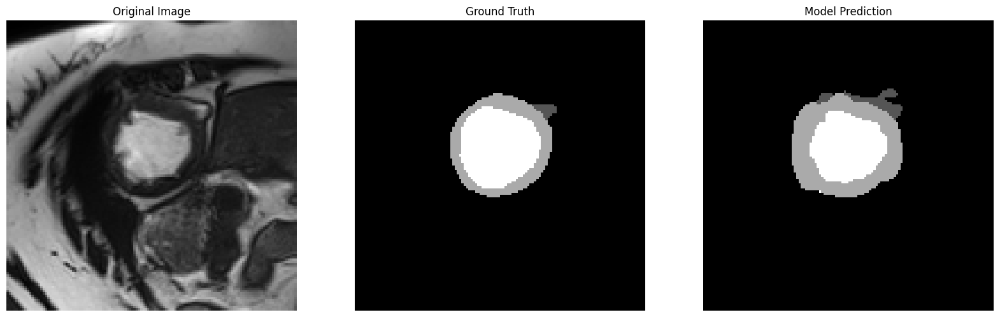

Model 2 Prediction:


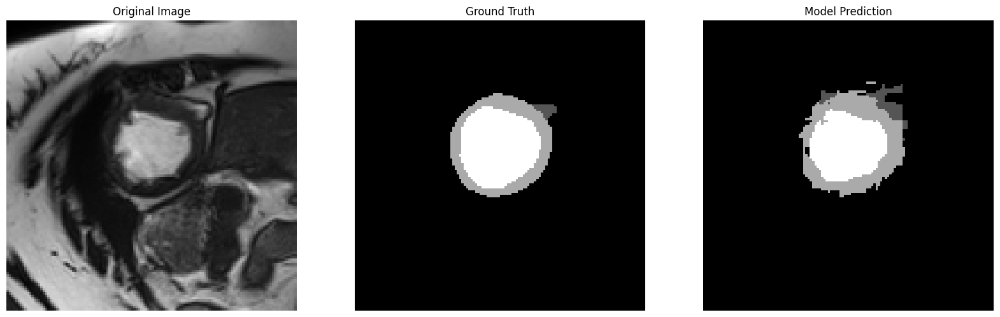

Model 1 Prediction:


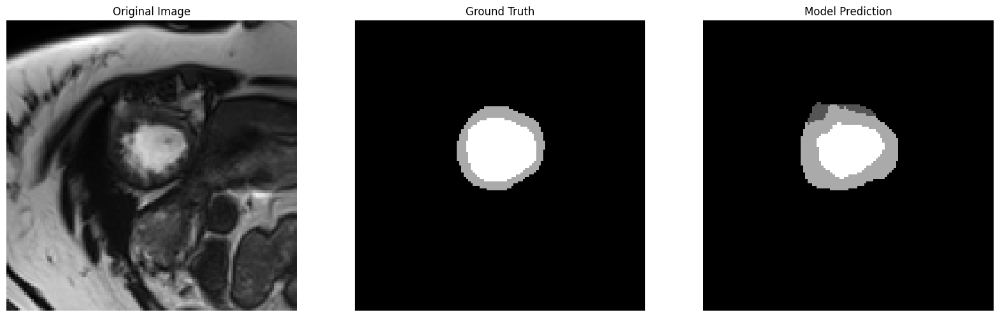

Model 2 Prediction:


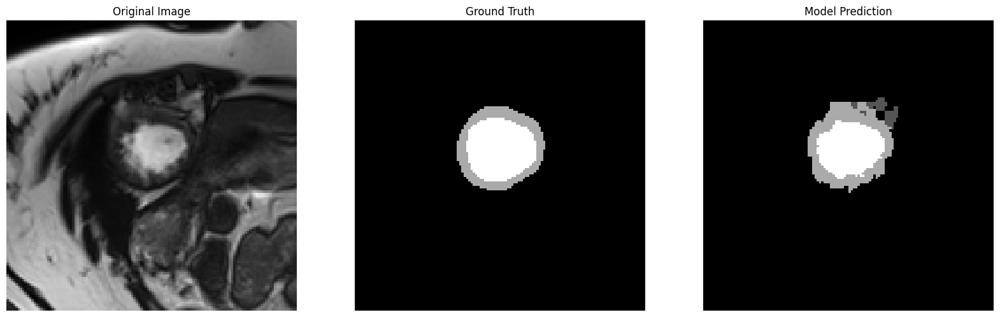

Model 1 Prediction:


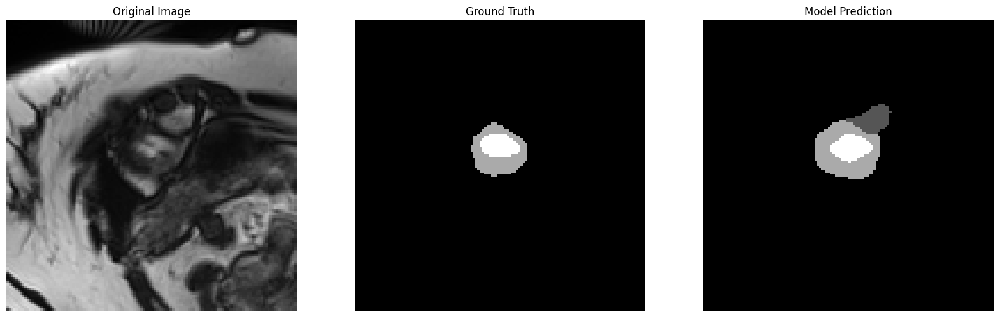

Model 2 Prediction:


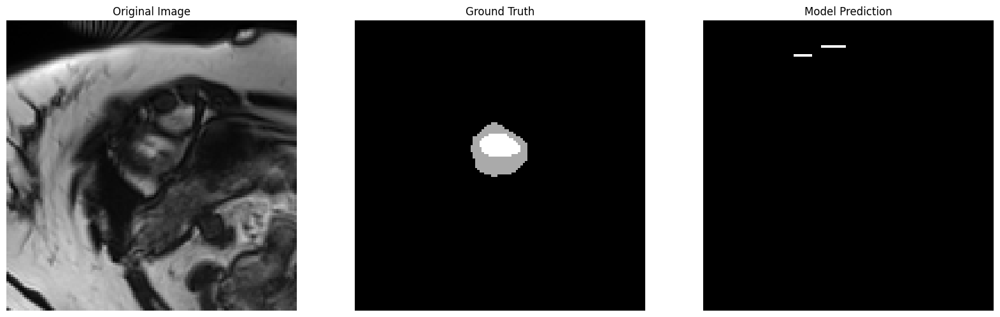

In [ ]:
def visualize_predictions(image, mask, prediction):
    fig, axs = plt.subplots(1, 3, figsize=(20, 20))

    axs[0].imshow(image.cpu().squeeze().numpy(), cmap='gray')
    axs[0].set_title('Original Image')

    axs[1].imshow(mask.cpu().squeeze().numpy(), cmap='gray')
    axs[1].set_title('Ground Truth')

    axs[2].imshow(prediction.cpu().squeeze().numpy(), cmap='gray')
    axs[2].set_title('Model Prediction')

    for ax in axs:
        ax.axis('off')

    plt.show()

# Load the best model
model1.load_state_dict(torch.load(SAVE_PATH1))
model2.load_state_dict(torch.load(SAVE_PATH2))

model1.eval()
model2.eval()

with torch.no_grad():
    for images, masks in val_dataloader:
        images, masks = images.to(device), masks.to(device)

        outputs1, _ = model1(images)
        prediction1 = torch.argmax(outputs1, dim=1)

        outputs2, _ = model2(images)
        prediction2 = torch.argmax(outputs2, dim=1)

        # Just visualize for the first few samples in the batch
        for i in range(min(3, images.size(0))):
            print("Model 1 Prediction:")
            visualize_predictions(images[i], masks[i], prediction1[i])

            print("Model 2 Prediction:")
            visualize_predictions(images[i], masks[i], prediction2[i])